# **Project 4: MonReader**

*Prepared by: Japhet Hernández-Vaquero*

*For: Apziva*

## **Background**

Our company develops innovative Artificial Intelligence and Computer Vision solutions that revolutionize industries. Machines that can see: We pack our solutions in small yet intelligent devices that can be easily integrated to your existing data flow. Computer vision for everyone: Our devices can recognize faces, estimate age and gender, classify clothing types and colors, identify everyday objects and detect motion. Technical consultancy: We help you identify use cases of artificial intelligence and computer vision in your industry. Artificial intelligence is the technology of today, not the future.

MonReader is a new mobile document digitization experience for the blind, for researchers and for everyone else in need for fully automatic, highly fast and high-quality document scanning in bulk. It is composed of a mobile app and all the user needs to do is flip pages and everything is handled by MonReader: it detects page flips from low-resolution camera preview and takes a high-resolution picture of the document, recognizing its corners and crops it accordingly, and it dewarps the cropped document to obtain a bird's eye view, sharpens the contrast between the text and the background and finally recognizes the text with formatting kept intact, being further corrected by MonReader's ML powered redactor.

### **Data Description**

We collected page flipping video from smart phones and labelled them as flipping and not flipping.

We clipped the videos as short videos and labelled them as flipping or not flipping. The extracted frames are then saved to disk in a sequential order with the following naming structure: VideoID_FrameNumber

### **Goals**

Predict if the page is being flipped using a single image.

### **Success Metrics**

Evaluate model performance based on F1 score, the higher the better.

### **Current Challenges**

Predict if a given sequence of images contains an action of flipping.

## **Preparing image files**

### **Mounting Google Drive to Colab**

Let's mount your Google Drive to the Colab environment, allowing you to access files stored in your Drive directly from Colab. The drive module from Google Colab provides the functionality to establish this connection. Once mounted, your Drive content will be accessible in the /content/drive/ directory.

By running this code, you'll be prompted to authenticate your Google account. Once authenticated, all files and folders in your Google Drive become accessible in the Colab environment.

In [ ]:
from google.colab import drive  # Import the drive module from Google Colab to mount Google Drive.
drive.mount('/content/drive')   # Mount Google Drive to the Colab environment at the specified path '/content/drive'.

Mounted at /content/drive


### **Accessing Files in Google Drive**

After mounting Google Drive, the next step is to locate the folder containing the desired files. The **`os`** module is used here to interact with the operating system, allowing us to define the folder path and list its contents.

* **`path`**: This variable specifies the directory where your files are located within Google Drive.
* **`os.listdir(path)`**: Lists all files and subdirectories in the specified path, allowing you to confirm the presence of the file you need (e.g., a ZIP file).

In [ ]:
import os  # Import the os module to interact with the operating system and manage file paths.
path = '/content/drive/MyDrive/Apziva/Project 4'  # Define the path to the target folder in Google Drive.
print(os.listdir(path))  # List and display all files and directories in the specified folder.

['images.zip', 'Book scan for OCR', 'Girl_with_a_pearl_earring_fragment', 'Processed_files', 'index.html', 'requirements.txt', 'project4_39.py']


### **Preparing to Extract a ZIP File**

Now that we have confirmed the ZIP file is in the target folder, this block of code constructs the full path to the file. The **`os.path.join`** function ensures compatibility by combining folder paths in a way that works across different operating systems.

* **`zip_file:`** Combines the folder path (**`path`**) and the name of the ZIP file (**`images.zip`**) to create the full file path.
* **`full_path:`** Ensures the ZIP file's full path is defined correctly.

In [ ]:
# ZIP file we want to unzip
zip_file = os.path.join(path, 'images.zip')  # Combine the folder path and the ZIP file name to create the full path.
full_path = os.path.join(path, zip_file)  # Ensure the full path to the ZIP file is correctly defined.

### **Unzipping the File**

The **`unzip`** command extracts the contents of the ZIP file into a specified directory. The **`-q`** flag ensures that the extraction process runs silently without printing every file being extracted.

* **`full_path:`** Refers to the ZIP file's full path, as constructed earlier.
* **`/content/Project4Extracted/:`** The directory where the contents of the ZIP file will be extracted.

After running this command, all files inside the ZIP archive will be available in the **`/content/Project4Extracted/`** folder, ready for further processing or analysis.

In [ ]:
!unzip -q "{full_path}" -d "/content/Project4Extracted/"  # Extract the ZIP file contents silently (-q) into the specified directory.

### **Importing libraries**

In this code block, we'll import all the necessary libraries for working with images, data manipulation, machine learning, and visualization.
Pillow and OpenCV are primarily used for image manipulation, while TensorFlow handles model training and dataset processing.
tqdm is used to track the progress of loops, making long-running tasks more transparent.

In [ ]:
# Install required Python libraries:
# - pillow: A library for image processing.
# - opencv-python: A library for computer vision tasks, including image and video analysis.
# The '-q' flag suppresses unnecessary installation output for a cleaner notebook interface.
!pip install -q pillow opencv-python

In [ ]:
# Install or upgrade TensorFlow to the latest version:
# - 'tensorflow' is an open-source framework for machine learning and deep learning tasks.
# - '--upgrade' ensures the package is updated to the newest release if an older version is installed.
# - '-q' suppresses unnecessary output for cleaner notebook execution.
!pip install -q --upgrade tensorflow


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 615.3/615.3 MB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 108.4 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-keras 2.17.0 requires tensorflow<2.18,>=2.17, but you have tensorflow 2.18.0 which is incompatible.


In [ ]:
# Install the 'cloud_tpu_client' package, which provides tools to connect to and use Cloud TPUs.
# Cloud TPUs are specialized hardware accelerators designed by Google for efficient machine learning computations.
# The '-q' flag runs the installation in quiet mode, suppressing unnecessary output for a cleaner display.
!pip install -q cloud_tpu_client

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.7/57.7 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 120.4/120.4 kB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 44.0 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
pydrive2 1.21.3 requires google-api-python-client>=1.12.5, but you have google-api-python-client 1.8.0 which is incompatible.
earthengine-api 1.4.3 requires google-api-python-client>=1.12.1, but you have google-api-python-client 1.8.0 which is incompatible.
google-cloud-bigtable 2.27.0 requires google-api-core[grpc]<3.0.0dev,>=2.16.0, but you have google-api-core 1.34.1 which is incompatible.
google-cloud-storage 2.19.0 requires google-api-core<3.0.0dev,>=2.15.0, but you have google-api-core 1.34.1 which is incompatible.
grpcio-status 1.62.3 requires protobuf>=4.21.6, but you have pr

In [ ]:
# pytesseract: Python wrapper for Tesseract, an OCR (Optical Character Recognition) tool.
# It allows extracting text from images loaded in Python.
!pip install pytesseract

# Pillow: A library for opening, editing, and manipulating images in Python.
# Required for loading and preprocessing images before using OCR.
!pip install Pillow

# gtts: Google Text-to-Speech, a library for converting text to speech.
# It uses Google's service to generate MP3 audio files from text.
!pip install gtts

# pyttsx3: A text-to-speech (TTS) library that works offline.
# It does not require an internet connection and uses local TTS engines, such as SAPI5 on Windows.
!pip install pyttsx3

In [ ]:
# Update the package lists for the operating system.
# This ensures you have access to the latest versions of packages and their dependencies.
!apt-get update

# Install the 'tesseract-ocr' package, a popular OCR (Optical Character Recognition) tool.
# The '-y' flag automatically confirms the installation, bypassing prompts for user input.
# Tesseract is used to extract text from images or scanned documents.
!apt-get install -y tesseract-ocr


Get:1 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:2 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:3 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:4 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,626 B]
Get:5 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Hit:6 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:7 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:8 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:10 http://security.ubuntu.com/ubuntu jammy-security/main amd64 Packages [2,517 kB]
Get:11 http://security.ubuntu.com/ubuntu jammy-security/universe amd64 Packages [1,226 kB]
Get:12 http://security.ubuntu.com/ubuntu jammy-security/restricted amd64 Packages [3,448 kB]
Get:13 http://archive.ubuntu.com/ubuntu j

In [ ]:
!pip install pydub # To join audio files

In [ ]:
!apt-get install -y ffmpeg # To work with audio in pydub

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 50 not upgraded.


In [ ]:
!pip install -q "paddleocr>=2.0.1" # to use version 2.0.1+

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 7.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 544.7/544.7 kB 31.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 161.9/161.9 kB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 294.9/294.9 kB 25.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 912.2/912.2 kB 51.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 244.3/244.3 kB 21.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 87.5 MB/s eta 0:00:00


In [ ]:
# Install the 'paddlepaddle' library, an open-source deep learning framework developed by Baidu.
# It is used for building and training machine learning models, similar to TensorFlow or PyTorch.
# The '-q' flag runs the installation in quiet mode, suppressing unnecessary output for a cleaner display.
!pip install -q paddlepaddle

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 MB 19.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.5/65.5 kB 5.6 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-keras 2.17.0 requires tensorflow<2.18,>=2.17, but you have tensorflow 2.18.0 which is incompatible.


In [ ]:
# Install the 'happytransformer' library, a Python package built on Hugging Face's Transformers library.
# It simplifies the implementation of natural language processing (NLP) tasks, such as text generation, sentiment analysis, and translation.
# The '-q' flag runs the installation in quiet mode, suppressing detailed output for a cleaner display.
!pip install -q happytransformer

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 20.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 527.3/527.3 kB 38.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 11.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 177.6/177.6 kB 17.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 18.3 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2024.10.0 requires fsspec==2024.10.0, but you have fsspec 2024.6.1 which is incompatible.


In [ ]:
# Install the 'wtpsplit' library, which is used for splitting long text into smaller, more manageable chunks.
# This is especially useful in natural language processing (NLP) tasks where text needs to be divided into sentences or paragraphs for analysis.
# The '-q' flag suppresses unnecessary output, keeping the installation process clean and concise.
!pip install -q wtpsplit

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.4/44.4 kB 4.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 123.5/123.5 kB 9.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 436.6/436.6 kB 27.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 119.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 283.7/283.7 kB 22.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.9/9.9 MB 132.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 147.0/147.0 kB 15.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 85.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 8.8 MB/s eta 0:00:00


In [ ]:
## ******************** EDA *******************************
# Import libraries for Exploratory Data Analysis (EDA)
import os  # For file and directory management
from collections import Counter  # For counting occurrences
from PIL import Image, UnidentifiedImageError  # For image processing and handling errors
import random  # For random sampling
import cv2  # OpenCV for image and video processing
from torchvision import transforms  # PyTorch transformations for image data
from skimage.metrics import structural_similarity as ssim  # For comparing image similarity
import numpy as np  # For numerical operations
import pandas as pd  # For data manipulation and analysis
import matplotlib.pyplot as plt  # For data visualization
## ******************** EDA *******************************

## ************** PRE-PROCESSING **************************
# Import libraries for data preprocessing and batching
import torch  # PyTorch library for tensor computations
from torch.utils.data import DataLoader, Dataset  # For creating datasets and data loaders
## ************** PRE-PROCESSING **************************

## ************* VALIDATION DATASET ***********************
# Import library for splitting datasets into training and validation sets
from sklearn.model_selection import train_test_split
## ************* VALIDATION DATASET ***********************

## ************* NEURAL NETWORK ***************************
# Import PyTorch libraries for neural network creation and training
import torch
import torch.nn as nn  # Neural network module
import torch.optim as optim  # Optimization algorithms
from torchvision import datasets, transforms  # Dataset handling and transformations
from torch.utils.data import DataLoader  # Data loading utilities
import gc  # Garbage collection to free up memory
## ************* NEURAL NETWORK ***************************

## ************* RESNET ***********************************
# Import ResNet model and utilities for dataset sampling
import torchvision.models as models  # Pre-trained models from torchvision
from torch.utils.data.sampler import SubsetRandomSampler  # For creating random subsets of data

# Device configuration for running on GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
## ************* RESNET ***********************************

## ************* EFFICIENTNET *****************************
# Import EfficientNetB0 from TensorFlow and PyTorch
from tensorflow.keras.applications import EfficientNetB0  # Pre-trained EfficientNet from TensorFlow
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D  # Layers for customizing the model
from tensorflow.keras.models import Model  # Model API for TensorFlow
from torchvision.models import efficientnet_b0  # Pre-trained EfficientNet from PyTorch
import torch.nn as nn  # Neural network layers
import torch.optim as optim  # Optimizers for training
## ************* EFFICIENTNET *****************************

## ************* MOBILENET ********************************
# Import MobileNetV2 model from PyTorch
from torchvision.models import mobilenet_v2  # Pre-trained MobileNetV2 model
## ************* MOBILENET ********************************

# TensorFlow and Keras imports for model building and data processing
import tensorflow as tf  # TensorFlow framework
from tensorflow.keras.preprocessing.image import ImageDataGenerator  # For augmenting image data
from tensorflow.keras.utils import image_dataset_from_directory  # For creating datasets from directories
from tensorflow.data import DatasetSpec  # Dataset specifications
import random  # For random operations
import numpy as np  # For numerical operations
from tqdm import tqdm  # For progress tracking
from tensorflow.data.experimental import copy_to_device, prefetch_to_device  # Performance optimizations
from tensorflow.keras.mixed_precision import set_global_policy, Policy  # Mixed precision training

# Keras Sequential model and layers
from tensorflow.keras.models import Sequential  # Sequential model API
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, BatchNormalization  # Common layers
from tensorflow.keras.optimizers import Adam  # Adam optimizer
## ************* MOBILENET ********************************

## ************** OCR ***********************
# Optical Character Recognition (OCR) imports
from PIL import Image, ImageFilter  # Image manipulation and filtering
import pytesseract  # Tesseract OCR for text extraction
import cv2  # OpenCV for image preprocessing
from scipy.ndimage import rotate  # For rotating images
## ************** OCR ***********************

## ************** GOOGLE TEXT TO SPEECH *******************
# Import Google Text-to-Speech (gTTS) library for converting text to speech
from gtts import gTTS
## ************** GOOGLE TEXT TO SPEECH *******************

## ************** PYTTSX3 *********************************
# Import pyttsx3 library for text-to-speech conversion
import pyttsx3
## ************** PYTTSX3 *********************************


In [ ]:
# Set the device for tensor operations, choosing 'cuda' (GPU) if available, otherwise 'cpu' (CPU).
# The 'torch.cuda.is_available()' function checks if CUDA (GPU support) is available on the system.
# If CUDA is available, 'cuda' is used to leverage the GPU for faster computations.
# Otherwise, 'cpu' is used, which means computations will run on the CPU.
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
# Print the list of available GPUs in the system using TensorFlow.
# 'tf.config.list_physical_devices('GPU')' retrieves the physical GPU devices accessible by TensorFlow.
# The result will be a list of GPUs, or an empty list if no GPUs are available.
# This helps verify whether TensorFlow can detect and utilize a GPU for computation.
print("GPU available:", tf.config.list_physical_devices('GPU'))

GPU available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [ ]:
# Print the version of TensorFlow currently installed.
# 'tf.__version__' retrieves the version of TensorFlow as a string.
# This check is useful to ensure the installed version is 2.4 or higher, as some features may require this version.
print(tf.__version__)  # Ensure it's 2.4 or higher

2.18.0


### **Fixing the Seed for Reproducibility**

* Setting a seed ensures reproducibility, meaning the same random processes will produce identical results in every execution of the script.

* This is particularly useful when training models or splitting datasets, as random variations can affect the performance and analysis.

In [ ]:
# Set a fixed seed value for reproducibility in experiments.
# 'random.randint(0, 10000)' generates a random seed value between 0 and 10,000.
# This random seed is printed to track the exact value used for consistency across different runs.
# Once the model is stable, the seed can be fixed to ensure deterministic results.

seed_value = random.randint(0, 10000)  # Generate a random seed for the experiment
print(f"Generated seed value: {seed_value}")  # Print the seed value used for reproducibility

# Set the seed for various libraries to ensure reproducibility across different components:
np.random.seed(seed_value)  # Set seed for NumPy random operations
tf.random.set_seed(seed_value)  # Set seed for TensorFlow random operations
random.seed(seed_value)  # Set seed for Python's built-in random module

Generated seed value: 9064


## **Exploratory Data Analysis**

### **Initial exploration of the datasets**

In [ ]:
# Define the directory where the image dataset is stored.
data_dir = "/content/Project4Extracted/images/"  # Path to the dataset directory containing image subdirectories for each class.

# Get a list of subdirectories (class labels) in the 'data_dir'.
# Each subdirectory corresponds to a class label, and it contains images belonging to that class.
classes = os.listdir(data_dir)  # List of class names based on subdirectories in 'data_dir'

# Create a dictionary to store the count of images for each class.
# 'os.path.join(data_dir, cls)' joins the base directory with each class subdirectory.
# 'len(os.listdir(...))' counts the number of files in each subdirectory (i.e., the number of images in that class).
class_counts = {cls: len(os.listdir(os.path.join(data_dir, cls))) for cls in classes}

# Print the dictionary containing the number of images in each class.
print(f"Dataset count: {class_counts}")

Dataset count: {'training': 2, 'testing': 2}


In [ ]:
# Define the directory containing the training images, categorized into 'flip' and 'notflip' classes.
data_dir = "/content/Project4Extracted/images/training/"  # Path to the training dataset directory.

# Get a list of subdirectories (class labels) in the 'data_dir'.
# Each subdirectory corresponds to a class (e.g., 'flip', 'notflip').
classes = os.listdir(data_dir)  # List of class names based on subdirectories in 'data_dir'

# Create a dictionary to store the count of images for each class (e.g., 'flip' and 'notflip').
# 'os.path.join(data_dir, cls)' combines the base directory with the class subdirectory.
# 'len(os.listdir(...))' counts the number of files (images) in each subdirectory.
class_counts = {cls: len(os.listdir(os.path.join(data_dir, cls))) for cls in classes}

# Print the dictionary containing the number of images for each class in the training dataset.
print(f"Training count: {class_counts}")

# Calculate and print the ratio of 'flip' images to the total of 'flip' and 'notflip' images.
# The ratio is the number of 'flip' images divided by the sum of 'flip' and 'notflip' images.
print(f"Ratio Flip/Total: {class_counts['flip']/(class_counts['flip']+class_counts['notflip'])}")

# Print the total number of images in both 'flip' and 'notflip' classes combined.
print(f"Total of images: {class_counts['flip']+class_counts['notflip']}")

Training count: {'notflip': 1230, 'flip': 1162}
Ratio Flip/Total: 0.48578595317725753
Total of images: 2392


In [ ]:
# Define the directory containing the testing images, categorized into 'flip' and 'notflip' classes.
data_dir = "/content/Project4Extracted/images/testing/"  # Path to the testing dataset directory.

# Get a list of subdirectories (class labels) in the 'data_dir'.
# Each subdirectory corresponds to a class (e.g., 'flip', 'notflip').
classes = os.listdir(data_dir)  # List of class names based on subdirectories in 'data_dir'

# Create a dictionary to store the count of images for each class (e.g., 'flip' and 'notflip').
# 'os.path.join(data_dir, cls)' combines the base directory with the class subdirectory.
# 'len(os.listdir(...))' counts the number of files (images) in each subdirectory.
class_counts = {cls: len(os.listdir(os.path.join(data_dir, cls))) for cls in classes}

# Print the dictionary containing the number of images for each class in the testing dataset.
print(f"Testing count: {class_counts}")

# Calculate and print the ratio of 'flip' images to the total of 'flip' and 'notflip' images.
# The ratio is the number of 'flip' images divided by the sum of 'flip' and 'notflip' images.
print(f"Ratio Flip/Total: {class_counts['flip']/(class_counts['flip']+class_counts['notflip'])}")

# Print the total number of images in both 'flip' and 'notflip' classes combined in the testing dataset.
print(f"Total of images: {class_counts['flip']+class_counts['notflip']}")

Testing count: {'notflip': 307, 'flip': 290}
Ratio Flip/Total: 0.48576214405360135
Total of images: 597


**Observations:**

* There are 2,392 training images and 597 testing images.

* The classes are practically balanced with a flip ratio of ~0.49 for both training and testing datasets.

* All images have a valid category.

### **Visualizing image samples**

In [ ]:
# Define the directory containing the 'flip' class training images.
data_dir_flip = "/content/Project4Extracted/images/training/flip"  # Path to the 'flip' class subdirectory.

# Get a list of images in the 'flip' class directory.
images_flip = os.listdir(data_dir_flip)  # List of image filenames in the 'flip' class.

# Randomly select 5 images from the 'flip' class directory.
# 'random.sample(images_flip, 5)' picks 5 random images from the 'flip' class list without replacement.
random_images_flip = random.sample(images_flip, 5)

# Define the directory containing the 'notflip' class training images.
data_dir_notflip = "/content/Project4Extracted/images/training/notflip"  # Path to the 'notflip' class subdirectory.

# Get a list of images in the 'notflip' class directory.
images_notflip = os.listdir(data_dir_notflip)  # List of image filenames in the 'notflip' class.

# Randomly select 5 images from the 'notflip' class directory.
# 'random.sample(images_notflip, 5)' picks 5 random images from the 'notflip' class list without replacement.
random_images_notflip = random.sample(images_notflip, 5)


In [ ]:
plt.figure(figsize = (15, 10))
for i, image_name in enumerate(random_images_flip):
  img = Image.open(os.path.join(data_dir_flip, image_name))
  plt.subplot(1, 5, i+1)
  plt.imshow(img)
  plt.title(image_name)
  plt.axis('off')
plt.show()

In [ ]:
# Set the figure size for the plot (15 inches wide, 10 inches tall).
plt.figure(figsize = (15, 10))

# Loop through the randomly selected 'flip' images to display them.
for i, image_name in enumerate(random_images_flip):
    # Open the image using PIL's Image.open() function.
    img = Image.open(os.path.join(data_dir_flip, image_name))

    # Create a subplot to display the image.
    plt.subplot(1, 5, i+1)

    # Display the image using plt.imshow().
    plt.imshow(img)

    # Set the title of the subplot to the image's filename.
    plt.title(image_name)

    # Turn off the axis to only show the image without axis labels or ticks.
    plt.axis('off')

# Display the plot with all the images.
plt.show()


### **Dimension analysis**

In [ ]:
# Define the directory containing the training images, categorized by classes.
data_dir = "/content/Project4Extracted/images/training/"  # Path to the training dataset directory.

# Initialize an empty list to store the dimensions of all images.
dimensions = []

# Loop through each class in the dataset (e.g., 'flip', 'notflip').
for cls in classes:
    # Loop through each image in the class directory.
    for image_name in os.listdir(os.path.join(data_dir, cls)):
        # Open the image using PIL's Image.open().
        img = Image.open(os.path.join(data_dir, cls, image_name))

        # Append the image's dimensions (width, height) to the dimensions list.
        dimensions.append(img.size)

# Convert the list of dimensions into a set to get unique values.
# This will eliminate any duplicate dimensions, leaving only distinct ones.
unique_dimensions = set(dimensions)

# Print the unique dimensions of images in the dataset.
print("Unique dimensions: ", unique_dimensions)

In [ ]:
# Define the directory containing the testing images, categorized by classes.
data_dir = "/content/Project4Extracted/images/testing/"  # Path to the testing dataset directory.

# Initialize an empty list to store the dimensions of all images.
dimensions = []

# Loop through each class in the dataset (e.g., 'flip', 'notflip').
for cls in classes:
    # Loop through each image in the class directory.
    for image_name in os.listdir(os.path.join(data_dir, cls)):
        # Open the image using PIL's Image.open().
        img = Image.open(os.path.join(data_dir, cls, image_name))

        # Append the image's dimensions (width, height) to the dimensions list.
        dimensions.append(img.size)

# Convert the list of dimensions into a set to get unique values.
# This will eliminate any duplicate dimensions, leaving only distinct ones.
unique_dimensions = set(dimensions)

# Print the unique dimensions of images in the dataset.
print("Unique dimensions: ", unique_dimensions)

**Observations:**

* All images in both the training and testing datasets have dimensions of 1080 x 1920

In [ ]:
# Create a bar plot using Seaborn to visualize the class distribution in the testing dataset.
# 'class_counts.keys()' provides the class names (e.g., 'flip', 'notflip') on the x-axis,
# 'class_counts.values()' provides the corresponding image counts on the y-axis.
sns.barplot(x=list(class_counts.keys()), y=list(class_counts.values()))

# Annotate each bar with the count value (the number of images in each class).
# 'enumerate(class_counts.values())' allows us to loop through both the index (i) and the count value.
for i, count in enumerate(class_counts.values()):
    # 'plt.text()' adds text at the specified (x, y) position. Here, we display the count above each bar.
    # 'ha' is horizontal alignment, 'va' is vertical alignment.
    plt.text(i, count, str(count), ha='center', va='bottom')

# Set the title of the plot to indicate it's about the class distribution in the testing dataset.
plt.title("Class distribution (Testing)")

# Label the x-axis as "Clases" (Spanish for "Classes").
plt.xlabel("Classes")

# Label the y-axis as "Number of Images"
plt.ylabel("Number of Images")

# Ensure the x-axis labels are displayed horizontally (no rotation).
plt.xticks(rotation=0)

# Display the plot.
plt.show()

**Observations:**

* As previously found, classes are practically balanced.

### **Quality of images**

In [ ]:
# Define the directory containing the training images, categorized by classes.
data_dir = "/content/Project4Extracted/images/training"  # Path to the training dataset directory.

# Initialize an empty list to store the names of corrupt images.
corrupt_images = []

# Loop through each class in the dataset (e.g., 'flip', 'notflip').
for cls in classes:
    # Loop through each image in the class directory.
    for image_name in os.listdir(os.path.join(data_dir, cls)):
        try:
            # Open the image using PIL's Image.open() and verify if the image is valid.
            img = Image.open(os.path.join(data_dir, cls, image_name))
            img.verify()  # Verifies if the image is corrupt.
        except (UnidentifiedImageError, IOError):
            # If an error occurs (e.g., the image cannot be opened or is corrupted),
            # append the image name to the 'corrupt_images' list.
            corrupt_images.append(image_name)

# Print the list of corrupt images found in the training dataset.
print("Corrupt images in training dataset:", corrupt_images)


In [ ]:
# Define the directory containing the testing images, categorized by classes.
data_dir = "/content/Project4Extracted/images/testing"  # Path to the testing dataset directory.

# Initialize an empty list to store the names of corrupt images.
corrupt_images = []

# Loop through each class in the dataset (e.g., 'flip', 'notflip').
for cls in classes:
    # Loop through each image in the class directory.
    for image_name in os.listdir(os.path.join(data_dir, cls)):
        try:
            # Open the image using PIL's Image.open() and verify if the image is valid.
            img = Image.open(os.path.join(data_dir, cls, image_name))
            img.verify()  # Verifies if the image is corrupt.
        except (UnidentifiedImageError, IOError):
            # If an error occurs (e.g., the image cannot be opened or is corrupted),
            # append the image name to the 'corrupt_images' list.
            corrupt_images.append(image_name)

# Print the list of corrupt images found in the testing dataset.
print("Corrupt images in testing dataset:", corrupt_images)


**Observations:**

* There are no corrupt files in the training and testing datasets.

### **Color analysis**

In [ ]:
# Define the directory containing the training images, categorized by classes.
data_dir = "/content/Project4Extracted/images/training"  # Path to the training dataset directory.

# Initialize an empty list to store the color modes (e.g., 'RGB', 'L') of the images.
color_modes = []

# Loop through each class in the dataset (e.g., 'flip', 'notflip').
for cls in classes:
    # Loop through each image in the class directory.
    for image_name in os.listdir(os.path.join(data_dir, cls)):
        # Open the image using PIL's Image.open().
        img = Image.open(os.path.join(data_dir, cls, image_name))

        # Append the image's color mode (e.g., 'RGB', 'L') to the color_modes list.
        color_modes.append(img.mode)

# Use the Counter to count the occurrences of each unique color mode in the dataset.
# The Counter object will provide the frequency of each color mode.
print("Color mode distribution in training dataset: ", Counter(color_modes))

In [ ]:
# Define the directory containing the testing images, categorized by classes.
data_dir = "/content/Project4Extracted/images/testing"  # Path to the testing dataset directory.

# Initialize an empty list to store the color modes (e.g., 'RGB', 'L') of the images.
color_modes = []

# Loop through each class in the dataset (e.g., 'flip', 'notflip').
for cls in classes:
    # Loop through each image in the class directory.
    for image_name in os.listdir(os.path.join(data_dir, cls)):
        # Open the image using PIL's Image.open().
        img = Image.open(os.path.join(data_dir, cls, image_name))

        # Append the image's color mode (e.g., 'RGB', 'L') to the color_modes list.
        color_modes.append(img.mode)

# Use the Counter to count the occurrences of each unique color mode in the dataset.
# The Counter object will provide the frequency of each color mode.
print("Color mode distribution in testing dataset: ", Counter(color_modes))


In [ ]:
# Define the directory containing the images of the 'flip' class in the training dataset.
data_dir_flip = "/content/Project4Extracted/images/training/flip"  # Path to the 'flip' class images.

# List all image filenames in the 'flip' class directory.
images_flip = os.listdir(data_dir_flip)

# Randomly select one image from the 'flip' class.
random_images_flip = random.sample(images_flip, 1)[0]  # Select one random image from the list.
random_image_path = os.path.join(data_dir_flip, random_images_flip)  # Get the full path of the selected image.

# Display the randomly selected image using PIL.
plt.imshow(Image.open(random_image_path))  # Open the image and display it.
plt.show()  # Show the image using matplotlib.

# Read the selected image using OpenCV.
img = cv2.imread(random_image_path)

# Define the color channels to analyze (blue, green, and red).
color = ('b', 'g', 'r')

# Loop through each color channel (blue, green, red).
for i, col in enumerate(color):
    # Calculate the histogram for each color channel.
    hist = cv2.calcHist([img], [i], None, [256], [0, 256])
    # Plot the histogram for the current color channel.
    plt.plot(hist, color = col)

# Add title and labels to the histogram plot.
plt.title("Color distribution")  # Title of the plot.
plt.xlabel("Intensity")  # Label for the x-axis (pixel intensity).
plt.ylabel("Frequency")  # Label for the y-axis (frequency of intensity).
plt.show()  # Display the histogram plot.


In [ ]:
# Define the directory containing the images of the 'notflip' class in the training dataset.
data_dir_notflip = "/content/Project4Extracted/images/training/notflip"  # Path to the 'notflip' class images.

# List all image filenames in the 'notflip' class directory.
images_notflip = os.listdir(data_dir_notflip)

# Randomly select one image from the 'notflip' class.
random_images_notflip = random.sample(images_notflip, 1)[0]  # Select one random image from the list.
random_image_path = os.path.join(data_dir_notflip, random_images_notflip)  # Get the full path of the selected image.

# Display the randomly selected image using PIL.
plt.imshow(Image.open(random_image_path))  # Open the image and display it.
plt.show()  # Show the image using matplotlib.

# Read the selected image using OpenCV.
img = cv2.imread(random_image_path)

# Define the color channels to analyze (blue, green, and red).
color = ('b', 'g', 'r')

# Loop through each color channel (blue, green, red).
for i, col in enumerate(color):
    # Calculate the histogram for each color channel.
    hist = cv2.calcHist([img], [i], None, [256], [0, 256])
    # Plot the histogram for the current color channel.
    plt.plot(hist, color=col)

# Add title and labels to the histogram plot.
plt.title("Color distribution")  # Title of the plot.
plt.xlabel("Intensity")  # Label for the x-axis (pixel intensity).
plt.ylabel("Frequency")  # Label for the y-axis (frequency of intensity).
plt.show()  # Display the histogram plot.

**Observations:**

* The not-flip image presents superposing color curves, which indicates that the picture has a great presence of white color.

* The flip image presents more different color curves: we have peaks for the three colors above 200, which indicates bright presence of blue, green and red.

### **Data Augmentation**

In [ ]:
# Define a series of image transformations for data augmentation
transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),  # Randomly flip the image horizontally.
    transforms.RandomRotation(30),  # Randomly rotate the image by up to 30 degrees.
    transforms.ColorJitter(brightness=0.5, contrast=0.5),  # Randomly change the brightness and contrast.
])

# Open the image that was randomly selected
img = Image.open(random_image_path)

# Apply the defined transformations to the image
augmented_img = transform(img)

# Create a plot to display the original and augmented images side by side
plt.figure()

# Display the original image in the first subplot
plt.subplot(1, 2, 1)  # 1 row, 2 columns, display the first image
plt.imshow(img)  # Show the original image
plt.title("Original")  # Title for the original image
plt.axis('off')  # Hide axis for a cleaner display

# Display the augmented image in the second subplot
plt.subplot(1, 2, 2)  # 1 row, 2 columns, display the second image
plt.imshow(augmented_img)  # Show the augmented image
plt.title("Augmented")  # Title for the augmented image
plt.axis('off')  # Hide axis for a cleaner display

# Show the plot with both images
plt.show()


### **Statistical analysis**

In [ ]:
# Initialize variables to store the total width and height of all images
total_width = total_height = 0

# Iterate through each class folder in the dataset
for cls in classes:
    # For each class, iterate through each image in the class folder
    for image_name in os.listdir(os.path.join(data_dir, cls)):
        # Open the image
        img = Image.open(os.path.join(data_dir, cls, image_name))
        # Accumulate the width and height of each image
        total_width += img.size[0]  # img.size[0] is the width of the image
        total_height += img.size[1]  # img.size[1] is the height of the image

# Calculate the average width and height
avg_width = total_width / len(dimensions)  # len(dimensions) gives the total number of images
avg_height = total_height / len(dimensions)

# Print the average size of the images in the dataset
print(f"Average size : {avg_width} x {avg_height}")

### **Similarity Analysis**

In [ ]:
# Load two images from the disk using OpenCV
img1 = cv2.imread("/content/Project4Extracted/images/training/flip/0001_000000010.jpg")  # Read the first image
img2 = cv2.imread("/content/Project4Extracted/images/training/flip/0001_000000011.jpg")  # Read the second image

# Compute the Structural Similarity Index (SSIM) between the two images
# The 'full=True' option returns the full SSIM image (not just the similarity score), but we're interested in the score
# 'channel_axis=2' is used because the images are color images (channels are in the 3rd dimension)
# 'win_size=3' defines the size of the sliding window used in the SSIM computation
similarity_index, _ = ssim(img1, img2, full=True, channel_axis=2, win_size=3)

# Print the similarity index value which ranges from -1 to 1.
# A value of 1 indicates identical images, while lower values indicate less similarity.
print(f"Similarity index: {similarity_index}")

In [ ]:
img1 = cv2.imread("/content/Project4Extracted/images/training/notflip/0001_000000010.jpg")  # Read the first image from the specified path
img2 = cv2.imread("/content/Project4Extracted/images/training/notflip/0001_000000011.jpg")  # Read the second image from the specified path
similarity_index, _ = ssim(img1, img2, full=True, channel_axis=2, win_size=3)  # Compute the Structural Similarity Index (SSIM) between the two images
print(f"Similarity index: {similarity_index}")  # Print the computed similarity index

## **Pre-Processing of Data**

### **Redimensioning, Pixel value normalization, Standarization and Conversion to Tensor**

This code defines a setup for processing images from four input folders containing both flipped and non-flipped images for testing and training. The input_folders list specifies the file paths where these images are stored. A sequence of image transformations is defined using transforms.Compose, which includes resizing the images to 224×224 pixels (a common size for CNNs), converting them to tensors (scaling pixel values to the range [0,1]), and normalizing the pixel values using pre-defined mean and standard deviation values. These mean and standard deviation values correspond to standard ImageNet normalization, which centers the pixel values and scales them to a consistent range. Optional transformations, such as random horizontal flipping and random cropping, are included in the code but currently commented out. These transformations prepare the images for input into a deep learning model.

In [ ]:
# List of input folders containing images for testing and training, both flipped and not flipped
input_folders = ['/content/Project4Extracted/images/testing/flip', '/content/Project4Extracted/images/training/flip',
                 '/content/Project4Extracted/images/testing/notflip', '/content/Project4Extracted/images/training/notflip']

# Define a sequence of image transformations
transform = transforms.Compose([
    #transforms.RandomHorizontalFlip(),  # Random horizontal flip (currently commented out)
    transforms.Resize((224, 224)),  # Resize the image to 224x224 pixels (recommended for prediction)
    #transforms.RandomResizedCrop(224),  # Randomly crop the image to 224x224 (currently commented out)
    transforms.ToTensor(),  # Convert the image to a tensor and scale pixel values to the range [0, 1]
    transforms.Normalize(mean = [0.485, 0.456, 0.406], std = [0.229, 0.224, 0.225])  # Normalize the image with pre-defined mean and std values for standardization
])

Here we process images from the specified input folders and stores the resulting image tensors in a dictionary named processed_tensors. For each folder in the input_folders list, the code checks if the folder exists. If it does, it iterates through the images in that folder, ensuring they have valid image file extensions (e.g., JPG, PNG, JPEG). Each valid image is opened, converted to RGB format (if necessary), and processed using the predefined transform pipeline, which includes resizing, normalization, and conversion to a tensor. The processed tensors are collected into a list, which is later combined into a single batch tensor using torch.stack and stored in the dictionary under the folder's path as the key. If errors occur during processing (e.g., file corruption), they are caught and printed. The code also prints the size of the resulting tensor batch for each folder, helping to verify the processing.

In [ ]:
# Dictionary to store processed image tensors for each folder
processed_tensors = {}

# Loop through each folder in the input_folders list
for input_folder in input_folders:
  image_tensors = []  # List to store tensors of the current folder
  # Check if the folder exists
  if not os.path.exists(input_folder):
    print(f"Folder does not exist: {input_folder}")
    continue  # Skip to the next folder if the current one doesn't exist

  # Process each image in the current folder
  for image_name in os.listdir(input_folder):
    image_path = os.path.join(input_folder, image_name)  # Construct full image path
    # Check if the file is a valid image (JPG, PNG, JPEG)
    if image_name.lower().endswith(('.JPG', '.jpg', '.png', '.jpeg')):
      try:
        # Open the image and convert it to RGB if necessary
        img = Image.open(image_path).convert('RGB')
        # Apply the predefined transformations to the image
        image_tensor = transform(img)
        # Append the processed tensor to the list
        image_tensors.append(image_tensor)
        print(f"Processed image: {image_name} in {input_folder}")
      except Exception as e:
        # Handle errors that may occur while processing the image
        print(f"Error processing {image_path}: {e}")

  # After processing all images in the folder, store the tensors in the dictionary
  if image_tensors:
    processed_tensors[input_folder] = torch.stack(image_tensors)  # Stack the list of tensors into a single tensor
    print(f"Size of tensor batch for {input_folder}: {processed_tensors[input_folder].shape}")

Processed images: 0057_000000019.jpg in /content/Project4Extracted/images/testing/flip
Processed images: 0006_000000006.jpg in /content/Project4Extracted/images/testing/flip
Processed images: 0040_000000024.jpg in /content/Project4Extracted/images/testing/flip
Processed images: 0036_000000007.jpg in /content/Project4Extracted/images/testing/flip
Processed images: 0027_000000018.jpg in /content/Project4Extracted/images/testing/flip
Processed images: 0059_000000015.jpg in /content/Project4Extracted/images/testing/flip
Processed images: 0014_000000019.jpg in /content/Project4Extracted/images/testing/flip
Processed images: 0012_000000008.jpg in /content/Project4Extracted/images/testing/flip
Processed images: 0065_000000016.jpg in /content/Project4Extracted/images/testing/flip
Processed images: 0010_000000012.jpg in /content/Project4Extracted/images/testing/flip
Processed images: 0047_000000021.jpg in /content/Project4Extracted/images/testing/flip
Processed images: 0055_000000024.jpg in /co

### **Create tensors**

This code prepares training and testing datasets by organizing image tensors and their corresponding labels. It extracts preprocessed tensors for flipped and non-flipped images from the processed_tensors dictionary. Specifically:

1. **Training Data:**

  * **Flipped Images:** Retrieved from the key "/content/Project4Extracted/images/training/flip".
  * Non-Flipped Images: Retrieved from the key "/content/Project4Extracted/images/training/notflip".

2. **Testing Data:**

  * **Flipped Images:** Retrieved from the key "/content/Project4Extracted/images/testing/flip".
  * **Non-Flipped Images:** Retrieved from the key "/content/Project4Extracted/images/testing/notflip".

3. **Concatenation:**

  * **Training Data:** The flipped and non-flipped training tensors are concatenated along the first dimension (batch dimension) to form the complete training dataset.
  * **Testing Data:** Similarly, the flipped and non-flipped testing tensors are concatenated to form the complete testing dataset.

4. **Labels:**

  * **Training Labels:** A tensor of labels is created, where:
    * Label 0 is assigned to all non-flipped training images.
    * Label 1 is assigned to all flipped training images.
  * **Testing Labels:** Similarly, label 0 is assigned to non-flipped testing images, and label 1 is assigned to flipped testing images.

This process results in two datasets (train_data and test_data) and their corresponding label tensors (train_labels and test_labels), where flipped and non-flipped images are combined, and their labels are aligned for supervised learning tasks.

In [ ]:
# Process training data
train_flip = processed_tensors["/content/Project4Extracted/images/training/flip"]  # Get the tensors for flipped images in the training set
train_noflip = processed_tensors["/content/Project4Extracted/images/training/notflip"]  # Get the tensors for non-flipped images in the training set

# Process testing data
test_flip = processed_tensors["/content/Project4Extracted/images/testing/flip"]  # Get the tensors for flipped images in the test set
test_noflip = processed_tensors["/content/Project4Extracted/images/testing/notflip"]  # Get the tensors for non-flipped images in the test set

# Concatenate within train and test datasets
train_data = torch.cat([train_flip, train_noflip], dim=0)  # Concatenate flipped and non-flipped training images along the first dimension (batch dimension)
test_data = torch.cat([test_flip, test_noflip], dim=0)  # Concatenate flipped and non-flipped test images along the first dimension

# Create labels (0 = noflip, 1 = flip) for each set
train_labels = torch.cat([  # Concatenate labels for the training set
    torch.zeros(train_noflip.size(0), dtype=torch.long),  # Label 0 for 'noflip' images in the training set
    torch.ones(train_flip.size(0), dtype=torch.long)     # Label 1 for 'flip' images in the training set
], dim=0)

test_labels = torch.cat([  # Concatenate labels for the test set
    torch.zeros(test_noflip.size(0), dtype=torch.long),  # Label 0 for 'noflip' images in the test set
    torch.ones(test_flip.size(0), dtype=torch.long)     # Label 1 for 'flip' images in the test set
], dim=0)

### **Verify size of tensors**

In [ ]:
# Verify sizes of the datasets and labels
print(f"Size of training data: {train_data.shape}")  # Print the shape of the training image data tensor
print(f"Size of training labels: {train_labels.shape}")  # Print the shape of the training labels tensor
print(f"Size of testing data: {test_data.shape}")  # Print the shape of the testing image data tensor
print(f"Size of testing labels: {test_labels.shape}")  # Print the shape of the testing labels tensor

Size of training data: torch.Size([2392, 3, 224, 224])
Size of training labels: torch.Size([2392])
Size of testing data: torch.Size([597, 3, 224, 224])
Size of testing labels: torch.Size([597])


### **Create batches**

This code defines a custom dataset class, CustomDataset, which inherits from PyTorch's Dataset class. This custom class is used to handle image data and their corresponding labels in a structured and reusable way. Here's a breakdown of its functionality:

1. **Initialization (__init__):**

  * The class is initialized with two arguments: data (a tensor containing image data) and labels (a tensor containing the corresponding labels for each image).
  * These arguments are stored as instance variables (self.data and self.labels) to be accessed later.

2. **Dataset Length (__len__):**

  * The __len__ method returns the number of examples in the dataset. This is determined by the size of the first dimension of the data tensor (i.e., the number of images).

3. **Data Retrieval (__getitem__):**

  * The __getitem__ method allows access to a specific image-label pair by index (idx).
  * It retrieves and returns the image tensor (self.data[idx]) and its corresponding label (self.labels[idx]) at the specified index.

This custom dataset class is particularly useful for managing image datasets in PyTorch. It enables the dataset to be used with PyTorch's DataLoader for efficient batching, shuffling, and parallel processing during training and testing.

In [ ]:
# Define a custom Dataset class inheriting from PyTorch's Dataset class
class CustomDataset(Dataset):

  # Initialize the dataset with data and labels
  def __init__(self, data, labels):
    self.data = data  # Store the image data tensor
    self.labels = labels  # Store the labels tensor

  # Return the number of examples in the dataset
  def __len__(self):
    return self.data.size(0)  # Return the size of the dataset (number of images)

  # Return a specific data-label pair by index
  def __getitem__(self, idx):
    return self.data[idx], self.labels[idx]  # Return the image tensor and its corresponding label at index 'idx'

Here we split the training dataset into two subsets: a training set and a validation set. The split is done to evaluate the model's performance on unseen data during training and to help fine-tune hyperparameters.

In [ ]:
# Split the training data into training and validation sets
train_data_s, val_data_s, train_labels_s, val_labels_s = train_test_split(
    train_data,  # Input image data for training
    train_labels,  # Corresponding labels for training data
    test_size = 0.1,  # 10% of the data will be used for validation
    random_state = seed_value  # Set a random seed for reproducibility
)

In [ ]:
# Move the training data and labels to the specified device (e.g., GPU or CPU)
train_data, train_labels = train_data_s.to(device), train_labels_s.to(device)  # Move training data and labels to the device

# Move the testing data and labels to the specified device
test_data, test_labels = test_data.to(device), test_labels.to(device)  # Move testing data and labels to the device

# Move the validation data and labels to the specified device
val_data, validate_labels = val_data_s.to(device), val_labels_s.to(device)  # Move validation data and labels to the device

In [ ]:
# Create a CustomDataset instance for the training data
train_dataset = CustomDataset(train_data, train_labels_s)  # Use the training data and corresponding labels for the training set

# Create a CustomDataset instance for the testing data
test_dataset = CustomDataset(test_data, test_labels)  # Use the testing data and corresponding labels for the testing set

# Create a CustomDataset instance for the validation data
validation_dataset = CustomDataset(val_data, val_labels_s)  # Use the validation data and corresponding labels for the validation set

Here we set up DataLoader objects for training, testing, and validation datasets to efficiently handle data batching and loading during the model training and evaluation processes. Here's a breakdown:

1. **Batch Size:**

  * batchsize = 64: Specifies that each batch will contain 64 samples during training, testing, and validation. This allows the data to be processed in smaller chunks, which is more memory-efficient and accelerates computation.

2. **DataLoaders:**

  * **train_loader:**
    * Created for the training dataset (train_dataset).
    * Batches are shuffled (shuffle=True) to ensure that the model sees the data in a different order during each epoch, improving generalization.
  * **test_loader:**
    * Created for the testing dataset (test_dataset).
    * Batches are shuffled (shuffle=True), which is optional for testing but can introduce randomness for evaluation consistency.
  * **validation_loader:**
    * Created for the validation dataset (validation_dataset).
    * Batches are shuffled (shuffle=True) to introduce randomness, which can help during validation.

**Purpose:**

  * **DataLoader** handles tasks like batching, shuffling, and parallel data loading, simplifying and speeding up the training and evaluation processes.

Each DataLoader ensures that the datasets are fed to the model in manageable batches of size 64, with shuffling for randomness, which helps improve model performance and robustness.

In [ ]:
# Set the batch size for data loading
batchsize = 64  # Define the batch size for each batch during training, testing, and validation

# Create a DataLoader for the training dataset
train_loader = DataLoader(
    train_dataset,  # The custom dataset containing the training data
    batch_size=batchsize,  # Specify the batch size
    shuffle=True  # Shuffle the data to ensure randomness in each epoch
)

# Create a DataLoader for the testing dataset
test_loader = DataLoader(
    test_dataset,  # The custom dataset containing the testing data
    batch_size=batchsize,  # Specify the batch size
    shuffle=True  # Shuffle the data for randomness during testing (optional, but can help in some cases)
)

# Create a DataLoader for the validation dataset
validation_loader = DataLoader(
    validation_dataset,  # The custom dataset containing the validation data
    batch_size=batchsize,  # Specify the batch size
    shuffle=True  # Shuffle the data to introduce randomness for validation
)

This code helps debug and verify that the data and labels are correctly loaded and batched. It ensures that the batch dimensions match the expected format before further processing.

In [ ]:
# Iterate over the batches of training data
for batch_idx, (batch_data, batch_labels) in enumerate(train_loader):
  print(f"Batch {batch_idx + 1}")  # Print the current batch number (starting from 1)

  # Print the shape of the data tensor in the batch
  print(f"Data: {batch_data.shape}")  # The shape of the data tensor: (batch_size, 3, 224, 224)
  # batch_size: number of images in the batch
  # 3: number of color channels (RGB)
  # 224: image height
  # 224: image width

  # Print the shape of the labels tensor in the batch
  print(f"Labels: {batch_labels.shape}")  # The shape of the labels tensor: (batch_size)
  # batch_size: number of labels in the batch, matching the number of images


Batch 1
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 2
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 3
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 4
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 5
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 6
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 7
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 8
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 9
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 10
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 11
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 12
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 13
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 14
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 15
Data: torch.Size([64

In [ ]:
# Iterate over the batches of testing data
for batch_idx, (batch_data, batch_labels) in enumerate(test_loader):
    print(f"Batch {batch_idx + 1}")  # Print the current batch number (starting from 1)

    # Print the shape of the data tensor in the batch
    print(f"Data: {batch_data.shape}")  # The shape of the data tensor: (batch_size, 3, 224, 224)
    # batch_size: number of images in the batch
    # 3: number of color channels (RGB)
    # 224: image height
    # 224: image width

    # Print the shape of the labels tensor in the batch
    print(f"Labels: {batch_labels.shape}")  # The shape of the labels tensor: (batch_size)
    # batch_size: number of labels in the batch, matching the number of images

Batch 1
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 2
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 3
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 4
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 5
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 6
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 7
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 8
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 9
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 10
Data: torch.Size([21, 3, 224, 224])
Labels: torch.Size([21])


In [ ]:
# Iterate over the batches of validation data
for batch_idx, (batch_data, batch_labels) in enumerate(validation_loader):
    print(f"Batch {batch_idx + 1}")  # Print the current batch number (starting from 1)

    # Print the shape of the data tensor in the batch
    print(f"Data: {batch_data.shape}")  # The shape of the data tensor: (batch_size, 3, 224, 224)
    # batch_size: number of images in the batch
    # 3: number of color channels (RGB)
    # 224: image height
    # 224: image width

    # Print the shape of the labels tensor in the batch
    print(f"Labels: {batch_labels.shape}")  # The shape of the labels tensor: (batch_size)
    # batch_size: number of labels in the batch, matching the number of images

Batch 1
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 2
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 3
Data: torch.Size([64, 3, 224, 224])
Labels: torch.Size([64])
Batch 4
Data: torch.Size([48, 3, 224, 224])
Labels: torch.Size([48])


### **Early Stopping**

This function implements an Early Stopping mechanism to monitor the validation F1 score during model training. If the score does not improve after a set number of epochs (defined by patience), it stops training to prevent overfitting and saves the model with the best performance. Key features include:

* **Patience:** The number of epochs to wait without improvement before stopping training.
* **Delta:** The minimum improvement required to consider the score better.
* **Model Checkpointing:** Saves the model whenever the validation F1 score improves.
* **Verbose Logging:** Optionally prints updates about saving the model and the patience counter.

In [ ]:
from sklearn.metrics import f1_score

# Early Stopping Helper Class
class EarlyStopping:
    def __init__(self, patience=5, verbose=False, delta=0, path='checkpoint.pth'):
        """
        Args:
            patience (int): How many epochs to wait before stopping training
                            if there is no improvement in the metric.
            verbose (bool): Print messages about saving model or not.
            delta (float): Minimum required improvement to consider a significant change.
            path (str): Path to save the model with best performance.
        """
        self.patience = patience  # Number of epochs to wait before stopping if no improvement
        self.verbose = verbose  # Flag for printing verbose messages
        self.counter = 0  # Counter for how many epochs have passed without improvement
        self.best_score = None  # Best score achieved so far (not used in this version)
        self.early_stop = False  # Flag to stop training early
        self.val_f1_max = float('-inf')  # Initialize the best F1 score as negative infinity
        self.delta = delta  # Minimum required improvement for a score to be considered better
        self.path = path  # Path to save the model with the best performance

    def __call__(self, val_f1, model):
        """
        Check if the validation F1 score has improved. If so, save the model.
        If there is no improvement for 'patience' epochs, trigger early stopping.

        Args:
            val_f1 (float): Current validation F1 score
            model (torch.nn.Module): The current model to be saved
        """
        # Check if the validation F1 score has improved by more than 'delta'
        if val_f1 > self.val_f1_max + self.delta:
            self.save_checkpoint(val_f1, model)  # Save the model if improvement is found
            self.val_f1_max = val_f1  # Update the best F1 score
            self.counter = 0  # Reset the counter as we have an improvement
        else:
            self.counter += 1  # Increment the counter for epochs without improvement
            if self.verbose:
                print(f"EarlyStopping counter: {self.counter} out of {self.patience}")
            # If the counter exceeds the patience, trigger early stopping
            if self.counter >= self.patience:
                self.early_stop = True

    def save_checkpoint(self, val_f1, model):
        """Save model if validation F1-score improves."""
        if self.verbose:
            print(f"Validation F1-score improved ({self.val_f1_max:.4f} --> {val_f1:.4f}). Saving model...")
        torch.save(model.state_dict(), self.path)  # Save the model's state dictionary (weights)

### **Function: Training with Early Stopping**

This function trains a multimodal model using Early Stopping to halt training if there is no improvement in the validation F1 score after a certain number of epochs. It performs the following steps:

1. **Training Loop:** For each epoch, the model is trained on batches of data, and the loss, accuracy, and F1-score are calculated and logged. Gradients are cleared, and memory is managed using garbage collection to optimize GPU memory usage.
2. **Validation:** After training, the model is evaluated on a validation dataset to calculate the loss, accuracy, and F1-score.
3. **Early Stopping:** If the validation F1-score does not improve after a specified number of epochs (patience), training stops early, and the best model is loaded.
4. **Return Metrics:** The function returns a dictionary containing the training and validation metrics (loss, accuracy, F1-score) for each epoch.

Additionally, the model's state is saved whenever there is an improvement in the validation F1-score, and the best model is reloaded after training is complete.

In [ ]:
import torch  # Imports the PyTorch library for tensor and model manipulation
import gc  # Imports Python's garbage collector to free memory
from sklearn.metrics import f1_score  # Imports the F1-Score metric from scikit-learn

def train_with_early_stopping(
    model,  # The model to train
    train_loader,  # DataLoader for the training data
    validation_loader,  # DataLoader for the validation data
    criterion,  # Loss function
    optimizer,  # Optimizer to adjust the model's parameters
    device,  # The device (GPU/CPU) to run the model on
    num_epochs,  # The maximum number of epochs
    early_stopping,  # EarlyStopping instance to stop training if no improvement
    verbose=True,  # If True, prints progress during training
):
    """
    Trains and validates a multimodal model with Early Stopping, logging metrics.

    Args:
        model (torch.nn.Module): The multimodal model to train.
        train_loader (DataLoader): DataLoader for the training data.
        validation_loader (DataLoader): DataLoader for the validation data.
        criterion (nn.Module): Loss function.
        optimizer (torch.optim.Optimizer): Optimizer.
        device (torch.device): Execution device (CPU/GPU).
        num_epochs (int): Maximum number of epochs.
        early_stopping (EarlyStopping): EarlyStopping instance.
        verbose (bool): Prints details of the progress.

    Returns:
        dict: Dictionary with training and validation metrics.
    """

    # Initializes lists to log metrics during training and validation
    metrics = {
        "train_losses": [],
        "val_losses": [],
        "train_accuracies": [],
        "val_accuracies": [],
        "train_f1_scores": [],
        "val_f1_scores": [],
    }

    # Iterates over each epoch
    for epoch in range(num_epochs):

        # Training phase
        model.train()  # Puts the model in training mode
        running_loss = 0.0  # Initializes the accumulated loss
        correct = 0  # Counter for correct predictions
        total = 0  # Total number of processed examples
        all_train_preds = []  # List to store training predictions
        all_train_labels = []  # List to store training labels

        # Loop over training batches
        for batch in train_loader:
            input_ids = batch["input_ids"].to(device)  # Moves input data to the device
            attention_mask = batch["attention_mask"].to(device)  # Moves attention mask to the device
            images = batch["image"].to(device)  # Moves images to the device
            labels = batch["label"].to(device).long()  # Moves labels to the device and converts them to long type

            # Forward pass
            outputs = model(input_ids, attention_mask, images)  # Gets model predictions
            loss = criterion(outputs, labels)  # Calculates the loss using the defined function

            # Backward pass and optimization
            optimizer.zero_grad()  # Zeros the gradients before backpropagation
            loss.backward()  # Backpropagates the error
            optimizer.step()  # Updates the model's parameters

            # Accumulates loss and computes accuracy
            running_loss += loss.item()  # Adds batch loss to the total loss
            _, predicted = torch.max(outputs, 1)  # Gets the predicted class (max of outputs)
            total += labels.size(0)  # Increases the total number of processed examples
            correct += (predicted == labels).sum().item()  # Counts the correct predictions

            # Saves predictions and labels to calculate F1-Score later
            all_train_preds.extend(predicted.cpu().numpy())
            all_train_labels.extend(labels.cpu().numpy())

            # Frees memory by deleting unnecessary variables
            del input_ids, attention_mask, images, labels, outputs
            torch.cuda.empty_cache()  # Clears the GPU cache to avoid memory issues
            gc.collect()  # Collects unused memory

        # Calculates training metrics
        train_loss = running_loss / len(train_loader)  # Averages the training loss
        train_accuracy = 100 * correct / total  # Calculates the accuracy as a percentage
        train_f1 = f1_score(all_train_labels, all_train_preds, average='weighted')  # Calculates the weighted F1-Score

        # Logs training metrics
        metrics["train_losses"].append(train_loss)
        metrics["train_accuracies"].append(train_accuracy)
        metrics["train_f1_scores"].append(train_f1)

        # Prints metrics if verbose is True
        if verbose:
            print(
                f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss:.4f}, "
                f"Train Accuracy: {train_accuracy:.2f}%, Train F1-Score: {train_f1:.4f}"
            )

        # Validation phase
        model.eval()  # Puts the model in evaluation mode
        val_loss = 0.0  # Initializes accumulated validation loss
        correct = 0  # Counter for correct validation predictions
        total = 0  # Total number of processed validation examples
        all_val_preds = []  # List to store validation predictions
        all_val_labels = []  # List to store validation labels

        with torch.no_grad():  # Disables gradient calculation during validation
            for batch in validation_loader:
                input_ids = batch["input_ids"].to(device)  # Moves input data to the device
                attention_mask = batch["attention_mask"].to(device)  # Moves attention mask to the device
                images = batch["image"].to(device)  # Moves images to the device
                labels = batch["label"].to(device).long()  # Moves labels to the device and converts them to long type

                # Forward pass
                outputs = model(input_ids, attention_mask, images)  # Gets model predictions
                loss = criterion(outputs, labels)  # Calculates the loss using the defined function
                val_loss += loss.item()  # Adds validation loss to the total loss

                # Computes accuracy
                _, predicted = torch.max(outputs, 1)  # Gets the predicted class
                total += labels.size(0)  # Increases the total number of processed examples
                correct += (predicted == labels).sum().item()  # Counts the correct predictions

                # Saves predictions and labels to calculate F1-Score later
                all_val_preds.extend(predicted.cpu().numpy())
                all_val_labels.extend(labels.cpu().numpy())

                # Frees memory by deleting unnecessary variables
                del input_ids, attention_mask, images, labels, outputs

        # Calculates validation metrics
        val_loss /= len(validation_loader)  # Averages the validation loss
        val_accuracy = 100 * correct / total  # Calculates the validation accuracy as a percentage
        val_f1 = f1_score(all_val_labels, all_val_preds, average='weighted')  # Calculates the weighted F1-Score

        # Logs validation metrics
        metrics["val_losses"].append(val_loss)
        metrics["val_accuracies"].append(val_accuracy)
        metrics["val_f1_scores"].append(val_f1)

        # Prints validation metrics if verbose is True
        if verbose:
            print(
                f"Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.2f}%, "
                f"Validation F1-Score: {val_f1:.4f}"
            )

        # Calls EarlyStopping with the current validation F1-Score
        early_stopping(val_f1, model)

        # Stops training if EarlyStopping is triggered
        if early_stopping.early_stop:
            if verbose:
                print("Early stopping triggered. Stopping training...")
            break

    # After training, load the best model saved during training
    model.load_state_dict(torch.load(early_stopping.path))  # Loads the weights of the best model
    if verbose:
        print(f"Model loaded correctly from '{early_stopping.path}'.")

    # Returns the dictionary with all metrics recorded during training
    return metrics

### **Function: Plotting Loss and F1**

This function plots the training and validation metrics over multiple epochs for loss, accuracy, and F1-score. It takes as input lists of values for each metric during training and validation, and produces a single figure with three subplots:

1. **Loss Plot:** Displays the training and validation loss over epochs.
2. **Accuracy Plot:** Shows the training and validation accuracy over epochs.
3. **F1-Score Plot:** Shows the training and validation F1-scores over epochs.

For each plot:

* The x-axis represents the number of epochs.
* The y-axis represents the respective metric (loss, accuracy, or F1-score).
* Legends, titles, and gridlines are included for clarity.

Finally, the function adjusts the layout to ensure the plots are well-spaced and displays the figure.

In [ ]:
import matplotlib.pyplot as plt  # Imports the matplotlib library for plotting

def plot_training_metrics(
    train_losses, val_losses,
    train_accuracies, val_accuracies,
    train_f1_scores, val_f1_scores,
    title="Training Metrics"
):
    """
    Plots the training and validating metrics.

    Arguments:
        train_losses (list): Losses during training.
        val_losses (list): Losses during validation.
        train_accuracies (list): Accuracy during training.
        val_accuracies (list): Accuracy during validation.
        train_f1_scores (list): F1-Scores during training.
        val_f1_scores (list): F1-Scores during validation.
        title (str): Title of the graph.
    """
    plt.figure(figsize=(18, 6))  # Initializes a new figure with a specified size

    # Plot Loss
    plt.subplot(1, 3, 1)  # Creates a subplot in a 1x3 grid for the first plot
    plt.plot(train_losses, label='Train Loss', marker='o')  # Plots the training losses
    plt.plot(val_losses, label='Validation Loss', marker='x')  # Plots the validation losses
    plt.xlabel('Epoch')  # Labels the x-axis as 'Epoch'
    plt.ylabel('Loss')  # Labels the y-axis as 'Loss'
    plt.title('Train vs Validation Loss')  # Titles the plot as 'Train vs Validation Loss'
    plt.legend()  # Displays the legend
    plt.grid(alpha=0.5)  # Adds a grid to the plot with 50% transparency

    # Plot Accuracy
    plt.subplot(1, 3, 2)  # Creates a subplot in a 1x3 grid for the second plot
    plt.plot(train_accuracies, label='Train Accuracy', marker='o')  # Plots the training accuracies
    plt.plot(val_accuracies, label='Validation Accuracy', marker='x')  # Plots the validation accuracies
    plt.xlabel('Epoch')  # Labels the x-axis as 'Epoch'
    plt.ylabel('Accuracy (%)')  # Labels the y-axis as 'Accuracy (%)'
    plt.title('Train vs Validation Accuracy')  # Titles the plot as 'Train vs Validation Accuracy'
    plt.legend()  # Displays the legend
    plt.grid(alpha=0.5)  # Adds a grid to the plot with 50% transparency

    # Plot F1-Score
    plt.subplot(1, 3, 3)  # Creates a subplot in a 1x3 grid for the third plot
    plt.plot(train_f1_scores, label='Train F1-Score', marker='o')  # Plots the training F1-Scores
    plt.plot(val_f1_scores, label='Validation F1-Score', marker='x')  # Plots the validation F1-Scores
    plt.xlabel('Epoch')  # Labels the x-axis as 'Epoch'
    plt.ylabel('F1-Score')  # Labels the y-axis as 'F1-Score'
    plt.title('Train vs Validation F1-Score')  # Titles the plot as 'Train vs Validation F1-Score'
    plt.legend()  # Displays the legend
    plt.grid(alpha=0.5)  # Adds a grid to the plot with 50% transparency

    # Final configuration
    plt.suptitle(title, fontsize=16)  # Adds a main title to the figure with specified font size
    plt.tight_layout()  # Adjusts the layout to ensure no overlap between subplots
    plt.show()  # Displays the plot

### **Function: Extract Text from an image**

This function extracts text from an image using Optical Character Recognition (OCR) via the pytesseract library.

1. **Input:** Takes the file path of the image (image_path) as an argument.
2. **Process:**
  * The image is opened using the PIL (Python Imaging Library).
  * **pytesseract** is used to perform OCR and extract the text from the image. The language for OCR is set to English (lang='eng').
3. **Output:** Returns the extracted text as a string.

This is useful for converting printed or handwritten text in images into machine-readable text.

In [ ]:
from PIL import Image  # Imports the Python Imaging Library (PIL) to handle images
import pytesseract  # Imports pytesseract for Optical Character Recognition (OCR)

def extract_text_from_image(image_path):
    """
    Extract text from an image using pytesseract.

    Arguments:
        image_path (str): Path to image.

    Returns:
        str: Extracted text from image.
    """
    image = Image.open(image_path)  # Opens the image from the given path
    text = pytesseract.image_to_string(image, lang='eng')  # Extracts text from the image using OCR, with English language setting
    return text  # Returns the extracted text


### **Function: Visualize classifications**

This function visualizes model predictions by displaying images classified into **two classes** (class 0 and class 1), showing a set number of examples from each class.

1. **Input:**

  * **model:** A trained PyTorch model.
  * **data_loader:** A PyTorch DataLoader providing batches of images and their corresponding labels.
  * **device:** The computational device (CPU or GPU) for running the model.
  * **num_examples:** Number of images to display per class (default is 5).

2. **Process:**

  * The model is set to evaluation mode **`(model.eval())`**.
  * The function iterates through the DataLoader and uses the model to predict the class of each image.
  * Images predicted as class 0 are stored in class_0_images, and those predicted as class 1 are stored in class_1_images. For each class, the corresponding prediction and true label are saved.
  * The function stops once it collects the required number of examples **`(num_examples)`** for both classes.

3. **Output:**

  * The function plots the images of class 0 (top row) and class 1 (bottom row), each with its predicted and true labels displayed as titles. The images are shown using matplotlib.
  
This is useful for visualizing how well a model is classifying examples from each class, providing a clear representation of its predictions.

In [ ]:
import matplotlib.pyplot as plt  # Imports the matplotlib library for plotting images
import torch  # Imports the PyTorch library for tensor manipulation and neural networks

def visualize_predictions(model, data_loader, device, num_examples=5):
    """
    Visualize samples classified as class 0 and class 1.

    Args:
        model (torch.nn.Module): Trained model.
        data_loader (DataLoader): Images and Labels DataLoader.
        device (torch.device): Running device (CPU or GPU).
        num_examples (int): Number of images to show per class.
    """
    model.eval()  # Set the model in evaluation mode (no gradient calculation)
    class_0_images, class_1_images = [], []  # Store samples from both classes
    class_0_preds, class_1_preds = [], []  # Store predictions and labels for each class

    with torch.no_grad():  # Disable gradient calculation to save memory and computation during inference
        for images, labels in data_loader:  # Iterate through the dataset
            images, labels = images.to(device), labels.to(device)  # Move data to the specified device (CPU/GPU)
            outputs = model(images)  # Pass the images through the model
            _, predictions = torch.max(outputs, 1)  # Get the predicted class by selecting the max output

            # Iterate over images, predictions, and actual labels
            for img, pred, label in zip(images, predictions, labels):
                if len(class_0_images) < num_examples and pred.item() == 0:  # If class 0 examples are not full
                    class_0_images.append(img.cpu())  # Add the image to class 0 list (move to CPU for visualization)
                    class_0_preds.append((pred.item(), label.item()))  # Store prediction and label
                elif len(class_1_images) < num_examples and pred.item() == 1:  # If class 1 examples are not full
                    class_1_images.append(img.cpu())  # Add the image to class 1 list
                    class_1_preds.append((pred.item(), label.item()))  # Store prediction and label

                # Stop if we have enough samples from both classes
                if len(class_0_images) >= num_examples and len(class_1_images) >= num_examples:
                    break
            if len(class_0_images) >= num_examples and len(class_1_images) >= num_examples:
                break

    # Show classified images using matplotlib
    fig, axes = plt.subplots(2, num_examples, figsize=(15, 6))  # Create subplots for two rows (class 0 and class 1)

    # Display images for class 0
    for i, img in enumerate(class_0_images):
        axes[0, i].imshow(img.permute(1, 2, 0))  # Convert from (C, H, W) format to (H, W, C) for display
        axes[0, i].set_title(f"Pred: {class_0_preds[i][0]} | Label: {class_0_preds[i][1]}")  # Title with prediction and label
        axes[0, i].axis("off")  # Hide axis for better visualization

    # Display images for class 1
    for i, img in enumerate(class_1_images):
        axes[1, i].imshow(img.permute(1, 2, 0))  # Convert from (C, H, W) format to (H, W, C) for display
        axes[1, i].set_title(f"Pred: {class_1_preds[i][0]} | Label: {class_1_preds[i][1]}")  # Title with prediction and label
        axes[1, i].axis("off")  # Hide axis for better visualization

    fig.suptitle("Examples of classifications: Class 0 (top) and Class 1 (bottom)", fontsize=16)  # Title of the whole figure
    plt.tight_layout()  # Adjust layout to make sure images fit well
    plt.show()  # Display the plot

### **Function: Visualize Misclassifications**

This function visualizes misclassifications by displaying samples of incorrectly classified images for class 0 and class 1, allowing a clear view of where the model has made errors.

1. **Input:**

  * **model:** A trained PyTorch model.
  * **data_loader:** A PyTorch DataLoader containing batches of images and labels.
  * **device:** The device (CPU or GPU) for running the model.
  * **num_examples:** The number of misclassified images to display for each class (default is 5).

2. **Process:**

  * The model is set to evaluation mode (model.eval()), disabling gradient calculation.
  * The function iterates through the data loader, passing images through the model to get predictions.
  * Misclassified images are captured based on the condition:
    * Class 0 misclassifications: Predicted as class 0 but actually belonging to class 1.
    * Class 1 misclassifications: Predicted as class 1 but actually belonging to class 0.
  * For each misclassification, the image and its prediction/true label are stored.
  * The function collects num_examples misclassified samples from both classes before stopping.

3. **Output:**

  * The function displays the misclassified images in a 2-row subplot:
    * Top row: Displays misclassifications for class 0.
    * Bottom row: Displays misclassifications for class 1.
  * The images are shown with their predicted and true labels as titles. This allows easy identification of where the model went wrong.

This function is useful for analyzing and understanding model errors, helping to identify patterns or areas where the model needs improvement.

In [ ]:
def visualize_misclassifications(model, data_loader, device, num_examples=5):
    """
    Visualizes samples of misclassified samples of class 0 and 1.

    Args:
        model (torch.nn.Module): Trained model.
        data_loader (DataLoader): Images and Labels DataLoader.
        device (torch.device): Running device (CPU or GPU).
        num_examples (int): Number of images to show per class.
    """
    model.eval()  # Set evaluation mode (no gradient calculation during inference)
    misclassified_0_images, misclassified_1_images = [], []  # Store misclassified samples from class 0 and class 1
    misclassified_0_info, misclassified_1_info = [], []  # Store information about misclassifications (prediction, label)

    with torch.no_grad():  # Disable gradient calculation to save memory and computation during inference
        for images, labels in data_loader:  # Iterate through the dataset
            images, labels = images.to(device), labels.to(device)  # Move images and labels to the specified device (CPU/GPU)
            outputs = model(images)  # Pass the images through the model
            _, predictions = torch.max(outputs, 1)  # Get the predicted class by selecting the max output

            # Iterate over images, predictions, and actual labels
            for img, pred, label in zip(images, predictions, labels):
                # Class 0 misclassifications (predicted class 0 but actual class 1)
                if len(misclassified_0_images) < num_examples and pred.item() == 0 and label.item() != 0:
                    misclassified_0_images.append(img.cpu())  # Add image to misclassified class 0 list
                    misclassified_0_info.append((pred.item(), label.item()))  # Store prediction and actual label
                # Class 1 misclassifications (predicted class 1 but actual class 0)
                elif len(misclassified_1_images) < num_examples and pred.item() == 1 and label.item() != 1:
                    misclassified_1_images.append(img.cpu())  # Add image to misclassified class 1 list
                    misclassified_1_info.append((pred.item(), label.item()))  # Store prediction and actual label

                # Exit when enough misclassified samples from both classes are collected
                if len(misclassified_0_images) >= num_examples and len(misclassified_1_images) >= num_examples:
                    break
            if len(misclassified_0_images) >= num_examples and len(misclassified_1_images) >= num_examples:
                break

    # Show misclassified images using matplotlib
    fig, axes = plt.subplots(2, num_examples, figsize=(15, 6))  # Create a 2-row subplot (one for each class)

    # Display misclassified images from class 0
    for i, img in enumerate(misclassified_0_images):
        axes[0, i].imshow(img.permute(1, 2, 0))  # Convert from (C, H, W) format to (H, W, C) for display
        axes[0, i].set_title(f"Pred: {misclassified_0_info[i][0]} | Label: {misclassified_0_info[i][1]}")  # Title with prediction and label
        axes[0, i].axis("off")  # Hide axis for better visualization

    # Display misclassified images from class 1
    for i, img in enumerate(misclassified_1_images):
        axes[1, i].imshow(img.permute(1, 2, 0))  # Convert from (C, H, W) format to (H, W, C) for display
        axes[1, i].set_title(f"Pred: {misclassified_1_info[i][0]} | Label: {misclassified_1_info[i][1]}")  # Title with prediction and label
        axes[1, i].axis("off")  # Hide axis for better visualization

    fig.suptitle("Misclassifications: False Class 0 (top) and False Class 1 (bottom)", fontsize=16)  # Title of the figure
    plt.tight_layout()  # Adjust layout to ensure images fit well
    plt.show()  # Display the plot


## **Single Neural Network**


A Single Neural Network is a foundational structure in the field of artificial intelligence, designed to simulate the way the human brain processes information. It consists of an input layer, one or more hidden layers, and an output layer, where each layer is composed of interconnected neurons. This architecture allows the network to learn patterns, relationships, and features from data through a process called training, which involves adjusting the weights of the connections between neurons. Single neural networks are widely used for solving problems such as classification, regression, and prediction in various domains, including image recognition, natural language processing, and medical diagnosis. Their simplicity and efficiency make them a crucial stepping stone to understanding more complex architectures in deep learning.

### **Single Neural Network - Iteration 1**


#### **Architecture of Neural Network**

In this implementation, a simple feedforward neural network is defined using PyTorch by inheriting from the nn.Module class. The network consists of three fully connected (dense) layers, each with its own set of parameters that are updated during training. The key parameters in this neural network are the weights and biases of these layers, which are initialized automatically when the nn.Linear layers are created.

First Layer (fc1): This layer takes an input size of 224×224×3, representing a flattened RGB image of size 224×224 with 3 color channels. It outputs 128 features. The weights matrix here has a size of (128,224×224×3), and the biases have a size of (128).

Second Layer (fc2): The input to this layer is 128 features, which it reduces to 64 features. The weights matrix has dimensions (64,128), and the biases have dimensions (64).

Third Layer (fc3): The final layer takes the 64 features and maps them to 2 outputs, which typically represent class scores in a classification problem. The weights matrix is of size (2,64), and the biases are of size (2).

The **`forward method`** defines the forward pass of the network. The input tensor **`x`** is first flattened using **`x.view(x.size(0), -1)`** to ensure compatibility with the fully connected layers. It then passes through the network's layers sequentially. The ReLU activation function is applied after the first two layers to introduce non-linearity, allowing the model to learn complex patterns in the data. The final layer produces raw outputs, or logits, which can later be passed through a softmax function for classification tasks. Debugging statements, such as **`print`**, are included to track the shape of the tensor at each step, ensuring that the dimensions match the expected input and output sizes.

This design is simple yet powerful, making it ideal for understanding the structure and flow of information in a neural network while experimenting with small-scale tasks.

In [ ]:
# Define a simple neural network class inheriting from nn.Module
class SimpleNN(nn.Module):
    def __init__(self):
        super(SimpleNN, self).__init__()  # Initialize the parent class (nn.Module)
        self.fc1 = nn.Linear(224*224*3, 128)  # First fully connected layer: input size matches a 224x224 RGB image flattened
        self.fc2 = nn.Linear(128, 64)         # Second fully connected layer: reduces 128 features to 64
        self.fc3 = nn.Linear(64, 2)          # Third fully connected layer: maps 64 features to 2 classes (output)

    def forward(self, x):
        print("Input shape x:", x.shape)  # Print the input tensor shape for debugging
        x = x.view(x.size(0), -1)  # Flatten the input: preserve batch size (dim 0), merge all other dimensions
        print("Shape of x after view:", x.shape)  # Print the shape after flattening for verification
        x = torch.relu(self.fc1(x))  # Apply ReLU activation to the output of the first layer
        x = torch.relu(self.fc2(x))  # Apply ReLU activation to the output of the second layer
        x = self.fc3(x)  # Pass through the final layer (no activation, raw logits for classification)
        print("Output shape x:", x.shape)  # Print the output tensor shape for debugging
        return x  # Return the final output (logits)

#### **Optimizer and Loss Function**

This code snippet demonstrates the setup of the SimpleNN model, along with its loss function and optimizer, which are key components for training a neural network. First, the **`SimpleNN`** model is instantiated and moved to the specified device (**`device`**), such as a GPU or CPU, to leverage hardware acceleration if available. The loss function, **`nn.CrossEntropyLoss`**, is defined to handle multi-class classification problems by calculating the difference between the predicted logits and the true class labels. This loss function is also moved to the specified device to ensure compatibility during training. The optimizer, **`optim.Adam`**, is used to update the model’s parameters efficiently by adapting the learning rate for each parameter based on its gradient. It is initialized with a learning rate of **`0.001`**, a common starting value for Adam, which balances training speed and stability. Together, these components form the foundation for training the neural network, where the optimizer adjusts the model's weights to minimize the loss computed by the criterion.

In [ ]:
# Instantiate the SimpleNN model and move it to the specified device (GPU or CPU)
model_SNN = SimpleNN().to(device)

# Define the loss function for classification problems
# CrossEntropyLoss is suitable for multi-class classification
criterion_SNN = nn.CrossEntropyLoss().to(device)

# Define the optimizer for training the model
# Adam optimizer is chosen for its efficiency in handling gradients
# It optimizes the model parameters with a learning rate of 0.001
optimizer_SNN = optim.Adam(model_SNN.parameters(), lr=0.001)


#### **Training the model**

This code snippet introduces an **Early Stopping mechanism** and configures the training process for the neural network model to improve training efficiency and prevent overfitting.

1. **Early Stopping Configuration:** The **`EarlyStopping`** object is initialized with three key parameters:

  * **`patience=10:`** Specifies the number of epochs to wait for validation loss improvement before stopping training. If the validation loss does not improve for 10 consecutive epochs, training is halted.
  * **`verbose=True:`** Enables detailed output during training, providing feedback on whether the model's performance is improving.
  * **`path='checkpoint_SNN.pth':`** Defines the path to save the model's best state (weights) when the validation loss is at its minimum.

2. **Training with Early Stopping:** The **`train_with_early_stopping`** function is called to train the model. It accepts the following parameters:

  * **`model=model_SNN:`** The initialized neural network model to be trained.**`train_loader`** and **`validation_loader:`** DataLoaders for the training and validation datasets, which manage batch processing.
  * **`criterion=criterion_SNN:`** The loss function used to compute the training and validation losses (in this case, **`nn.CrossEntropyLoss`**).
  * **`optimizer=optimizer_SNN:`** The optimizer (Adam) responsible for updating the model's parameters.
  * **`device=device:`** Specifies the hardware (CPU or GPU) for computation.
  * **`num_epochs=20:`** Sets the maximum number of training epochs.
  * **`early_stopping=early_stopping:`** Links the Early Stopping mechanism to monitor validation loss and halt training when needed.
  * **`verbose=True:`** Provides updates on training progress and early stopping behavior.
3. **`Output of Metrics:`** After training, the final training and validation metrics (e.g., accuracy, loss per epoch) are stored in **`metrics_SNN`** and printed to summarize the model's performance. This provides a clear view of how the model improved over the epochs and whether Early Stopping was triggered.

This approach ensures efficient training by stopping when further epochs provide diminishing returns and saving the best-performing model for future use.

In [ ]:
# Early Stopping configuration
early_stopping = EarlyStopping(patience=10, verbose=True, path='checkpoint_SNN.pth')  # Initialize EarlyStopping with patience of 10 epochs, verbose mode, and checkpoint path

# Call the training function with early stopping
metrics_SNN = train_with_early_stopping(  # Call the function to train the model with early stopping
    model=model_SNN,  # The neural network model to train
    train_loader=train_loader,  # DataLoader for the training dataset
    validation_loader=validation_loader,  # DataLoader for the validation dataset
    criterion=criterion_SNN,  # Loss function for computing training/validation losses
    optimizer=optimizer_SNN,  # Optimizer to update the model parameters
    device=device,  # Hardware device for computation (e.g., GPU or CPU)
    num_epochs=20,  # Number of training epochs
    early_stopping=early_stopping,  # EarlyStopping instance to monitor validation performance
    verbose=True,  # Enable verbose output during training
)

# Print final metrics
print("Training and validation metrics: ")  # Print a message indicating the metrics will be displayed
print(metrics_SNN)  # Display the training and validation metrics collected during training


Input shape x: torch.Size([64, 3, 224, 224])
Shape of x after view: torch.Size([64, 150528])
Output shape x: torch.Size([64, 2])
Input shape x: torch.Size([64, 3, 224, 224])
Shape of x after view: torch.Size([64, 150528])
Output shape x: torch.Size([64, 2])
Input shape x: torch.Size([64, 3, 224, 224])
Shape of x after view: torch.Size([64, 150528])
Output shape x: torch.Size([64, 2])
Input shape x: torch.Size([64, 3, 224, 224])
Shape of x after view: torch.Size([64, 150528])
Output shape x: torch.Size([64, 2])
Input shape x: torch.Size([64, 3, 224, 224])
Shape of x after view: torch.Size([64, 150528])
Output shape x: torch.Size([64, 2])
Input shape x: torch.Size([64, 3, 224, 224])
Shape of x after view: torch.Size([64, 150528])
Output shape x: torch.Size([64, 2])
Input shape x: torch.Size([64, 3, 224, 224])
Shape of x after view: torch.Size([64, 150528])
Output shape x: torch.Size([64, 2])
Input shape x: torch.Size([64, 3, 224, 224])
Shape of x after view: torch.Size([64, 150528])
Outp

<ipython-input-106-fed6c2288490>:140: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(early_stopping.path))


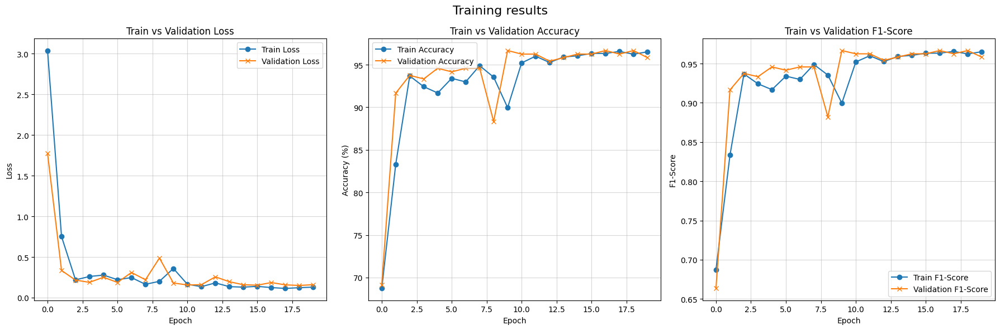

In [ ]:
plot_training_metrics(
    train_losses=metrics_SNN['train_losses'],  # Pass the training losses from the 'metrics_SNN' dictionary
    val_losses=metrics_SNN['val_losses'],  # Pass the validation losses from the 'metrics_SNN' dictionary
    train_accuracies=metrics_SNN['train_accuracies'],  # Pass the training accuracies from the 'metrics_SNN' dictionary
    val_accuracies=metrics_SNN['val_accuracies'],  # Pass the validation accuracies from the 'metrics_SNN' dictionary
    train_f1_scores=metrics_SNN['train_f1_scores'],  # Pass the training F1-scores from the 'metrics_SNN' dictionary
    val_f1_scores=metrics_SNN['val_f1_scores'],  # Pass the validation F1-scores from the 'metrics_SNN' dictionary
    title="Training results"  # Set the ti


**Observations:**

* Both the train and the validation loss converge to values close to o.2. This is a good indicator of generalization.
* In a similar fashion, accuracy and F1-score approach to ~96% for both validation and training data, indicating good generalization.

#### **Visualize classifications**

Input shape x: torch.Size([64, 3, 224, 224])
Shape of x after view: torch.Size([64, 150528])
Output shape x: torch.Size([64, 2])


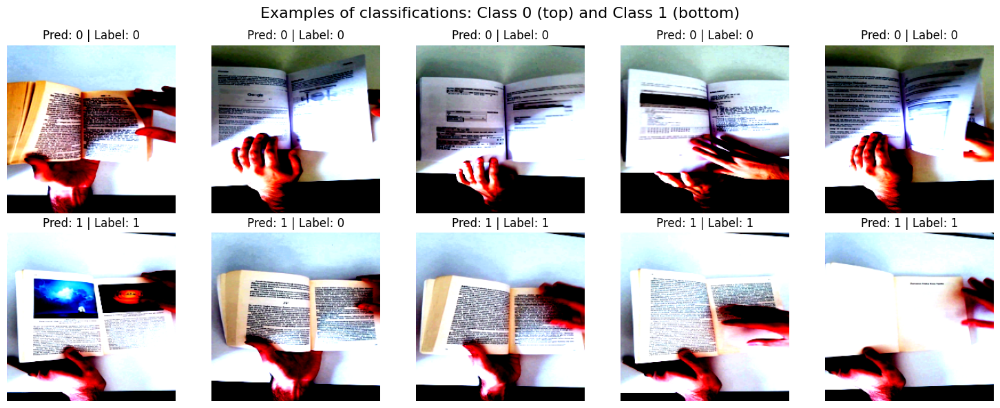

In [ ]:
visualize_predictions(
    model=model_SNN,  # Trained model
    data_loader=validation_loader,  # Validation DataLoader
    device=device,  # CPU/GPU
    num_examples=5  # Number of samples per class
)

**Observations:**

* In the visual inspection, both true class zero (no flip) and class one (flip) images present mixed features from both classes. We suspect of a poor labeling process on the data.

#### **Visualize Missclassifications**

Input shape x: torch.Size([64, 3, 224, 224])
Shape of x after view: torch.Size([64, 150528])
Output shape x: torch.Size([64, 2])
Input shape x: torch.Size([64, 3, 224, 224])
Shape of x after view: torch.Size([64, 150528])
Output shape x: torch.Size([64, 2])
Input shape x: torch.Size([64, 3, 224, 224])
Shape of x after view: torch.Size([64, 150528])
Output shape x: torch.Size([64, 2])
Input shape x: torch.Size([48, 3, 224, 224])
Shape of x after view: torch.Size([48, 150528])
Output shape x: torch.Size([48, 2])


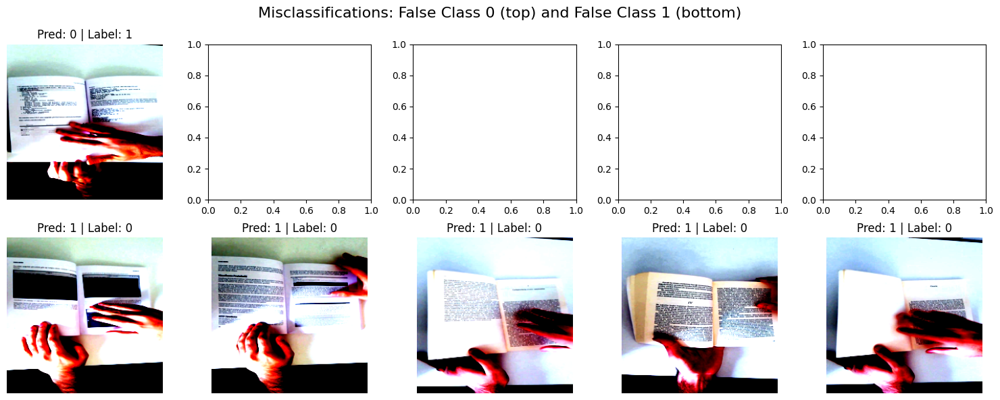

In [ ]:
visualize_misclassifications(
    model=model_SNN,  # Trained model
    data_loader=validation_loader,  # Validation DataLoader
    device=device,  # CPU/GPU
    num_examples=5  # Number of misclassified samples per class
)


**Observations:**

* In the visual inspection, both false class zero (no flip) and class one (flip) images are also affected by mislabeling.

* Error Analysis:

* One thing we can do is to identify the misclassified examples, relabel them and then retrain the model. We are not going to do that right now, but the discovery is extremely valuable for the business.

* Annotators are poorly paid people (labeling for us). They get tired sometime, they don't put a lot of attention, there will be always errors, there might be quality issues.

#### **Save Model**

We will saved the first model:

In [ ]:
torch.save(model_SNN.state_dict(), 'simple_nn.pth')  # Save the model's state_dict to a file named 'simple_nn.pth'

#### **Load Model**

We can load the saved model in this line:

In [ ]:
model_SNN.load_state_dict(torch.load('simple_nn.pth'))  # Load the model's state_dict from the file 'simple_nn.pth'

<ipython-input-127-afce67e5b3fd>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_SNN.load_state_dict(torch.load('simple_nn.pth'))


<All keys matched successfully>

### **Single Neural Network - Iteration 2**

#### **Architecture of Neural Network**

The **`ImprovedNN1`** class represents a fully connected feedforward neural network with enhancements for better performance and generalization. Here is a detailed description of its architecture:

**Input Layer**
  * **Input Shape:** The network expects an input of size 224×224×3, which is typically an RGB image flattened into a 1D vector of size 224×224×3=150,528 features.

**Hidden Layers**

1. **First Layer:**

  * **Fully Connected (fc1):** This layer maps the input size (150,528) to 256 units.
  * **Batch Normalization (bn1):** A normalization layer applied to stabilize and speed up training.
  * **Activation:** A LeakyReLU activation function is used, allowing a small negative slope (0.01) for negative values to avoid dead neurons.
2. **Second Layer:**

  * **Fully Connected (fc2):** Reduces the feature dimension from 256 to 128 units.
  * **Batch Normalization (bn2):** Normalizes the outputs of the second fully connected layer.
  * **Activation:** Another LeakyReLU activation is applied.

3. **Third Layer:**

  * **Fully Connected (fc3):** Reduces the dimension further, from 128 to 64 units.
  * **Dropout:** A dropout layer with a probability of 50% is applied before the activation. This regularization technique randomly sets 50% of the neurons to zero during training to prevent overfitting.
  * **Activation:** The LeakyReLU activation function is applied after the dropout.

**Output Layer**

  * **Fully Connected (fc4):** Maps the 64-unit vector to a 2-unit output, which can represent logits for binary classification (e.g., class 0 and class 1).
  * **No Activation Function:** The raw logits are returned, as they can be further processed by a loss function (e.g., CrossEntropyLoss).

**Forward Pass**

The input data passes through the following sequence of operations:

1. **Flattening:** The input is reshaped into a 1D vector.
2. **Layer 1:** fc1→bn1→LeakyReLU.
3. **Layer 2:** fc2→bn2→LeakyReLU.
4. **Layer 3:** Dropout→fc3→LeakyReLU.
5. **Output Layer:** fc4

**Key Features**

1. **Batch Normalization:** Helps to reduce internal covariate shift, allowing faster and more stable training.
2. **LeakyReLU Activation:** Avoids dead neurons by allowing small gradients for negative inputs.
3. **Dropout:** Reduces overfitting by randomly dropping neurons during training.
4. **Dimensionality Reduction:** The sequential reduction of feature dimensions (from 256 to 2) ensures that the model learns compact, meaningful representations.

This architecture is designed for binary classification tasks and incorporates techniques to improve training stability and generalization.

In [ ]:
class ImprovedNN1(nn.Module):  # Define the Improved Neural Network class inheriting from nn.Module
    def __init__(self):  # Constructor method to initialize layers
        super(ImprovedNN1, self).__init__()  # Call parent class constructor

        # Fully connected layers
        self.fc1 = nn.Linear(224*224*3, 256)  # Fully connected layer from input size (224*224*3) to 256 units
        self.bn1 = nn.BatchNorm1d(256)        # Batch normalization layer for the first layer

        self.fc2 = nn.Linear(256, 128)        # Fully connected layer from 256 to 128 units
        self.bn2 = nn.BatchNorm1d(128)        # Batch normalization layer for the second layer

        self.fc3 = nn.Linear(128, 64)         # Fully connected layer from 128 to 64 units
        self.dropout = nn.Dropout(0.5)        # Dropout layer for regularization with 50% probability

        self.fc4 = nn.Linear(64, 2)           # Final fully connected layer for output, 2 units (for binary classification)

        # Activation function
        self.activation = nn.LeakyReLU(negative_slope=0.01)  # LeakyReLU activation with a small negative slope

    def forward(self, x):  # Forward pass through the network
        x = x.view(x.size(0), -1)  # Flatten the input tensor to a 1D vector for each batch

        x = self.activation(self.bn1(self.fc1(x)))  # Pass through fc1 -> BatchNorm -> Activation
        x = self.activation(self.bn2(self.fc2(x)))  # Pass through fc2 -> BatchNorm -> Activation

        x = self.dropout(x)  # Apply dropout to reduce overfitting
        x = self.activation(self.fc3(x))  # Pass through fc3 -> Activation

        x = self.fc4(x)  # Output layer (final logits, no activation applied here)
        return x  # Return the output logits

The following code snippets follow the same structure and sequence that the one from Iteration 1.

In [ ]:
# Model instance
model_INN1 = ImprovedNN1().to(device)  # Instantiate the ImprovedNN1 model and move it to the specified device (CPU or GPU)
print(model)  # Print the model structure

ImprovedNN(
  (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=200704, out_features=128, bias=True)
  (fc2): Linear(in_features=128, out_features=64, bias=True)
  (fc3): Linear(in_features=64, out_features=2, bias=True)
  (relu): ReLU()
)


#### **Optimizer and Loss Function**

In [ ]:
# Define the loss function for classification problems
# CrossEntropyLoss is suitable for multi-class classification
criterion_INN1 = nn.CrossEntropyLoss().to(device)

# Define the optimizer for training the model
# Adam optimizer is chosen for its efficiency in handling gradients
# It optimizes the model parameters with a learning rate of 0.001
optimizer_INN1 = optim.Adam(model_INN1.parameters(), lr=0.001)


#### **Training the model**

In [ ]:
# Early Stopping configuration
early_stopping_INN1 = EarlyStopping(patience=10, verbose=True, path='checkpoint_INN1.pth')  # Initialize EarlyStopping with patience of 10 epochs, verbose mode, and checkpoint path

# Call the training function with early stopping
metrics_INN1 = train_with_early_stopping(  # Call the function to train the model with early stopping
    model=model_INN1,  # The neural network model to train
    train_loader=train_loader,  # DataLoader for the training dataset
    validation_loader=validation_loader,  # DataLoader for the validation dataset
    criterion=criterion_INN1,  # Loss function for computing training/validation losses
    optimizer=optimizer_INN1,  # Optimizer to update the model parameters
    device=device,  # Hardware device for computation (e.g., GPU or CPU)
    num_epochs=20,  # Number of training epochs
    early_stopping=early_stopping_INN1,  # EarlyStopping instance to monitor validation performance
    verbose=True,  # Enable verbose output during training
)

# Print final metrics
print("Training and validation metrics: ")  # Print a message indicating the metrics will be displayed
print(metrics_INN1)  # Display the training and validation metrics collected during training


Epoch [1/20], Train Loss: 0.5105, Train Accuracy: 74.77%, Train F1-Score: 0.7477
Validation Loss: 0.5110, Validation Accuracy: 72.92%, Validation F1-Score: 0.7132
Validation F1-score improved (-inf --> 0.7132). Saving model...
Epoch [2/20], Train Loss: 0.2691, Train Accuracy: 90.24%, Train F1-Score: 0.9024
Validation Loss: 0.1796, Validation Accuracy: 95.00%, Validation F1-Score: 0.9500
Validation F1-score improved (0.7132 --> 0.9500). Saving model...
Epoch [3/20], Train Loss: 0.2004, Train Accuracy: 93.59%, Train F1-Score: 0.9359
Validation Loss: 0.4432, Validation Accuracy: 86.25%, Validation F1-Score: 0.8608
EarlyStopping counter: 1 out of 10
Epoch [4/20], Train Loss: 0.1642, Train Accuracy: 94.84%, Train F1-Score: 0.9484
Validation Loss: 0.1664, Validation Accuracy: 95.42%, Validation F1-Score: 0.9541
Validation F1-score improved (0.9500 --> 0.9541). Saving model...
Epoch [5/20], Train Loss: 0.1411, Train Accuracy: 96.19%, Train F1-Score: 0.9619
Validation Loss: 0.1653, Validation 

<ipython-input-106-fed6c2288490>:140: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(early_stopping.path))


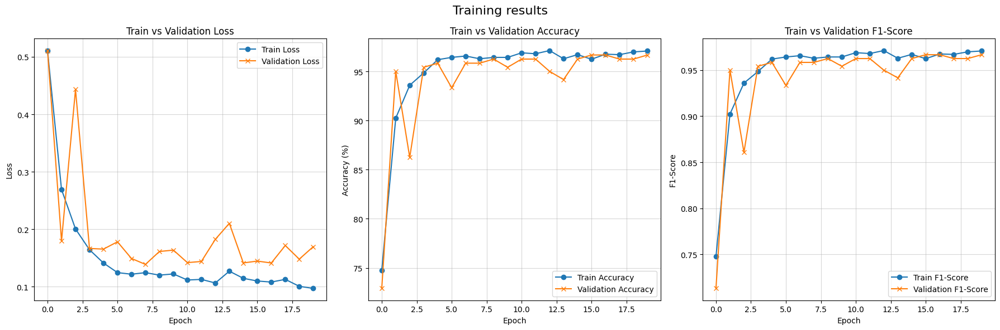

In [ ]:
plot_training_metrics(  # Call the function to plot the training and validation metrics
    train_losses=metrics_INN1['train_losses'],  # Pass the training losses from the 'metrics_INN1' dictionary
    val_losses=metrics_INN1['val_losses'],  # Pass the validation losses from the 'metrics_INN1' dictionary
    train_accuracies=metrics_INN1['train_accuracies'],  # Pass the training accuracies from the 'metrics_INN1' dictionary
    val_accuracies=metrics_INN1['val_accuracies'],  # Pass the validation accuracies from the 'metrics_INN1' dictionary
    train_f1_scores=metrics_INN1['train_f1_scores'],  # Pass the training F1-scores from the 'metrics_INN1' dictionary
    val_f1_scores=metrics_INN1['val_f1_scores'],  # Pass the validation F1-scores from the 'metrics_INN1' dictionary
    title="Training results"  # Set the title of the plot
)

**Observations:**

* In contrast with Iteration 1, loss for validation data is more erratic as epochs increase. On the other hand, train loss decreases smoothly. That means that generalization is not as good as the one from Iteration 1.
* Both accuracy and F1-scores present values similar to the ones from Iteration 1.

#### **Visualize classifications**

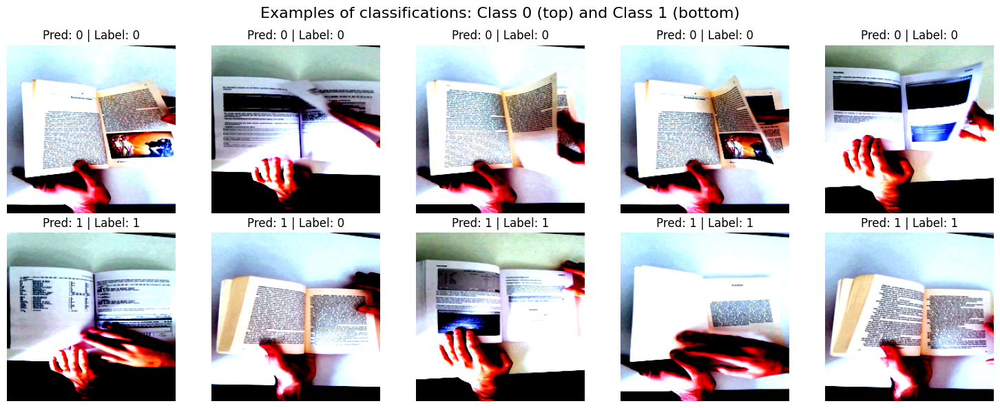

In [ ]:
visualize_predictions(
    model=model_INN1,         # Trained model
    data_loader=validation_loader,  # Validation DataLoader
    device=device,           # CPU/GPU
    num_examples=5           # Number of samples per class
)

**Observations:**

* True class zero and class one images present similar features. Mislabeling is present in the data.

#### **Visualize misclassifications**

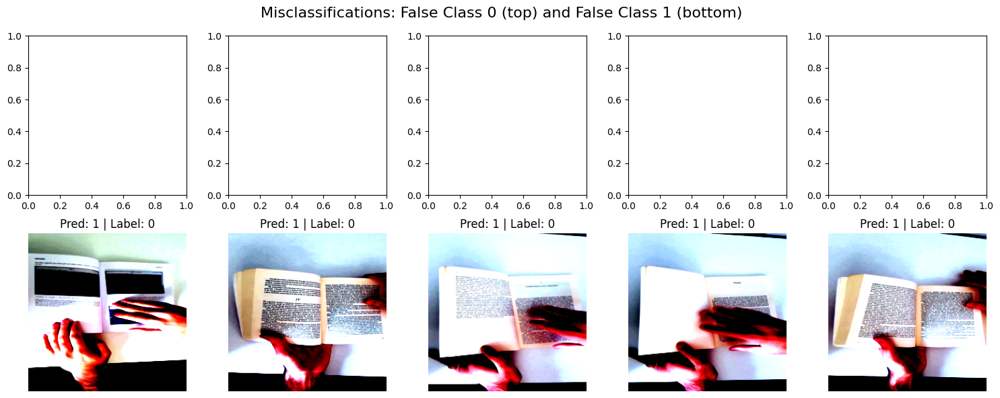

In [ ]:
visualize_misclassifications(
    model=model_INN1,         # Trained Model
    data_loader=validation_loader,  # Validaton DataLoader
    device=device,           # CPU/GPU
    num_examples=5           # Número of misclassified samples per class
)

**Observations:**

* Mislabeling is present in data since it is not clear what makes a class-zero picture different from a class-one image.

### **Single Neural Network - Iteration 3**


#### **Architecture of Neural Network**


The **`ImprovedNN2`** class represents a convolutional neural network (CNN) designed for binary classification tasks. Below is a detailed explanation of its architecture:

1. **Input Layer**
  * Input Shape: The network processes images with dimensions 224×224×3, corresponding to RGB images with 3 color channels.

2. **Convolutional Layers**

The convolutional layers extract spatial features from the input image. Each layer applies a set of filters to detect patterns like edges, textures, or higher-level features.

**First Convolutional Layer:**

  * **Layer:** **`self.conv1`**
    * Input Channels: 3 (RGB image).
    * Output Channels: 32 (32 feature maps).
    * Kernel Size: 3×3 (local receptive field size).
    * Stride: 1 (slide the kernel by 1 pixel at a time).
    * Padding: 1 (preserves spatial dimensions).
  * **Activation:** ReLU (introduces non-linearity).
  * **Max Pooling:** Reduces the spatial dimensions by half (224×224→112×112).

**Second Convolutional Layer:**
  * **Layer:** **`self.conv2`**
    * Input Channels: 32 (feature maps from the first layer).
    * Output Channels: 64 (64 feature maps).
    * Kernel Size: 3×3.
    * Stride: 1.
    * Padding: 1.
  * **Activation:** ReLU.
  * **Max Pooling:** Further reduces spatial dimensions by half (112×112→56×56).

3. **Flattening Layer**

Before passing the features to the fully connected (FC) layers, the 3D tensor (dimensions: 56×56×64) is flattened into a 1D vector (56×56×64=200,704) using **`x.view(x.size(0), -1).`**

4. **Fully Connected Layers (FC)**

The fully connected layers act as the classifier by learning patterns from the extracted features.

**First Fully Connected Layer:**
  * **Layer:** self.fc1
    * Input Features: 200,704 (flattened output from the convolutional layers).
    * Output Features: 128 (reduced dimensionality).
  * **Activation:** ReLU.

**Second Fully Connected Layer:**

  * **Layer:** self.fc2
    * Input Features: 128.
    * Output Features: 64.
  * **Activation:** ReLU.

**Output Layer:**
  * **Layer:** **`self.fc3`**
    * Input Features: 64.
    * Output Features: 2 (logits for binary classification).
  * **Activation:** None (raw logits are returned).
5. **Activation Function**
  * **ReLU** (Rectified Linear Unit):
    * Applied after each convolutional and fully connected layer (except the output layer).
    * Introduces non-linearity and helps the network learn complex patterns.
6. **Pooling Layers**
  * **Max Pooling:**
    * Reduces spatial dimensions while retaining the most important features.
    * Applied after each convolutional layer to reduce computational complexity and prevent overfitting.

7. **Forward Pass**

The data flows through the network in the following sequence:

1. **Conv1:** Apply convolution → ReLU → Max Pooling.
2. **Conv2:** Apply convolution → ReLU → Max Pooling.
3. **Flatten:** Reshape the 3D tensor into a 1D vector.
4. **FC1:** Fully connected layer → ReLU.
5. **FC2:** Fully connected layer → ReLU.
6. **FC3:** Fully connected layer (output logits).

**Key Features of the Architecture**

1. **Convolutional Layers:** Automatically learn spatial features from the input image.
2. **Max Pooling:** Reduces feature map dimensions to prevent overfitting and improve computational efficiency.
3. **Fully Connected Layers:** Perform classification based on the extracted features.
4. **ReLU Activation:** Ensures efficient learning by introducing non-linearity and avoiding vanishing gradients.

This architecture combines the feature extraction capabilities of convolutional layers with the classification strength of fully connected layers, making it well-suited for image classification tasks.

In [ ]:
class ImprovedNN2(nn.Module):  # Define the ImprovedNN2 class inheriting from nn.Module
    def __init__(self):  # Initialization method
        super(ImprovedNN2, self).__init__()  # Call the parent class's constructor

        # Convolutional layers
        self.conv1 = nn.Conv2d(3, 32, kernel_size=3, stride=1, padding=1)  # 3 input channels (RGB) to 32 output channels (feature maps)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)  # MaxPooling operation reduces size by half
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)  # 32 input channels to 64 output channels
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)  # Second MaxPooling operation

        # Fully Connected Layers (FC)
        self.fc1 = nn.Linear(56*56*64, 128)  # Flattened size (56x56x64) to 128 nodes in the FC layer
        self.fc2 = nn.Linear(128, 64)  # 128 nodes to 64 nodes in the next FC layer
        self.fc3 = nn.Linear(64, 2)  # 64 nodes to 2 output nodes (2 classes)

        # Activation function
        self.relu = nn.ReLU()  # ReLU activation function for non-linearity

    def forward(self, x):  # Forward pass
        x = self.relu(self.conv1(x))  # Apply the first convolution + ReLU activation
        x = self.pool(x)  # Apply max pooling
        x = self.relu(self.conv2(x))  # Apply the second convolution + ReLU activation
        x = self.pool2(x)  # Apply second max pooling
        x = x.view(x.size(0), -1)  # Flatten the tensor to pass to fully connected layers
        x = self.relu(self.fc1(x))  # Apply FC1 + ReLU
        x = self.relu(self.fc2(x))  # Apply FC2 + ReLU
        x = self.fc3(x)  # Output layer with no activation (logits)
        return x  # Return the output logits (used for classification)


The rest of the following code snippets follow the same structure and sequence that the ones from Iteration 1 and 2.

In [ ]:
# Model instance
model_INN2 = ImprovedNN2().to(device)  # Instantiate the ImprovedNN2 model and send it to the device (GPU/CPU)
print(model_INN2)  # Print the model architecture to verify the structure

ImprovedNN(
  (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=200704, out_features=128, bias=True)
  (fc2): Linear(in_features=128, out_features=64, bias=True)
  (fc3): Linear(in_features=64, out_features=2, bias=True)
  (relu): ReLU()
)


#### **Optimizer and loss function**

In [ ]:
# Define the loss function for classification problems
# CrossEntropyLoss is suitable for multi-class classification
criterion_INN2 = nn.CrossEntropyLoss().to(device)

# Define the optimizer for training the model
# Adam optimizer is chosen for its efficiency in handling gradients
# It optimizes the model parameters with a learning rate of 0.001
optimizer_INN2 = optim.Adam(model_INN2.parameters(), lr=0.001)


#### **Training the model**

In [ ]:
# Early Stopping configuration
early_stopping_INN2 = EarlyStopping(patience=10, verbose=True, path='checkpoint_INN2.pth')  # Initialize EarlyStopping with patience of 10 epochs, verbose mode, and checkpoint path

# Call the training function with early stopping
metrics_INN2 = train_with_early_stopping(  # Call the function to train the model with early stopping
    model=model_INN2,  # The neural network model to train
    train_loader=train_loader,  # DataLoader for the training dataset
    validation_loader=validation_loader,  # DataLoader for the validation dataset
    criterion=criterion_INN2,  # Loss function for computing training/validation losses
    optimizer=optimizer_INN2,  # Optimizer to update the model parameters
    device=device,  # Hardware device for computation (e.g., GPU or CPU)
    num_epochs=20,  # Number of training epochs
    early_stopping=early_stopping_INN2,  # EarlyStopping instance to monitor validation performance
    verbose=True,  # Enable verbose output during training
)

# Print final metrics
print("Training and validation metrics: ")  # Print a message indicating the metrics will be displayed
print(metrics_INN2)  # Display the training and validation metrics collected during training


Epoch [1/20], Train Loss: 0.7415, Train Accuracy: 66.36%, Train F1-Score: 0.6629
Validation Loss: 0.3996, Validation Accuracy: 83.75%, Validation F1-Score: 0.8351
Validation F1-score improved (-inf --> 0.8351). Saving model...
Epoch [2/20], Train Loss: 0.2713, Train Accuracy: 89.92%, Train F1-Score: 0.8992
Validation Loss: 0.2705, Validation Accuracy: 90.83%, Validation F1-Score: 0.9080
Validation F1-score improved (0.8351 --> 0.9080). Saving model...
Epoch [3/20], Train Loss: 0.1662, Train Accuracy: 95.03%, Train F1-Score: 0.9503
Validation Loss: 0.2233, Validation Accuracy: 93.75%, Validation F1-Score: 0.9374
Validation F1-score improved (0.9080 --> 0.9374). Saving model...
Epoch [4/20], Train Loss: 0.1529, Train Accuracy: 95.63%, Train F1-Score: 0.9563
Validation Loss: 0.1595, Validation Accuracy: 96.25%, Validation F1-Score: 0.9625
Validation F1-score improved (0.9374 --> 0.9625). Saving model...
Epoch [5/20], Train Loss: 0.1202, Train Accuracy: 96.79%, Train F1-Score: 0.9679
Valid

<ipython-input-106-fed6c2288490>:140: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(early_stopping.path))


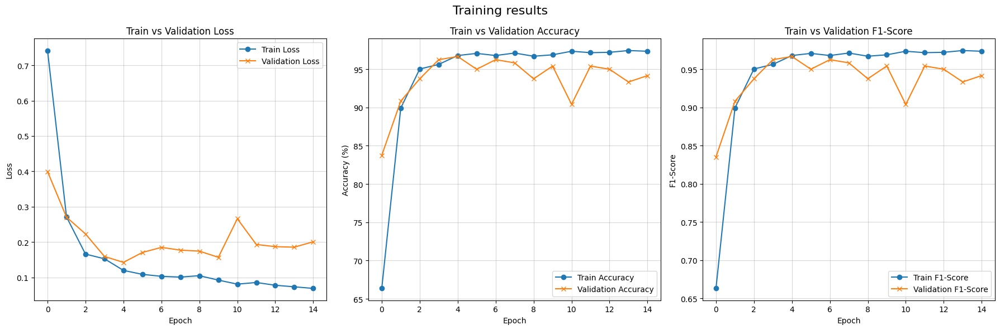

In [ ]:
# Call the plot_training_metrics function to plot the training and validation metrics
plot_training_metrics(
    train_losses=metrics_INN2['train_losses'],  # Pass the training losses from the 'metrics_INN2' dictionary
    val_losses=metrics_INN2['val_losses'],  # Pass the validation losses from the 'metrics_INN2' dictionary
    train_accuracies=metrics_INN2['train_accuracies'],  # Pass the training accuracies from the 'metrics_INN2' dictionary
    val_accuracies=metrics_INN2['val_accuracies'],  # Pass the validation accuracies from the 'metrics_INN2' dictionary
    train_f1_scores=metrics_INN2['train_f1_scores'],  # Pass the training F1-scores from the 'metrics_INN2' dictionary
    val_f1_scores=metrics_INN2['val_f1_scores'],  # Pass the validation F1-scores from the 'metrics_INN2' dictionary
    title="Training results"  # Set the title of the plot
)

**Observations:**

* The train loss decreases smoothly, but the validation loss, after epoch 4, becomes erratic and in fact increases the values of loss, exceeding in +0.1 those from the train curve.
* As the curve of accuracy and F1-score surpass epoch 8, their values become more modest, ranging from 0.9 to 0.94, evidently lower than the steady ~ 0.96 from the train curves.

#### **Visualize classifications**

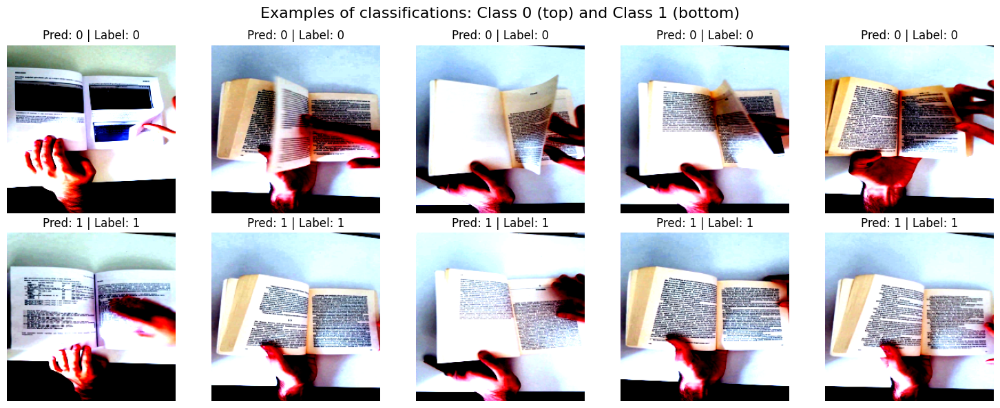

In [ ]:
visualize_predictions(
    model=model_INN2,         # Trained model
    data_loader=validation_loader,  # Validation DataLoader
    device=device,           # CPU/GPU
    num_examples=5           # Number of samples per class
)

**Observations:**

* Both true class-one and class-zero images cannot be distinguished one from each other. Mislabeling is also detected in these samples.

#### **Visualize misclassifications**

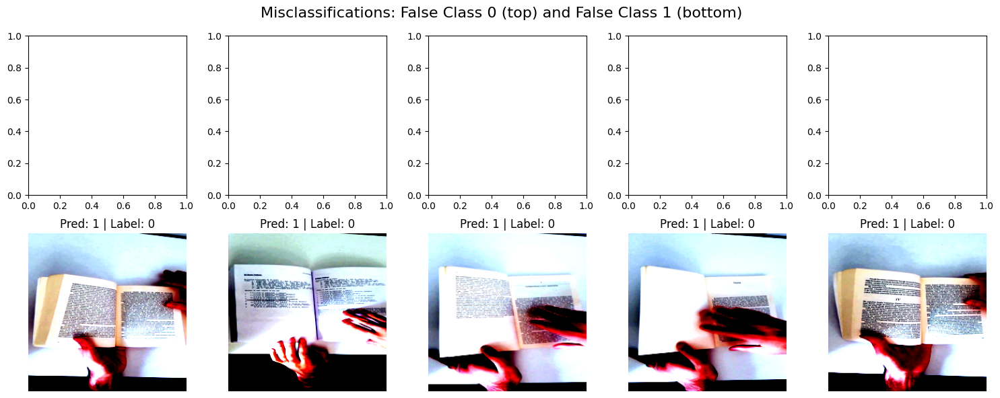

In [ ]:
visualize_misclassifications(
    model=model_INN2,         # Trained Model
    data_loader=validation_loader,  # Validaton DataLoader
    device=device,           # CPU/GPU
    num_examples=5           # Número of misclassified samples per class
)

**Observations:**

* False class-one images have characteristics from an expected class-zero image.

#### **Save model**

In [ ]:
# Save the state dictionary of the model
torch.save(model_INN2.state_dict(), 'improved_nn2.pth')

#### **Load model**

In [ ]:
# Load the model's state dictionary from the saved file
model_INN2.load_state_dict(torch.load('improved_nn2.pth'))

<ipython-input-143-f5413e263a20>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_INN2.load_state_dict(torch.load('improved_nn2.pth'))


<All keys matched successfully>

## **ResNet - Custom**

*`ResNet`*, short for *`Residual Network`*, is a groundbreaking deep learning architecture introduced by Microsoft in 2015, primarily designed to address the vanishing gradient problem in very deep neural networks. ResNet leverages residual connections, also known as skip connections, which allow the network to learn identity mappings by bypassing one or more layers. This innovative design enables the training of exceptionally deep networks, with versions such as ResNet-50, ResNet-101, and even ResNet-152 becoming benchmarks for image recognition tasks. ResNet's ability to extract hierarchical features efficiently while maintaining stability has made it a cornerstone model in computer vision, powering applications like image classification, object detection, and transfer learning across numerous domains.

### **Residual Block**


In this code, we define a **ResidualBlock**, a fundamental building block for implementing ResNet architectures. Residual blocks are designed to improve training efficiency by allowing the model to learn residual mappings instead of the full transformation. The block consists of two convolutional layers, each followed by Batch Normalization to stabilize learning and improve convergence.

The first convolutional layer applies a stride (default is 1) to control the spatial dimensions of the output, and the second retains the same spatial resolution. A ReLU activation function is used after the first convolution and after the residual addition to introduce non-linearity.

When the input and output dimensions differ, a **downsampling** layer is optionally applied to the input (residual connection) to align it with the output dimensions. This downsampling ensures that the addition operation between the residual and the transformed output is valid.

During the **forward pass**, the input tensor flows through the two convolutional layers, and the resulting output is added to the original input (or the downsampled input, if applicable). This addition creates the shortcut connection that gives ResNet its distinctive residual learning ability. By learning only the residual, this design makes it easier for the network to train very deep architectures while minimizing the risk of vanishing gradients.

In [ ]:
class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1, downsample=None):
        """
        Initializes a residual block.

        Args:
            in_channels (int): Number of input channels.
            out_channels (int): Number of output channels.
            stride (int, optional): The stride for the first convolution. Default is 1.
            downsample (nn.Module, optional): A downsample layer that is applied to the residual (input).
                                               It's used when the input and output sizes differ.
        """
        super(ResidualBlock, self).__init__()

        # First convolution layer with Batch Normalization and ReLU activation
        self.conv1 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU())

        # Second convolution layer with Batch Normalization
        self.conv2 = nn.Sequential(
            nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(out_channels))

        # Downsampling layer (if needed), applied when input and output sizes don't match
        self.downsample = downsample

        # ReLU activation function
        self.relu = nn.ReLU()

        # Storing the number of output channels for later use
        self.out_channels = out_channels

    def forward(self, x):
        """
        Forward pass through the residual block.

        Args:
            x (Tensor): Input tensor.

        Returns:
            Tensor: Output tensor after passing through the residual block.
        """
        # Store the input for the residual connection
        residual = x

        # First convolutional layer + BatchNorm + ReLU
        out = self.conv1(x)

        # Second convolutional layer + BatchNorm
        out = self.conv2(out)

        # Apply downsampling (if necessary) to adjust dimensions
        if self.downsample:
            residual = self.downsample(x)

        # Add the residual connection to the output
        out += residual

        # Apply ReLU activation after the addition
        out = self.relu(out)

        return out

In this code, we define the ResNet architecture as a PyTorch class, building on the concept of residual learning introduced in the original ResNet paper. The network is modular, allowing us to specify the type of residual block **`(block)`**, the number of layers in each stage **`(layers)`**, and the number of output classes **`(num_classes)`** for classification tasks.

The **ResNet** begins with an initial convolutional block that extracts low-level features from the input image, followed by a max-pooling layer to reduce the spatial dimensions. After this, four main residual layers are defined (**`layer0`** to **`layer3`), with each layer consisting of a stack of residual blocks. These layers progressively increase the number of feature channels (from 64 to 512) while downsampling the spatial dimensions using strides.

The **`_make_layer`** function is a helper method used to construct each residual layer. It allows for the inclusion of a downsampling layer when necessary, ensuring that the dimensions of the residual connection match those of the output. The first block in each layer performs downsampling when needed, while subsequent blocks maintain the same dimensions.

After passing through the main layers, the model applies global average pooling to aggregate spatial information, producing a compact feature vector. This vector is then flattened and passed through a fully connected layer **`(fc)`** to generate the final class scores.

The forward pass describes how input data flows through the network. It passes through the initial convolutional block, max-pooling, residual layers, average pooling, and finally the fully connected layer to produce the output predictions. This design makes ResNet highly effective for image classification tasks, leveraging residual connections to mitigate vanishing gradient issues and allowing for the training of very deep networks.

In [ ]:
# Define a class `ResNet` that inherits from PyTorch's `nn.Module`.
class ResNet(nn.Module):

    # Initialize the ResNet with the block type, number of layers, and number of output classes.
    def __init__(self, block, layers, num_classes=2):
        # Call the parent class constructor to initialize.
        super(ResNet, self).__init__()

        # Initialize the starting number of channels (input planes) for the network.
        self.inplanes = 64

        # Define the initial convolutional block:
        # 1. 2D convolution layer with 3 input channels (RGB image), 64 output channels,
        #    a kernel size of 7, stride of 2, and padding of 3.
        # 2. Batch normalization to normalize the output.
        # 3. ReLU activation function for non-linearity.
        self.conv1 = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=7, stride=2, padding=3),
            nn.BatchNorm2d(64),
            nn.ReLU()
        )

        # Define a max pooling layer with a kernel size of 3, stride of 2, and padding of 1
        # to reduce spatial dimensions.
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)

        # Create the first layer block with 64 output channels and a specified number of blocks (layers[0]).
        # Use a stride of 1.
        self.layer0 = self._make_layer(block, 64, layers[0], stride=1)

        # Create subsequent layer blocks with increasing output channels (128, 256, 512)
        # and a stride of 2 to downsample spatial dimensions.
        self.layer1 = self._make_layer(block, 128, layers[1], stride=2)
        self.layer2 = self._make_layer(block, 256, layers[2], stride=2)
        self.layer3 = self._make_layer(block, 512, layers[3], stride=2)

        # Define an average pooling layer with a kernel size of 7 and stride of 1
        # to aggregate spatial information.
        self.avgpool = nn.AvgPool2d(7, stride=1)

        # Define a fully connected (linear) layer to map the final feature map to class scores.
        # The input size is 512 (output channels from the last layer), and the output size is `num_classes`.
        self.fc = nn.Linear(512, num_classes)

    # Define a helper function to create a layer of blocks.
    def _make_layer(self, block, planes, blocks, stride=1):
        # Initialize a downsample layer if the stride is not 1 or if the input and output planes don't match.
        downsample = None
        if stride != 1 or self.inplanes != planes:
            # Create a sequential block for downsampling:
            # 1. 2D convolution to match dimensions.
            # 2. Batch normalization for normalization.
            downsample = nn.Sequential(
                nn.Conv2d(self.inplanes, planes, kernel_size=1, stride=stride),
                nn.BatchNorm2d(planes),
            )

        # Initialize an empty list of layers.
        layers = []

        # Add the first block with downsampling, if necessary.
        layers.append(block(self.inplanes, planes, stride, downsample))

        # Update the number of input planes to match the current layer's output.
        self.inplanes = planes

        # Add the remaining blocks in the layer.
        for i in range(1, blocks):
            layers.append(block(self.inplanes, planes))

        # Return a sequential container of all blocks in the layer.
        return nn.Sequential(*layers)

    # Define the forward pass of the ResNet model.
    def forward(self, x):
        # Pass the input through the initial convolutional block.
        x = self.conv1(x)

        # Apply max pooling to reduce the spatial dimensions.
        x = self.maxpool(x)

        # Pass the input through the successive layers (layer0 to layer3).
        x = self.layer0(x)
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)

        # Apply average pooling to reduce the spatial dimensions to a single value per channel.
        x = self.avgpool(x)

        # Flatten the spatial dimensions into a single vector per sample.
        x = x.view(x.size(0), -1)

        # Pass the flattened vector through the fully connected layer for classification.
        x = self.fc(x)

        # Return the final output (class scores).
        return x


### **Model**

In this code snippet, we define key hyperparameters and initialize the ResNet model for a binary classification task.

1. **`num_classes = 2:`** This specifies the number of output classes for the model. Since this is a binary classification problem, the model will output predictions for two classes.

2. **`num_epochs = 100:`** This indicates the total number of training epochs. An epoch is a complete pass through the training dataset.

3. **`batch_size = 64:`** This sets the batch size, meaning the model processes 64 samples at a time during each training step. A smaller or larger batch size can affect both training stability and computational efficiency.

4. **`learning_rate = 0.01:`** The learning rate controls the step size for the optimizer when updating the model parameters. A value of 0.01 ensures moderate adjustments during training.

5. **`model_ResNet = ResNet(ResidualBlock, [3, 4, 6, 2], num_classes=num_classes).to(device):`**

*  Here, we instantiate the ResNet model, specifying the architecture as follows:
 * **`ResidualBlock`** is the type of building block used in the network, defining the residual connections.
 * **`[3, 4, 6, 2]`** specifies the number of residual blocks in each layer of the ResNet. These numbers correspond to a specific ResNet variant, where deeper layers provide richer feature extraction.
 * **`num_classes=num_classes`** sets the output layer to produce two class scores, aligning with the binary classification task.
* The **`.to(device)`** function transfers the model to the specified computing device (e.g., GPU or CPU), ensuring compatibility with the hardware for efficient computation.
This setup prepares the ResNet model with the necessary architecture and hyperparameters to train on the binary classification problem over 100 epochs with batches of size 64 and a learning rate of 0.01.

In [ ]:
num_classes = 2                       # Number of output classes (for binary classification)
num_epochs = 100                      # Number of epochs for training
batch_size = 64                       # Batch size for each training step
learning_rate = 0.01                  # Learning rate for the optimizer
model_ResNet = ResNet(ResidualBlock, [3, 4, 6, 2], num_classes=num_classes).to(device)

Here, we freeze the initial layers of the **ResNet** model to retain the features learned during pretraining on the ImageNet dataset. This approach is commonly used in transfer learning to focus training on task-specific layers while leveraging pre-trained features.

1. **`for name, param in model_ResNet.named_parameters():`** This iterates over all the parameters of the model, providing both the layer names (name) and their corresponding parameters (param). This allows us to selectively modify the training behavior of specific layers.

2. **`if "fc" not in name:`** The fully connected layer (fc) is excluded from freezing because it is specific to the current task (e.g., binary classification) and needs to be trained on the new dataset. All other layers are considered for freezing.

3. **`param.requires_grad = False:`** This disables gradient computation for the selected parameters, effectively "freezing" these layers. As a result:
 * The frozen layers retain the features they learned during pretraining.
 * These layers will not be updated during backpropagation, saving computational resources and preventing the loss of pre-trained knowledge.

Freezing the initial layers allows the model to use pre-trained feature representations (e.g., edges, textures, shapes) learned from the ImageNet dataset. Training is focused on the final layers **`(fc)`**, which adapt these features to the current task (binary classification). This is particularly effective when the new dataset is small or similar to ImageNet, as it reduces the risk of overfitting and speeds up training.

In [ ]:
# Freezing initial layers to avoid updating during training, in order to retain features learned in ImageNet
for name, param in model_ResNet.named_parameters():
    if "fc" not in name:  # Freeze all layers except the fully connected layer
        param.requires_grad = False


This code defines the loss function and optimizer for training a deep learning model using PyTorch. First, **`criterion_ResNet = nn.CrossEntropyLoss()`** sets the loss function to be the Cross-Entropy Loss, which is commonly used for classification tasks. It measures the difference between the predicted class probabilities and the true labels. Then, **`optimizer_ResNet = torch.optim.SGD(model_ResNet.parameters(), lr=learning_rate, weight_decay=0.001, momentum=0.9)`** creates the optimizer using Stochastic Gradient Descent (SGD) with several parameters: **`lr`** (learning rate) controls the step size during optimization, **`weight_decay=0.001`** adds a regularization term to prevent overfitting, and **`momentum=0.9`** helps accelerate gradients in the right direction, smoothing the optimization process. Finally, **`total_step = len(train_loader)`** calculates the total number of steps (batches) in the training process, which is the length of the training data loader **`(train_loader)`**. This value will be used in the training loop to track progress.

In [ ]:
#Loss and optimizer
criterion_ResNet = nn.CrossEntropyLoss()
optimizer_ResNet = torch.optim.SGD(model_ResNet.parameters(), lr=learning_rate, weight_decay = 0.001, momentum = 0.9)

#Train the model
total_step = len(train_loader)

### **Training**

This code implements early stopping during the training of a ResNet model to prevent overfitting and improve training efficiency. First, **`early_stopping_ResNet = EarlyStopping(patience=10, verbose=True, path='checkpoint_ResNet.pth')`** initializes the early stopping mechanism with a patience of 10 epochs, meaning the training will stop if the validation performance does not improve for 10 consecutive epochs. The **`verbose=True`** setting enables output to display the status of early stopping, and **`path='checkpoint_ResNet.pth'`** specifies the file path where the model’s best weights will be saved. Next, the **`train_with_early_stopping()`** function is called to train the model. It takes multiple parameters including the model, data loaders for the training and validation datasets, the loss function (**`criterion_ResNet`**), the optimizer (**`optimizer_ResNet`**), the device for computation (either GPU or CPU), the number of epochs, and the early stopping instance. The **`verbose=True`** setting ensures detailed output is shown during the training process. After training, the final metrics (including training and validation performance) are printed with **`print(metrics_ResNet)`**, providing insight into how well the model performed during training and validation.

In [ ]:
# Early Stopping configuration
early_stopping_ResNet = EarlyStopping(patience=10, verbose=True, path='checkpoint_ResNet.pth')  # Initialize EarlyStopping with patience of 10 epochs, verbose mode, and checkpoint path

# Call the training function with early stopping
metrics_ResNet = train_with_early_stopping(  # Call the function to train the model with early stopping
    model=model_ResNet,  # The neural network model to train
    train_loader=train_loader,  # DataLoader for the training dataset
    validation_loader=validation_loader,  # DataLoader for the validation dataset
    criterion=criterion_ResNet,  # Loss function for computing training/validation losses
    optimizer=optimizer_ResNet,  # Optimizer to update the model parameters
    device=device,  # Hardware device for computation (e.g., GPU or CPU)
    num_epochs=20,  # Number of training epochs
    early_stopping=early_stopping_ResNet,  # EarlyStopping instance to monitor validation performance
    verbose=True,  # Enable verbose output during training
)

# Print final metrics
print("Training and validation metrics: ")  # Print a message indicating the metrics will be displayed
print(metrics_ResNet)  # Display the training and validation metrics collected during training


Epoch [1/20], Train Loss: 0.4187, Train Accuracy: 81.51%, Train F1-Score: 0.8150
Validation Loss: 0.4162, Validation Accuracy: 82.50%, Validation F1-Score: 0.8246
Validation F1-score improved (-inf --> 0.8246). Saving model...
Epoch [2/20], Train Loss: 0.5049, Train Accuracy: 74.54%, Train F1-Score: 0.7454
Validation Loss: 0.4196, Validation Accuracy: 81.25%, Validation F1-Score: 0.8123
EarlyStopping counter: 1 out of 10
Epoch [3/20], Train Loss: 0.4114, Train Accuracy: 81.18%, Train F1-Score: 0.8117
Validation Loss: 0.4061, Validation Accuracy: 85.42%, Validation F1-Score: 0.8542
Validation F1-score improved (0.8246 --> 0.8542). Saving model...
Epoch [4/20], Train Loss: 0.3945, Train Accuracy: 83.50%, Train F1-Score: 0.8351
Validation Loss: 0.4442, Validation Accuracy: 82.08%, Validation F1-Score: 0.8186
EarlyStopping counter: 1 out of 10
Epoch [5/20], Train Loss: 0.3955, Train Accuracy: 82.85%, Train F1-Score: 0.8286
Validation Loss: 0.4029, Validation Accuracy: 84.58%, Validation F1

<ipython-input-106-fed6c2288490>:140: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(early_stopping.path))


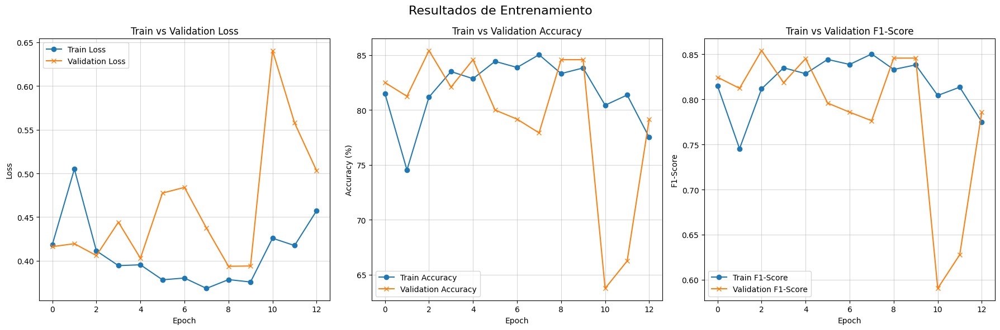

In [ ]:
plot_training_metrics(
    train_losses=metrics_ResNet['train_losses'],  # Pass training losses from the 'metrics_ResNet' dictionary
    val_losses=metrics_ResNet['val_losses'],      # Pass validation losses from the 'metrics_ResNet' dictionary
    train_accuracies=metrics_ResNet['train_accuracies'],  # Pass training accuracies from the 'metrics_ResNet' dictionary
    val_accuracies=metrics_ResNet['val_accuracies'],      # Pass validation accuracies from the 'metrics_ResNet' dictionary
    train_f1_scores=metrics_ResNet['train_f1_scores'],  # Pass training F1 scores from the 'metrics_ResNet' dictionary
    val_f1_scores=metrics_ResNet['val_f1_scores'],      # Pass validation F1 scores from the 'metrics_ResNet' dictionary
    title="Resultados de Entrenamiento"  # Set the title of the plot
)

**Observations:**

* Loss ih train data is not getting lower consistently as epochs increase. Additionaly, there is no enhancement of the loss in validation data, therefore generalization is not achieved.

### **Visualize classifications**

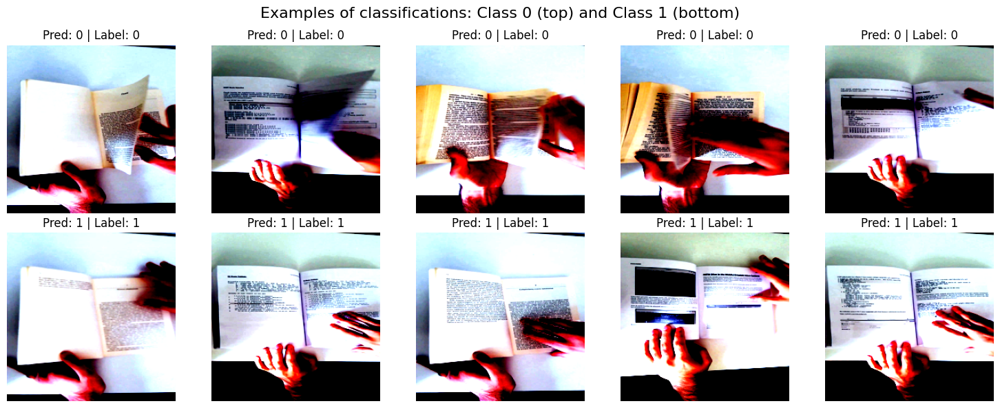

In [ ]:
visualize_predictions(
    model=model_ResNet,         # Trained model
    data_loader=validation_loader,  # Validation DataLoader
    device=device,           # CPU/GPU
    num_examples=5           # Number of samples per class
)

**Observations:**

* There is a quality issue in the labels provided: by inspecting the samples, true class zero images involve pictures with flipping and non-flipping action.
* For the true class one sample, although the images are labeled as flipping action, there is not such thing present on them.

### **Visualize Misclassifications**

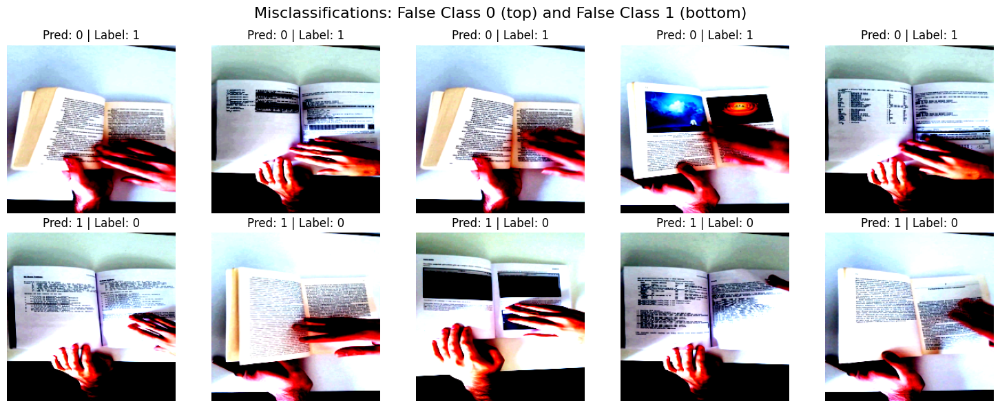

In [ ]:
visualize_misclassifications(
    model=model_ResNet,         # Trained model
    data_loader=validation_loader,  # Validation DataLoader
    device=device,           # CPU/GPU
    num_examples=5           # Number of samples per class
)

**Observations:**

* The quality of labeling is also presente in this sample images.


## **EfficientNet**

*`EfficientNet`* is a family of deep learning models designed for image classification tasks, known for its high efficiency in terms of both performance and computational cost. Developed by Google AI, EfficientNet leverages a unique compound scaling method to optimize the model's architecture, balancing network depth, width, and resolution to achieve state-of-the-art accuracy with fewer parameters compared to traditional models like ResNet or Inception. This scaling approach allows EfficientNet to achieve superior performance across a wide range of tasks, from image recognition to object detection, while maintaining a relatively small computational footprint. It is widely used in both research and industry for applications that require high accuracy with limited computational resources.

Here we show how to check for GPU availability and retrieve information about the assigned GPU using the PyTorch library. First, it imports the necessary PyTorch library with import torch. It then verifies if CUDA, which enables GPU acceleration, is available by calling torch.cuda.is_available(). If CUDA is enabled, the code proceeds to print the name of the assigned GPU using torch.cuda.get_device_name(0). This is useful for confirming that a system is correctly set up to leverage GPU resources for accelerating deep learning tasks, particularly for models that require substantial computational power.

In [ ]:
import torch  # Importing the PyTorch library

# Verify if CUDA is available (Tesla)
print("CUDA available:", torch.cuda.is_available())  # Check if CUDA (GPU support) is available

# Show GPU info
if torch.cuda.is_available():  # If CUDA is available, display GPU information
    print("GPU assigned:", torch.cuda.get_device_name(0))  # Get and display the name of the GPU assigned (device 0)

CUDA available: True
GPU assigned: Tesla T4


Here we set up the training parameters for a deep learning model, specifically configuring early stopping. It begins by defining the number of epochs for training, num_epochs = 100, which indicates how many times the entire dataset will be passed through the model. The variable patience = 10 specifies that the training will stop early if no improvement is observed in the model's performance for 10 consecutive epochs. This is implemented using the EarlyStopping class, which monitors the model's validation performance and halts training when no progress is made. The verbose=True option ensures that information regarding the early stopping process is printed, providing feedback during training. Early stopping is a crucial technique to prevent overfitting and reduce unnecessary computation by stopping the training process once the model’s performance plateaus.

In [ ]:
# Training Setup
num_epochs = 100  # Set the number of epochs for training
patience = 10  # Stop training if no improvement after 10 epochs
early_stopping_ENet = EarlyStopping(patience=patience, verbose=True)  # Initialize EarlyStopping with patience and verbosity

This code snippet loads the EfficientNet-B0 model, a lightweight and efficient deep learning model that has been pre-trained on the ImageNet dataset. The efficientnet_b0(pretrained=True) function loads the model with the pre-trained weights, enabling the model to utilize learned features for a variety of image classification tasks. Since the original model is designed for 1000 output classes (based on ImageNet categories), the final classification layer (a fully connected layer) is modified to suit the specific task at hand, which is a binary classification problem with two classes: "Flip" and "NotFlip." This is done by replacing the existing classifier's output layer with a new Linear layer that has an output size of 2 (num_classes = 2). Finally, the model is moved to the GPU if one is available, ensuring efficient computation during training and inference. If a GPU is not available, the model will default to the CPU. This setup allows the model to leverage the power of GPUs for faster training and inference.

In [ ]:
# Load EfficientNet-B0 pretrained
model_ENet = efficientnet_b0(pretrained=True)  # Load the pretrained EfficientNet-B0 model

# Modify the last layer for 2 classes
num_classes = 2  # Define the number of output classes (Flip vs NotFlip)
model_ENet.classifier[1] = torch.nn.Linear(model_ENet.classifier[1].in_features, num_classes)  # Modify the final fully connected layer to match the new number of classes

model_ENet = model_ENet.to('cuda')  # Move the model to GPU if available (otherwise, it will use CPU)


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B0_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 208MB/s]


In this part of the code, the initial layers of the EfficientNet model are frozen to prevent their parameters from being updated during training. Freezing these layers is a common technique when using pre-trained models, as it allows the model to retain the features it has already learned from the original dataset (such as ImageNet). By setting the requires_grad attribute to False for the parameters in the feature extractor layers (model_ENet.features.parameters()), the weights in these layers are not modified during backpropagation, which helps reduce computational overhead and speeds up training. This approach ensures that the model focuses on fine-tuning the later layers that are more relevant to the specific task at hand.

In [ ]:
# Freezing initial layers to avoid updating during training, in order to retain features learned in ImageNet
for param in model_ENet.features.parameters():  # Iterate over the parameters of the feature extractor layers
    param.requires_grad = False  # Set requires_grad to False to freeze the parameters (no update during training)

Here the loss function and optimizer are set up for training the EfficientNet model. The loss function used is CrossEntropyLoss, which is suitable for multi-class classification tasks. It computes the difference between the predicted class probabilities and the actual target classes, guiding the model to minimize this error during training. The optimizer chosen is Adam, which is an adaptive learning rate optimization algorithm that combines the advantages of both the AdaGrad and RMSProp methods. It helps the model converge faster and more efficiently by adjusting the learning rate for each parameter based on the gradient information. The learning rate is set to 0.001, which is a commonly used value to balance the speed and stability of training.

In [ ]:
# Setup loss and optimizer
criterion_ENet = nn.CrossEntropyLoss()  # Define the loss function (CrossEntropyLoss for classification)
optimizer_ENet = optim.Adam(model_ENet.parameters(), lr=0.001)  # Use Adam optimizer with learning rate of 0.001

No let's set up early stopping for the EfficientNet model to prevent overfitting and stop training when further improvement in validation performance is no longer observed. Early stopping is initialized with a patience of 10 epochs, meaning that training will be stopped if the validation performance does not improve for 10 consecutive epochs. The verbose parameter is set to True, so it will print progress and information about when early stopping is triggered. The path specifies where the best model will be saved, in this case, as checkpoint_ENet.pth.

After configuring early stopping, the training function train_with_early_stopping is called, passing the model, training and validation data loaders, loss function, optimizer, device (GPU or CPU), number of epochs (20 in this case), and the early stopping instance. This function will manage the training loop, track validation performance, and apply early stopping if necessary.

Finally, the code prints the training and validation metrics, providing an overview of the model's performance during training. These metrics can include loss, accuracy, and other relevant statistics that indicate how well the model is learning and generalizing.

In [ ]:
# Early Stopping configuration
early_stopping_ENet = EarlyStopping(patience=10, verbose=True, path='checkpoint_ENet.pth')  # Initialize EarlyStopping with patience of 10 epochs, verbose mode, and checkpoint path

# Call the training function with early stopping
metrics_ENet = train_with_early_stopping(  # Call the function to train the model with early stopping
    model=model_ENet,  # The neural network model to train
    train_loader=train_loader,  # DataLoader for the training dataset
    validation_loader=validation_loader,  # DataLoader for the validation dataset
    criterion=criterion_ENet,  # Loss function for computing training/validation losses
    optimizer=optimizer_ENet,  # Optimizer to update the model parameters
    device=device,  # Hardware device for computation (e.g., GPU or CPU)
    num_epochs=20,  # Number of training epochs
    early_stopping=early_stopping_ENet,  # EarlyStopping instance to monitor validation performance
    verbose=True,  # Enable verbose output during training
)

# Print final metrics
print("Training and validation metrics: ")  # Print a message indicating the metrics will be displayed
print(metrics_ENet)  # Display the training and validation metrics collected during training

Epoch [1/20], Train Loss: 0.5836, Train Accuracy: 68.91%, Train F1-Score: 0.6887
Validation Loss: 0.4956, Validation Accuracy: 78.75%, Validation F1-Score: 0.7818
Validation F1-score improved (-inf --> 0.7818). Saving model...
Epoch [2/20], Train Loss: 0.4489, Train Accuracy: 82.71%, Train F1-Score: 0.8272
Validation Loss: 0.3843, Validation Accuracy: 89.17%, Validation F1-Score: 0.8916
Validation F1-score improved (0.7818 --> 0.8916). Saving model...
Epoch [3/20], Train Loss: 0.3941, Train Accuracy: 85.73%, Train F1-Score: 0.8574
Validation Loss: 0.3409, Validation Accuracy: 90.83%, Validation F1-Score: 0.9081
Validation F1-score improved (0.8916 --> 0.9081). Saving model...
Epoch [4/20], Train Loss: 0.3538, Train Accuracy: 87.27%, Train F1-Score: 0.8727
Validation Loss: 0.2994, Validation Accuracy: 91.67%, Validation F1-Score: 0.9167
Validation F1-score improved (0.9081 --> 0.9167). Saving model...
Epoch [5/20], Train Loss: 0.3349, Train Accuracy: 88.85%, Train F1-Score: 0.8885
Valid

<ipython-input-106-fed6c2288490>:140: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(early_stopping.path))


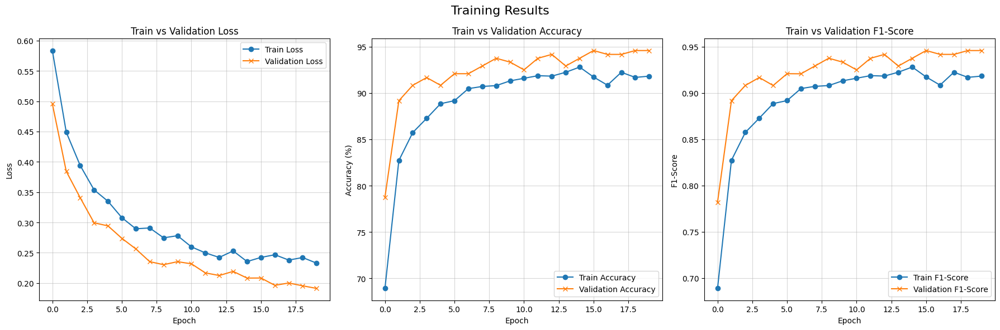

In [ ]:
plot_training_metrics(  # Call the plot_training_metrics function to visualize the training and validation metrics
    train_losses=metrics_ENet['train_losses'],  # Pass the training losses from the 'metrics_ENet' dictionary
    val_losses=metrics_ENet['val_losses'],  # Pass the validation losses from the 'metrics_ENet' dictionary
    train_accuracies=metrics_ENet['train_accuracies'],  # Pass the training accuracies from the 'metrics_ENet' dictionary
    val_accuracies=metrics_ENet['val_accuracies'],  # Pass the validation accuracies from the 'metrics_ENet' dictionary
    train_f1_scores=metrics_ENet['train_f1_scores'],  # Pass the training F1-scores from the 'metrics_ENet' dictionary
    val_f1_scores=metrics_ENet['val_f1_scores'],  # Pass the validation F1-scores from the 'metrics_ENet' dictionary
    title="Training Results"  # Set the title of the plot
)

**Observations:**

* Loss in both validation and train data converges, indicating that the model generalizes well and is not overfitting.
* Same interpretation is got from the accuracy and the F1-Score: both increase consistently and indicate robust generalization.

### **Visualize classifications**

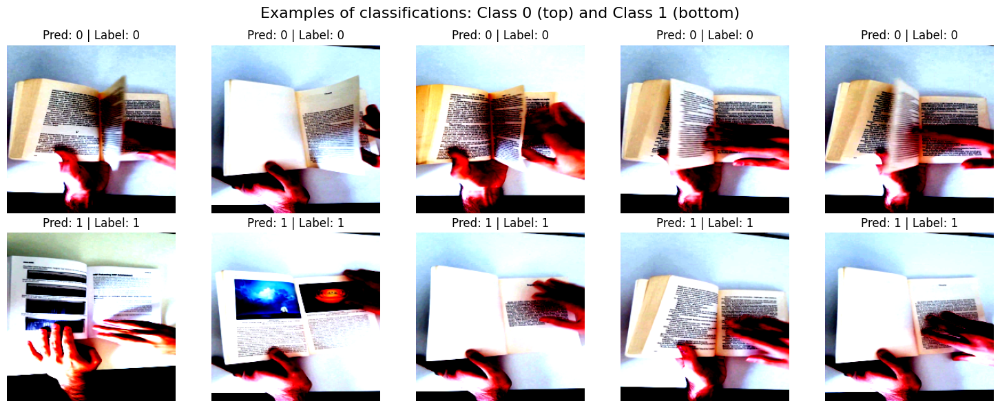

In [ ]:
visualize_predictions(
    model=model_ENet,         # Trained model
    data_loader=validation_loader,  # Validation DataLoader
    device=device,           # CPU/GPU
    num_examples=5           # Number of samples per class
)

**Observations:**

* There is a quality issue in the labels provided: by inspecting the samples, true class zero images involve pictures with flipping and non-flipping action.
* For the class one sample, although the images are labeled as flipping action, there is not such thing present on them.

### **Visualize Misclassifications**

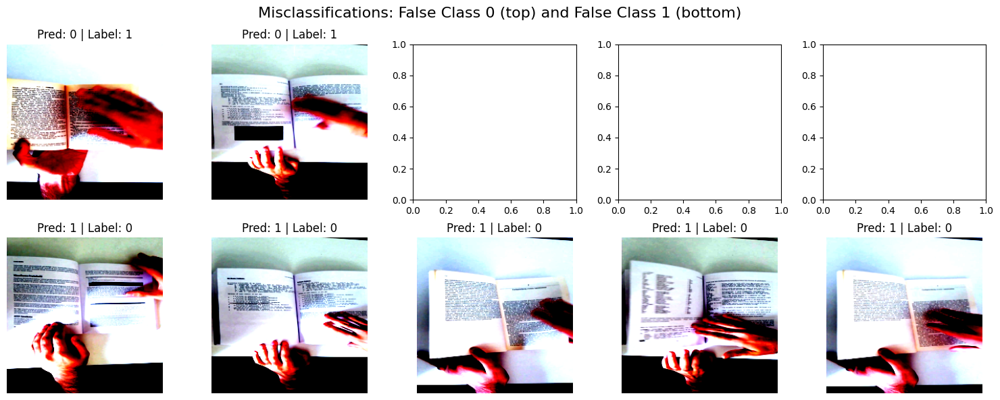

In [ ]:
visualize_misclassifications(
    model=model_ENet,         # Trained model
    data_loader=validation_loader,  # Validation DataLoader
    device=device,           # CPU/GPU
    num_examples=5           # Number of misclassified samples per class
)

**Observations:**

* Similarly, misclassification seems to be affected by the labeling quality issue.

## **MobileNet**

MobileNet is a deep learning model architecture designed for mobile and embedded vision applications, aiming to achieve a balance between high performance and low computational cost. It is built on a lightweight convolutional neural network (CNN) that uses depthwise separable convolutions, which significantly reduce the number of parameters and computations compared to traditional convolutions. This enables MobileNet to run efficiently on devices with limited computational resources, such as smartphones and IoT devices. MobileNet is particularly well-suited for tasks like image classification, object detection, and face recognition, offering a good trade-off between accuracy and computational efficiency. The architecture is available in various versions, such as MobileNetV1, V2, and V3, each improving on the previous version in terms of speed and accuracy, making it highly adaptable for real-time applications on mobile platforms.

Let's load a pre-trained MobileNet V2 model, which has been trained on the ImageNet dataset, excluding the final classification layer by setting include_top=False. This approach allows the model to be used for feature extraction, as it retains the learned convolutional layers that capture essential visual patterns from images but omits the final classification layer, which is typically used for specific tasks like categorizing images into predefined classes. By loading the model in this way, users can leverage the powerful feature extraction capabilities of MobileNet V2 and adapt it to different applications, such as transfer learning for custom tasks like object detection or image segmentation, while avoiding the constraints of a fixed classification output. The model's pre-trained weights help speed up convergence when fine-tuned for new tasks, offering a time-efficient solution with high accuracy.

In [ ]:
# Load the pre-trained MobileNet model from ImageNet, excluding the classification layer (include_top=False)
model_MobNet = mobilenet_v2(pretrained=True)  # Load MobileNet V2 with pre-trained weights from ImageNet

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V2_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/mobilenet_v2-b0353104.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-b0353104.pth
100%|██████████| 13.6M/13.6M [00:00<00:00, 240MB/s]


We will modify the pre-trained MobileNet V2 model to adapt it for a custom classification task with 2 output classes. Initially, the model is set up with a classifier layer that is designed for the default ImageNet classes, which may not match the requirements of the new task.

We set up num_classes to 2 (for example, for classes like "Flip" and "NotFlip") and replaces the final classifier layer (model_MobNet.classifier[1]) with a new nn.Linear layer that outputs the desired number of classes. This allows the model to perform classification according to the new task. Additionally, the code ensures that the model is transferred to the appropriate hardware (either GPU if available, or CPU). It uses the torch.device function to check if a GPU is available, and then moves the model to the selected device for efficient computation during training or inference. This process ensures the model is properly configured for the specific task and the hardware it is running on.

In [ ]:
# Modify the last layer to match the number of classes for your task (e.g., 2 classes)
num_classes = 2  # Set the number of classes (e.g., 2 classes: "Flip" and "NotFlip")
model_MobNet.classifier[1] = nn.Linear(model_MobNet.last_channel, num_classes)  # Change the classifier layer

# Move the model to GPU if available, otherwise use CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Check if GPU is available
model_MobNet = model_MobNet.to(device)  # Transfer the model to the selected device (GPU/CPU)

Here we freeze the initial layers of the MobileNet V2 model to prevent their parameters from being updated during training. The idea behind freezing the initial layers is to retain the feature representations that the model has already learned from its pre-training on the ImageNet dataset. These initial layers are responsible for capturing general features such as edges, textures, and shapes, which are applicable to many different tasks. By setting requires_grad = False for the parameters in the feature extractor layers (model_MobNet.features.parameters()), the gradients for these layers are not computed during backpropagation, meaning their weights will not be updated during training. This technique helps in reducing the computational load and prevents overfitting when training on smaller datasets, as it allows the model to focus on fine-tuning the final layers that are more specific to the new task.

In [ ]:
# Freezing the initial layers to prevent their parameters from being updated during training
# This helps retain the features learned from ImageNet during pre-training
for param in model_MobNet.features.parameters():  # Iterate over all parameters in the feature extractor layers
    param.requires_grad = False  # Set requires_grad to False to freeze the layers

Now we set up the loss function and the optimizer for training the MobileNet V2 model. First, we define the criterion_MobNet as nn.CrossEntropyLoss(), which is a commonly used loss function for multi-class classification tasks. CrossEntropyLoss computes the difference between the predicted class probabilities and the actual class labels, providing a measure of how well the model's predictions align with the true labels.

Next, we create the optimizer_MobNet using the Adam optimizer, which is a popular choice for training deep learning models due to its adaptive learning rate properties. The optimizer is initialized with the model's parameters (model_MobNet.parameters()) and a learning rate of 0.001. The Adam optimizer adjusts the learning rate for each parameter based on the first and second moments of the gradients, helping to improve convergence during training. This combination of CrossEntropyLoss and the Adam optimizer is commonly used for classification tasks, ensuring that the model learns effectively from the data.

In [ ]:
import torch.optim as optim  # Importing the optimizer module from PyTorch

criterion_MobNet = nn.CrossEntropyLoss()  # Loss function for multi-class classification (CrossEntropy)
optimizer_MobNet = optim.Adam(model_MobNet.parameters(), lr=0.001)  # Adam optimizer for training the model with a learning rate of 0.001

In this code, we set up the training configuration and early stopping mechanism for training the MobileNet V2 model. The variable num_epochs is set to 100, indicating that the model will train for up to 100 epochs unless early stopping criteria are met. The patience is defined as 20, which specifies that the training process will stop if there is no improvement in the validation performance for 20 consecutive epochs. This helps prevent overfitting and unnecessary training once the model has converged.

To implement early stopping, we create an EarlyStopping object called early_stopping_MobNet. This object monitors the validation performance during training and tracks whether there is an improvement. If there is no improvement in validation loss for 20 epochs, the training will halt, and the model will revert to the best version (i.e., the one that performed best on the validation set). The best model is saved to a file named 'checkpoint_MobNet.pth' for future use. Early stopping helps optimize training time and model generalization, preventing overfitting and saving computational resources.

In [ ]:
# Training Setup
num_epochs = 100  # Number of epochs to train the model
patience = 20  # Early stopping patience, training will stop if no improvement after 20 epochs
early_stopping_MobNet = EarlyStopping(patience=patience, verbose=True, path='checkpoint_MobNet.pth')
# EarlyStopping object to monitor validation performance and save the best model to 'checkpoint_MobNet.pth' if there is no improvement for 'patience' epochs.

Now, we invoke the train_with_early_stopping function to train the MobileNet V2 model with early stopping applied. The function takes several arguments, including the model (model_MobNet), data loaders for both the training (train_loader) and validation (validation_loader) datasets, the loss function (criterion_MobNet), the optimizer (optimizer_MobNet), and the hardware device (device) on which the model will run (either GPU or CPU). Additionally, the num_epochs parameter is set to 20, specifying the number of epochs for training, and the early_stopping argument is set to monitor the validation performance using the early_stopping_MobNet instance, which will stop training if there is no improvement after 20 epochs of monitoring.

The verbose=True argument ensures that the training process will display detailed information about the progress of training and validation, providing insights into how the model's performance evolves over time. After training is completed, the function returns metrics_MobNet, which contains the training and validation metrics collected during the training process. These metrics are then printed out to provide a comprehensive overview of the model's performance on both the training and validation datasets. This step helps assess the effectiveness of the model and the impact of early stopping on the training process.

In [ ]:
# Call the training function with early stopping
metrics_MobNet = train_with_early_stopping(  # Call the function to train the model with early stopping
    model=model_MobNet,  # The neural network model to train
    train_loader=train_loader,  # DataLoader for the training dataset
    validation_loader=validation_loader,  # DataLoader for the validation dataset
    criterion=criterion_MobNet,  # Loss function for computing training/validation losses
    optimizer=optimizer_MobNet,  # Optimizer to update the model parameters
    device=device,  # Hardware device for computation (e.g., GPU or CPU)
    num_epochs=20,  # Number of training epochs
    early_stopping=early_stopping_MobNet,  # EarlyStopping instance to monitor validation performance
    verbose=True,  # Enable verbose output during training
)

# Print final metrics
print("Training and validation metrics: ")  # Print a message indicating the metrics will be displayed
print(metrics_MobNet)  # Display the training and validation metrics collected during training

Epoch [1/20], Train Loss: 0.6040, Train Accuracy: 67.29%, Train F1-Score: 0.6729
Validation Loss: 0.5042, Validation Accuracy: 76.67%, Validation F1-Score: 0.7578
Validation F1-score improved (-inf --> 0.7578). Saving model...
Epoch [2/20], Train Loss: 0.4202, Train Accuracy: 85.41%, Train F1-Score: 0.8541
Validation Loss: 0.3863, Validation Accuracy: 86.67%, Validation F1-Score: 0.8660
Validation F1-score improved (0.7578 --> 0.8660). Saving model...
Epoch [3/20], Train Loss: 0.3688, Train Accuracy: 86.01%, Train F1-Score: 0.8601
Validation Loss: 0.3535, Validation Accuracy: 87.50%, Validation F1-Score: 0.8742
Validation F1-score improved (0.8660 --> 0.8742). Saving model...
Epoch [4/20], Train Loss: 0.3168, Train Accuracy: 89.54%, Train F1-Score: 0.8954
Validation Loss: 0.2960, Validation Accuracy: 94.17%, Validation F1-Score: 0.9417
Validation F1-score improved (0.8742 --> 0.9417). Saving model...
Epoch [5/20], Train Loss: 0.2884, Train Accuracy: 90.71%, Train F1-Score: 0.9071
Valid

<ipython-input-106-fed6c2288490>:140: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(early_stopping.path))


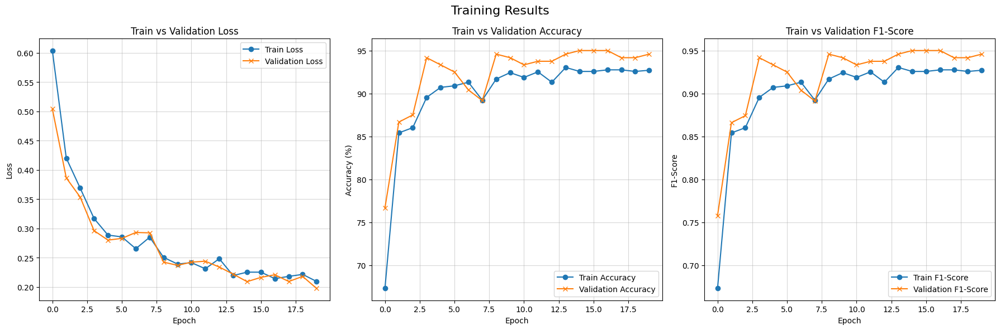

In [ ]:
# Plot the training and validation metrics
plot_training_metrics(
    train_losses=metrics_MobNet['train_losses'],  # Pass the training losses from the metrics dictionary
    val_losses=metrics_MobNet['val_losses'],  # Pass the validation losses from the metrics dictionary
    train_accuracies=metrics_MobNet['train_accuracies'],  # Pass the training accuracies from the metrics dictionary
    val_accuracies=metrics_MobNet['val_accuracies'],  # Pass the validation accuracies from the metrics dictionary
    train_f1_scores=metrics_MobNet['train_f1_scores'],  # Pass the training F1-scores from the metrics dictionary
    val_f1_scores=metrics_MobNet['val_f1_scores'],  # Pass the validation F1-scores from the metrics dictionary
    title="Training Results"  # Set the title for the plot
)

**Observations:**

* As we can see, the loss for both train and validation data converge to ~0.2 as epochs increase. The model is learning properly with no underfitting or overfitting.
* Accuracy and F1-score for validation data is slightly higher than the train data. That means that the model is learning properly with good fit.

### **Visualize Classifications**

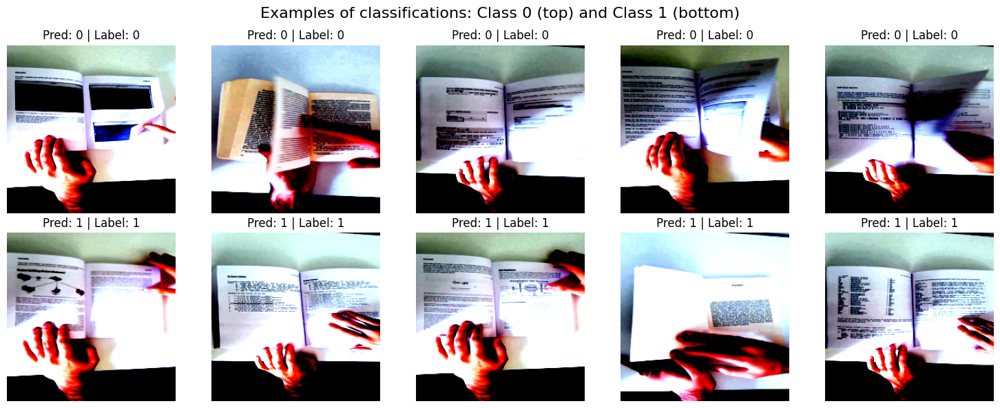

In [ ]:
visualize_predictions(
    model=model_MobNet,         # Modelo entrenado
    data_loader=validation_loader,  # DataLoader de validación o prueba
    device=device,           # CPU o GPU
    num_examples=5           # Número de ejemplos por clase
)

**Observations:**

* It is noticeable that the sample of true class zero images include a mislabeled image (second pic from left to right). That means there might be a quality issue in the labeling process.
* Since the sample of true class-one images seems not to include actual flipping actions, it is not obvious what the underlying features are that differentiate class zero from class one.

### **Visualize Misclassifications**

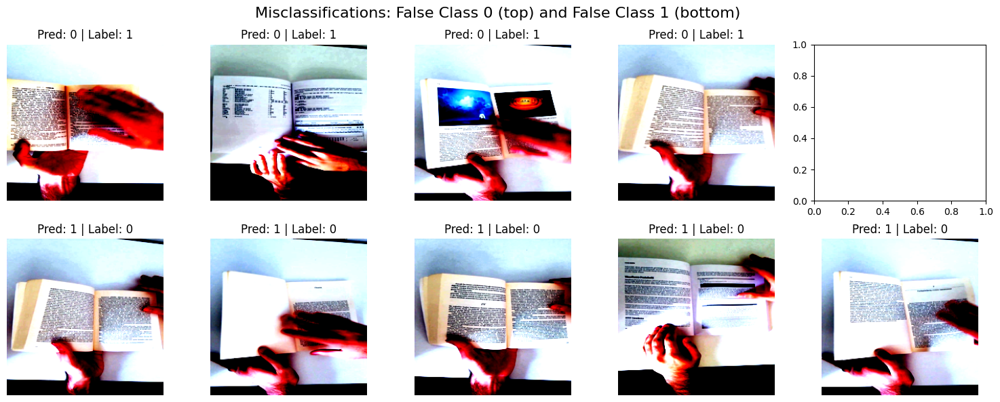

In [ ]:
# Visualize misclassifications
visualize_misclassifications(
    model=model_MobNet,         # Trained model to be evaluated
    data_loader=validation_loader,  # Validation or test DataLoader that provides the data
    device=device,           # The device on which the model is running (either CPU or GPU)
    num_examples=5           # Number of misclassified examples to display per class
)


**Observations:**

* In a similar fashion, misclassifications seem to be related to mislabeling issues.

Let's save the trained model:

In [ ]:
# Save the trained MobileNet model to a file
torch.save(model_MobNet.state_dict(), 'mobilenet_v2.pth')  # Save only the model's parameters (state_dict)

# Load the saved model parameters from the file
model_MobNet.load_state_dict(torch.load('mobilenet_v2.pth'))  # Load the saved parameters into the model

# Move the model to the appropriate device (CPU or GPU)
model_MobNet = model_MobNet.to(device)  # Ensure that the model is on the correct device (CPU/GPU)

<ipython-input-172-cd767e24ee22>:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_MobNet.load_state_dict(torch.load('mobilenet_v2.pth'))


## **Fine Tuning**

### **Transfer Learning and Its Relationship with Fine-Tuning**

Transfer learning is a machine learning technique that leverages a pre-trained model (trained on a related task) to solve a new problem. Instead of training a model from scratch, the knowledge or patterns learned by the pre-trained model are reused and adapted to the specific task. This significantly reduces the computational cost, training time, and data requirements.
For example: A model trained to classify general objects such as "dogs," "cats," and "cars" can be reused as the foundation for classifying specific objects, such as "dog breeds."

**Advantages of Transfer Learning:**

* Time and resource efficiency: No need to train a model from scratch, which is especially useful when resources are limited.
* Improved performance: Pre-trained models have already learned useful general features that can be adapted to the new task.
* Small data requirements: Works well with smaller datasets, as the model already has a strong "foundation.

* **What is Fine-Tuning?**

*Fine-tuning* is a specific process within transfer learning. It involves taking a pre-trained model and adapting it to a new, more specific task by adjusting its parameters. Fine-tuning typically includes:

1. **Freezing the initial layers:** These layers capture general features (e.g., edges, textures, shapes in image models) and don't need modification.
2. **Training the final layers:** The later layers, which are more task-specific, are updated to align with the new dataset and task.
3. **Updating the entire model:** In some cases, the entire model is fine-tuned, but with a lower learning rate to avoid overfitting.


*Transfer learning* refers to the overarching concept of reusing a pre-trained model for a new task. While *fine-tuning* is a specific step within transfer learning where the pre-trained model is further optimized or customized for the target problem.

### **Unfreezing base layers**

When using transfer learning, a common practice is to start by freezing the base layers of the pre-trained model. This ensures that the general features the model has learned (such as edges, textures, or basic shapes in image classification) remain unchanged while training the task-specific layers. However, for fine-tuning, the process is taken a step further by unfreezing some or all of the base layers to allow their weights to be updated during training. This is particularly useful when the new dataset has characteristics that differ significantly from the dataset used to pre-train the model.

In the code below, we unfreeze the feature extractor layers of a pre-trained model (model_ENet). This allows the model to refine its earlier learned representations based on the new dataset. To avoid drastic updates that might cause overfitting, we use a smaller learning rate for fine-tuning. This ensures that updates to the model's parameters are gradual and controlled, optimizing the model for the specific task without losing the valuable general knowledge it previously acquired.

In [ ]:
# Unfreeze base layers to allow them to be updated during fine-tuning
for param in model_ENet.features.parameters():  # Iterate over all parameters in the feature extractor layers
    param.requires_grad = True  # Set requires_grad to True to unfreeze the layers and allow them to be trained

# Change learning rate for fine-tuning the model
optimizer_FineTuning = optim.Adam(model_ENet.parameters(), lr=0.0001)  # Use a smaller learning rate for fine-tuning

In transfer learning, it is common to selectively unfreeze certain layers of a pre-trained model to allow fine-tuning on a new task. The earlier layers of a model like ResNet are typically responsible for extracting general features (e.g., edges, textures, and shapes) from the input data. These features are usually transferable across tasks, so it’s often beneficial to retain them unchanged. However, for fine-tuning, we may want to update some of these layers to better adapt the model to the specifics of the new dataset.
In the code below, the strategy is to unfreeze all layers of the pre-trained model except the fully connected layer (typically referred to as fc in ResNet models). This ensures that the general feature extraction capabilities of the earlier layers are preserved while allowing the task-specific final layer (fully connected) to be trained separately. By doing so, we strike a balance between retaining learned features from ImageNet and adapting the model to the new task.

In [ ]:
# ResNet
# Unfreezing initial layers to avoid updating during training, in order to retain features learned in ImageNet
for name, param in model_ENet.named_parameters():
    if "fc" not in name:  # Unfreeze all layers except the fully connected layer
        param.requires_grad = True

### **Training**

When fine-tuning a pre-trained model, it’s crucial to prevent overfitting, especially when working with smaller datasets or a limited number of epochs. One effective way to handle this is by implementing *early stopping*. *Early stopping* is a technique that monitors the model's performance on a validation dataset and halts training if the performance does not improve after a specified number of epochs (patience). This ensures that the model does not continue to train unnecessarily, which could lead to overfitting and a decline in generalization.

In the code below, *early stopping* is configured to monitor the model's validation performance using the *F1-Score*. The *EarlyStopping* instance is set with a patience of 5, meaning training will stop if the validation score does not improve for 5 consecutive epochs. Additionally, the best-performing model during training is saved to the file 'best_model_finetune.pth'. The *train_with_early_stopping* function integrates early stopping into the training loop, ensuring that the process is halted as soon as validation performance plateaus, saving both time and computational resources.

Finally, the training and validation metrics are printed to provide insights into the model's performance throughout the training process.

In [ ]:
# Configuring Early Stopping based on F1-Score
early_stopping_FineTuning = EarlyStopping(patience=5, verbose=True, path='best_model_finetune.pth')  # Early stopping with 5 epochs of patience and saving the best model

# Call the training function with early stopping
metrics_FineTuning = train_with_early_stopping(  # Call the function to train the model with early stopping
    model=model_ENet,  # The neural network model to train
    train_loader=train_loader,  # DataLoader for the training dataset
    validation_loader=validation_loader,  # DataLoader for the validation dataset
    criterion=criterion_ENet,  # Loss function for computing training/validation losses
    optimizer=optimizer_FineTuning,  # Optimizer to update the model parameters
    device=device,  # Hardware device for computation (e.g., GPU or CPU)
    num_epochs=20,  # Number of training epochs
    early_stopping=early_stopping_FineTuning,  # EarlyStopping instance to monitor validation performance
    verbose=True,  # Enable verbose output during training
)

# Print final metrics
print("Training and validation metrics: ")  # Print a message indicating the metrics will be displayed
print(metrics_FineTuning)  # Display the training and validation metrics collected during training

Epoch [1/20], Train Loss: 0.2150, Train Accuracy: 93.40%, Train F1-Score: 0.9340
Validation Loss: 0.1732, Validation Accuracy: 95.42%, Validation F1-Score: 0.9542
Validation F1-score improved (-inf --> 0.9542). Saving model...
Epoch [2/20], Train Loss: 0.1231, Train Accuracy: 95.96%, Train F1-Score: 0.9596
Validation Loss: 0.1699, Validation Accuracy: 96.67%, Validation F1-Score: 0.9667
Validation F1-score improved (0.9542 --> 0.9667). Saving model...
Epoch [3/20], Train Loss: 0.1018, Train Accuracy: 96.65%, Train F1-Score: 0.9665
Validation Loss: 0.1499, Validation Accuracy: 96.67%, Validation F1-Score: 0.9667
Validation F1-score improved (0.9667 --> 0.9667). Saving model...
Epoch [4/20], Train Loss: 0.0971, Train Accuracy: 97.17%, Train F1-Score: 0.9717
Validation Loss: 0.1835, Validation Accuracy: 96.25%, Validation F1-Score: 0.9625
EarlyStopping counter: 1 out of 5
Epoch [5/20], Train Loss: 0.0826, Train Accuracy: 97.17%, Train F1-Score: 0.9717
Validation Loss: 0.1638, Validation A

<ipython-input-106-fed6c2288490>:140: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(early_stopping.path))


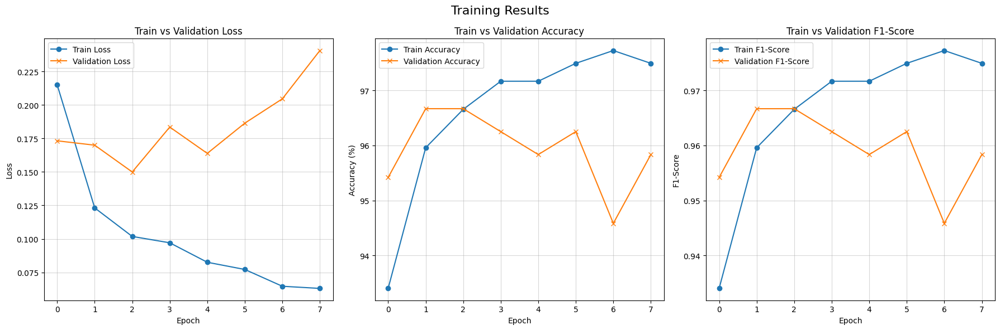

In [ ]:
# Plot the training and validation metrics (losses, accuracies, and F1-scores) after fine-tuning
plot_training_metrics(
    train_losses=metrics_FineTuning['train_losses'],  # Training loss values
    val_losses=metrics_FineTuning['val_losses'],  # Validation loss values
    train_accuracies=metrics_FineTuning['train_accuracies'],  # Training accuracy values
    val_accuracies=metrics_FineTuning['val_accuracies'],  # Validation accuracy values
    train_f1_scores=metrics_FineTuning['train_f1_scores'],  # Training F1 scores
    val_f1_scores=metrics_FineTuning['val_f1_scores'],  # Validation F1 scores
    title="Training Results"  # Title of the plot
)


**Observations:**

* The train loss is decreasing over time, however validation loss gets significantly higher, suggesting that overfitting might be occurring, not generalizing well.
* Training and validation accuracy seem to approach higher values in the first two epochs, however, after this point, training accuracy exceeds validation accuracy, suggesting overfitting.
* A similar trend can be seen in F1-score: as time increases, training F1-score exceeds validation values, suggesting overfitting.
* It is recommended to apply regularization techniques like dropout, L2 regularization, or data augmentation.


### **Visualize Classifications**

Let's perform a visual inspection of the results in the predictions:

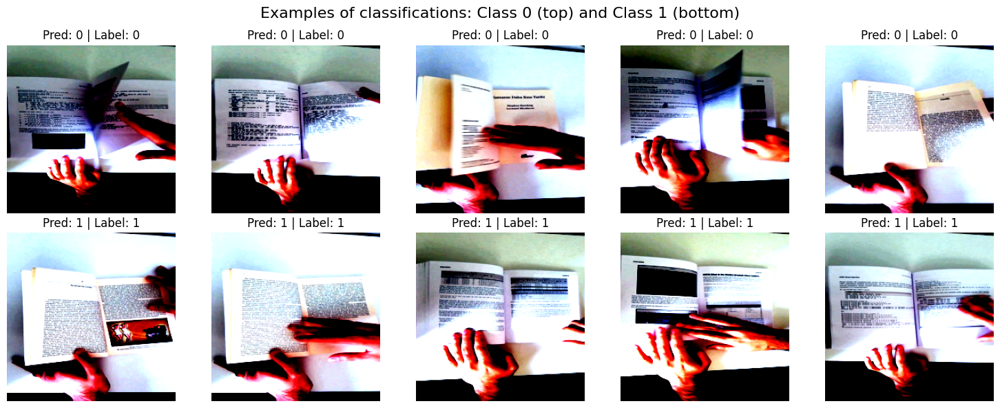

In [ ]:
# Visualize predictions for the validation set using the trained model
visualize_predictions(
    model=model_ENet,           # The trained model (EfficientNet)
    data_loader=validation_loader,  # DataLoader containing validation or test data
    device=device,              # Hardware device (either GPU or CPU)
    num_examples=5             # The number of examples to display per class
)

**Observations:**

* Labels seem to be incorrectly assigned in class 0 (*No Flip*) and class 1 (*Flip*). This might be a result of a poor labeling process.

### **Visualize Misclassifications**

Let's review a sample of missclassified images:

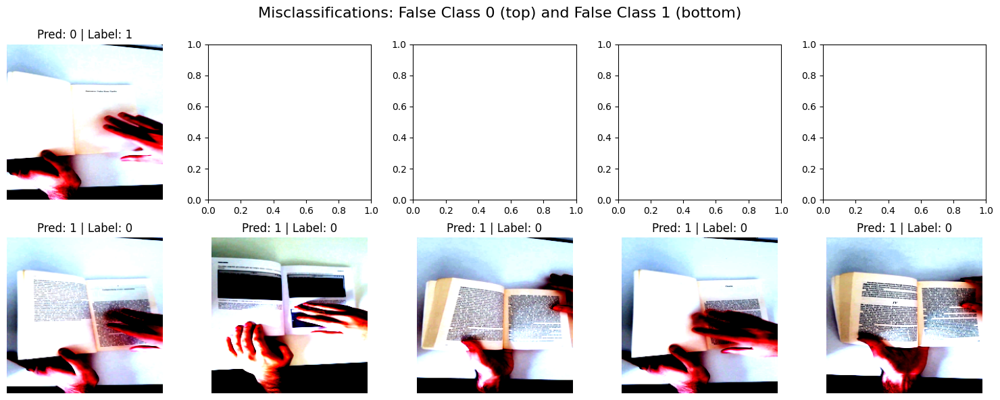

In [ ]:
# Visualize misclassifications for the validation set using the trained model
visualize_misclassifications(
    model=model_ENet,           # The trained model (EfficientNet)
    data_loader=validation_loader,  # DataLoader containing validation or test data
    device=device,              # Hardware device (either GPU or CPU)
    num_examples=5             # The number of misclassified examples to display per class
)

**Observations:**

* In class 0 (*FALSE No Flip*) we can see that the only missclassified image in fact presents a non-flipping action. That means that the label *1* of the image was incorrectly assigned.

* In class 1 (*FALSE Flip*) apparently none of the pictures match a flipping action. There are important information quality issues from the labeling process.

* Spanish
* Plot the misclassification of best performing model as an error analysis.
  (there might be a labeling issue in the data, it is important to include): Pick 5 -10 examples randomly from misclassified examples to VISUALIZE them and get a rationale for the mistake.
* Custom model, we need to know how to do it, play with CNN initially, see if I can improve the performance. Play with activations, more layers, etc. More importantly, to internalize how cnn work. Try to improve the base line for cnn.
* Once doing all these, instead of sequential, we are going to focus in a different direction. Take a book from my library and take a few pictures of the book with my camera from different pages (5 images). We will use (after doing all we discussed). We will use this images for OCR. Once we extract text from images, we are going to synthetize audio from them.

## **OCR and Audio Generation**

### **OCR with PyTesseract and Audio Generation with Google Text to Speech**

In this part of the project, we focus on two key components: Optical Character Recognition (OCR) using PyTesseract and Audio Generation using Google Text-to-Speech (gTTS). OCR technology enables the extraction of text from images, allowing us to convert scanned documents or photographs into editable, machine-readable text. PyTesseract, a Python wrapper for Google's Tesseract-OCR engine, provides an efficient way to perform this task. Once the text is extracted, we leverage Google’s Text-to-Speech (gTTS) to generate high-quality audio from the text, making the content accessible in an auditory format. This combination of OCR and speech synthesis allows for seamless conversion of visual content into both text and audio, enhancing accessibility and usability for various applications.

#### **PyTesseract**

The objective of this part of the project is to extract text from 5 sample images. For this purpose we will use *PyTesseract.*
Here we define the path where the sample images are located.

In [ ]:
# Path of folder in Google Drive
image_folder = '/content/drive/MyDrive/Apziva/Project 4/Girl_with_a_pearl_earring_fragment'

In this part we process images in a specified folder to extract text using PyTesseract OCR. The first step initializes an empty list data to store the results. It then iterates through all files in the folder, filtering out only the image files with extensions such as .png, .jpg, or .jpeg. For each image, it constructs the full path and opens the image using the Python Imaging Library (PIL). The image is displayed in grayscale for visualization, and a median filter is applied to reduce noise, improving the accuracy of the OCR process. PyTesseract is used to extract text from the image, which is then stored in the data list along with the file name. The extracted text is also printed for reference, providing feedback on the OCR process. Additionally, the code runs a second OCR extraction in English to ensure the text is accurately processed. Each iteration prints the extracted text and separates the results for clarity. This process enables batch OCR processing, allowing for the extraction of text from multiple image files efficiently.

Processing 'book_page-0001.jpg'...


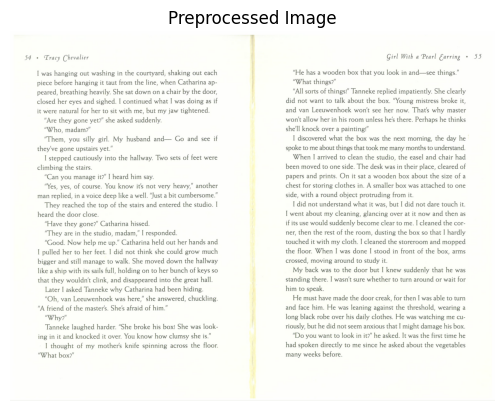

Extracted text from 'book_page-0001.jpg':
54 + Tracy Chevalier

I was hanging out washing in the courtyard, shaking out each
piece before hanging it taut from the line, when Catharina ap-
peared, breathing heavily. She sat down on a chair by the door,
closed her eyes and sighed. I continued what | was doing as if
it were natural for her to sit with me, but my jaw tightened.

“Are they gone yet?" she asked suddenly.

“Who, madam?"

“Them, you silly girl. My husband and— Go and see if
they've gone upstairs yet.”

I stepped cautiously into the hallway. Two sets of feet were
climbing the stairs.

“Can you manage it?” | heard him say.

“Yes, yes, of course. You know it's not very heavy,” another
man replied, in a voice deep like a well. “Just a bit cumbersome."

They reached the top of the stairs and entered the studio. |
heard the door close.

“Have they gone?” Catharina hissed.

“They are in the studio, madam,” | responded.

"Good. Now help me up.” Catharina held out her hands and
I pulle

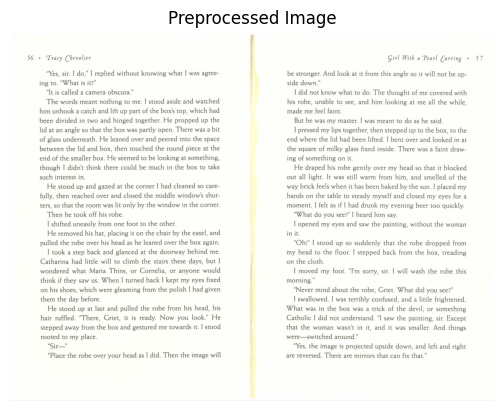

Extracted text from 'book_page-0002.jpg':
56 * Tracy Chevalier

"Yes, sir. | do," I replied without knowing what | was agree-
ing to. “What is it?”

"It is called a camera obscura.”

The words meant nothing to me. | stood aside and watched
him unhook a catch and lift up part of the box's top, which had
been divided in two and hinged together. He propped up the
lid at an angle so that the box was partly open. There was a bit
of glass underneath. He leaned over and peered into the space
between the lid and box, then touched the round piece at the
end of the smaller box. He seemed to be looking at something,
though | didn't think there could be much in the box to take
such interest in.

He stood up and gazed at the corner | had cleaned so care-
fully, then reached over and closed the middle window's shut-
ters, so that the room was lit only by the window in the corner.

Then he took off his robe.

I shifted uneasily from one foot to the other.

He removed his hat, placing it on the chair 

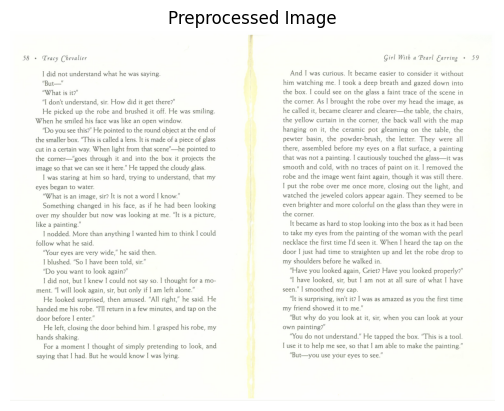

Extracted text from 'book_page-0003.jpg':
58

> Tracy Chevalier

I did not understand what he was saying.

“But—"

“What is it?”

“| don't understand, sir. How did it get there?"

He picked up the robe and brushed it off. He was smiling.
When he smiled his face was like an open window.

“Do you see this?” He pointed to the round object at the end of
the smaller box. “This is called a lens. It is made of a piece of glass
cut in a certain way. When light from that scene"—he pointed to
the corner—"goes through it and into the box it projects the
image so that we can see it here.” He tapped the cloudy glass.

I was staring at him so hard, trying to understand, that my
eyes began to water.

“What is an image, sir? It is not a word | know.”

Something changed in his face, as if he had been looking
over my shoulder but now was looking at me. “It is a picture,
like a painting.”

I nodded. More than anything I wanted him to think | could
follow what he said.

“Your eyes are very wide," he said 

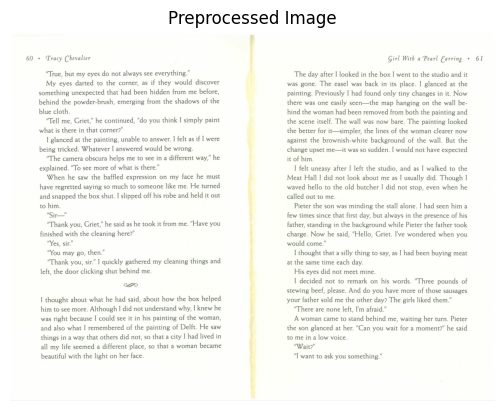

Extracted text from 'book_page-0004.jpg':
60 + Tracy (Chevalier

“True, but my eyes do not always see everything.”

My eyes darted to the corner, as if they would discover
something unexpected that had been hidden from me before,
behind the powder-brush, emerging from the shadows of the
blue cloth.

"Tell me, Griet,” he continued, “do you think I simply paint
what is there in that corner?”

I glanced at the painting, unable to answer. | felt as if | were
being tricked. Whatever I answered would be wrong.

“The camera obscura helps me to see in a different way,” he
explained. “To see more of what is there.”

When he saw the baffled expression on my face he must
have regretted saying so much to someone like me. He turned
and snapped the box shut. | slipped off his robe and held it out
to him.

“Sir—"

"Thank you, Griet,” he said as he took it from me. “Have you
finished with the cleaning here?"

“Yes, sir.”

“You may go, then.”

“Thank you, sir.” I quickly gathered my cleaning things and

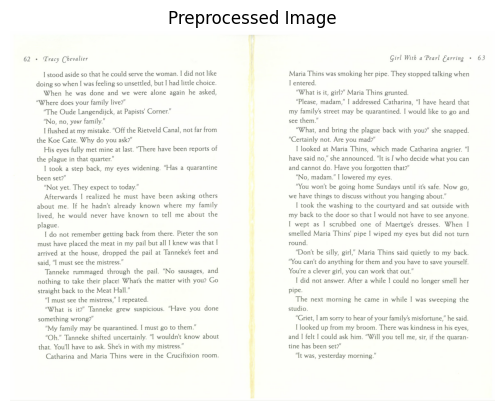

Extracted text from 'book_page-0005.jpg':
62 + Tracy (Chevalier

| stood aside so that he could serve the woman. | did not like
doing so when | was feeling so unsettled, but I had little choice.

When he was done and we were alone again he asked,
"Where does your family live?"

“The Oude Langendijck, at Papists’ Corner.”

“No, no, your family.”

I flushed at my mistake. “Off the Rietveld Canal, not far from
the Koe Gate. Why do you ask?"

His eyes fully met mine at last. “There have been reports of
the plague in that quarter.”

I took a step back, my eyes widening. “Has a quarantine
been set?"

“Not yet. They expect to today."

Afterwards | realized he must have been asking others
about me. If he hadn't already known where my family
lived, he would never have known to tell me about the
plague.

1 do not remember getting back from there. Pieter the son
must have placed the meat in my pail but all | knew was that |
arrived at the house, dropped the pail at Tanneke's feet and
said, “I mus

In [ ]:
data = []  # Initialize an empty list to store the processed data

# Process all images in folder
for file in os.listdir(image_folder):  # Loop through all files in the image folder
    if file.lower().endswith(('.png', '.jpg', '.jpeg')):  # Filter images by extension (PNG, JPG, JPEG)
        # Complete path of image
        image_path = os.path.join(image_folder, file)  # Join folder path with the image file name
        print(f"Processing '{file}'...")  # Print the file being processed

        # Load the image
        img = Image.open(image_path)  # Open the image using PIL

        plt.imshow(img, cmap='gray')  # Display the image in grayscale
        plt.title("Preprocessed Image")  # Set the title of the plot
        plt.axis('off')  # Hide axis for better visualization
        plt.show()  # Show the image plot

        # Apply a median filter to smooth the image and reduce noise
        img = img.filter(ImageFilter.MedianFilter())  # Apply median filter for noise reduction

        # Extract text from the image using Tesseract OCR
        text = pytesseract.image_to_string(img)  # Perform OCR and extract text

        # Append the file name and the extracted text to the data list
        data.append({"File Name": file, "Extracted Text": text})  # Store results in a dictionary

        # Extract text with Tesseract
        text = pytesseract.image_to_string(img, lang='eng')  # Re-run OCR for English language (default)

        # Add results to the list
        print(f"Extracted text from '{file}':\n{text}")  # Print the extracted text
        print('-' * 50)  # Print a separator for clarity


Let's configure the display options for pandas and processes the extracted data into a DataFrame. The line pd.set_option('display.max_colwidth', None) ensures that the text in any column of the DataFrame will be fully displayed without being truncated, which is particularly useful when working with long text data. Next, a DataFrame df is created from the previously collected data list, which contains the file names and the extracted text. The DataFrame is then sorted by the 'File Name' column in ascending order to organize the data for easier analysis. Finally, the df.head() function displays the first few rows of the DataFrame, allowing the user to quickly view a sample of the processed data. This setup provides a clear and organized representation of the extracted OCR results for further inspection or processing.

In [ ]:
pd.set_option('display.max_colwidth', None)  # Show all text in a column without truncating
df = pd.DataFrame(data)  # Create a DataFrame from the data list
df.sort_values(by = 'File Name', ascending = True, inplace = True)  # Sort the DataFrame by 'File Name' in ascending order
df.head()  # Display the first few records (by default, the first 5 rows)

,File Name,Extracted Text
0,book_page-0001.jpg,"54 + Tracy Chevalier\n\nI was hanging out washing in the courtyard, shaking out each\npiece before hanging it taut from the line, when Catharina ap-\npeared, breathing heavily. She sat down on a chair by the door,\nclosed her eyes and sighed. I continued what | was doing as if\nit were natural for her to sit with me, but my jaw tightened.\n\n“Are they gone yet?"" she asked suddenly.\n\n“Who, madam?""\n\n“Them, you silly girl. My husband and— Go and see if\nthey've gone upstairs yet.”\n\nI stepped cautiously into the hallway. Two sets of feet were\nclimbing the stairs.\n\n“Can you manage it?” | heard him say.\n\n“Yes, yes, of course. You know it's not very heavy,” another\nman replied, in a voice deep like a well. “Just a bit cumbersome.""\n\nThey reached the top of the stairs and entered the studio. |\nheard the door close.\n\n“Have they gone?” Catharina hissed.\n\n“They are in the studio, madam,” | responded.\n\n""Good. Now help me up.” Catharina held out her hands and\nI pulled her to her feet. | did not think she could grow much\nbigger and still manage to walk. She moved down the hallway\nlike a ship with its sails full, holding on to her bunch of keys so\nthat they wouldn't clink, and disappeared into the great hall.\n\nLater | asked Tanneke why Catharina had been hiding.\n\n“Oh, van Leeuwenhock was here,” she answered, chuckling.\n“A friend of the master's. She's afraid of him.”\n\n""Why?""\n\nTanneke laughed harder. “She broke his box! She was look-\ning in it and knocked it over. You know how clumsy she is.”\n\nI] thought of my mother's knife spinning across the floor.\n“What box?""\n\nGirl With a Pearl Carring\n\n“He has a wooden box that you look in and—see things.”\n\n“What things?”\n\n“All sorts of things!"" Tanneke replied impatiently. She clearly\ndid not want to talk about the box. “Young mistress broke it,\nand van Leeuwenhoek won't see her now. That's why master\nwon't allow her in his room unless he's there. Perhaps he thinks\nshe'll knock over a painting!”\n\nI discovered what the box was the next morning, the day he\nspoke to me about things that took me many months to understand.\n\nWhen I arrived to clean the studio, the easel and chair had\nbeen moved to one side. The desk was in their place, cleared of\npapers and prints. On it sat a wooden box about the size of a\nchest for storing clothes in. A smaller box was attached to one\nside, with a round object protruding from it.\n\nI did not understand what it was, but I did not dare touch it.\nI went about my cleaning, glancing over at it now and then as\nif its use would suddenly become clear to me. | cleaned the cor-\nner, then the rest of the room, dusting the box so that | hardly\ntouched it with my cloth. | cleaned the storeroom and mopped\nthe floor. When I was done | stood in front of the box, arms\ncrossed, moving around to study it.\n\nMy back was to the door but I knew suddenly that he was\nstanding there. | wasn't sure whether to turn around or wait for\nhim to speak.\n\nHe must have made the door creak, for then I was able to turn\nand face him. He was leaning against the threshold, wearing a\nlong black robe over his daily clothes. He was watching me cu-\nriously, but he did not seem anxious that | might damage his box.\n\n“Do you want to look in it?” he asked. It was the first time he\nhad spoken directly to me since he asked about the vegetables\nmany weeks before.\n"
1,book_page-0002.jpg,"56 * Tracy Chevalier\n\n""Yes, sir. | do,"" I replied without knowing what | was agree-\ning to. “What is it?”\n\n""It is called a camera obscura.”\n\nThe words meant nothing to me. | stood aside and watched\nhim unhook a catch and lift up part of the box's top, which had\nbeen divided in two and hinged together. He propped up the\nlid at an angle so that the box was partly open. There was a bit\nof glass underneath. He leaned over and peered into the space\nbetween the lid and box, then touched the round piec

This code snippet modifies the 'Extracted Text' column of a pandas DataFrame by applying a series of string replacement operations using the str.replace() method. Each replace() operation targets specific unwanted patterns or characters in the text, such as newlines, certain numbers, and specific names. For example, newline characters (\n) are removed, and special characters like the pipe symbol (|) are replaced with the letter "I". Additionally, specific phrases and numbers (such as "Girl With a Pearl Earring" and "Tracy Chevalier") are removed from the text.

While this approach allows for straightforward text cleaning, it has several limitations. First, it requires the manual specification of every unwanted pattern, which can become time-consuming and error-prone as the dataset grows or as new patterns emerge. Furthermore, handling complex grammar issues (such as subject-verb agreement or inconsistent punctuation) is not easily managed with simple string replacements.

Using a dedicated grammar correction library, such as LanguageTool or GingerSoftware, would provide several advantages over manual text manipulation. These libraries are designed to automatically detect and correct grammatical errors, typos, punctuation issues, and stylistic inconsistencies. They can handle more complex and nuanced language corrections, such as adjusting word choice or improving sentence structure. Moreover, these libraries typically come with features like real-time feedback and contextual understanding, which manual replacements cannot provide. They also save time, as the user does not have to manually list every possible pattern to clean. Ultimately, leveraging a grammar correction tool enhances the overall quality and accuracy of text processing, especially when dealing with diverse and unpredictable input data.

In [ ]:
df["Extracted Text"] = (  # Modify the 'Extracted Text' column in the DataFrame
    df["Extracted Text"]
    .str.replace("\n", "", regex=False)  # Replace newlines with an empty string
    .str.replace("|", "I", regex=False)  # Replace "|" with "I"
    .str.replace("\\'", "'", regex=False)  # Replace escaped single quotes (\\') with a normal single quote (')
    .str.replace("Girl With a Pearl Earring", "", regex=False)  # Remove the text "Girl With a Pearl Earring"
    .str.replace("+ Tracy Chevalier", "", regex=False)  # Remove the text "+ Tracy Chevalier"
    .str.replace("* Tracy Chevalier", "", regex=False)  # Remove the text "* Tracy Chevalier"
    .str.replace("+ Tracy (Chevalier", "", regex=False)  # Remove the text "+ Tracy (Chevalier"
    .str.replace("> Tracy Chevalier", "", regex=False)  # Remove the text "> Tracy Chevalier"
    .str.replace("54", "", regex=False)  # Remove the number "54"
    .str.replace("55", "", regex=False)  # Remove the number "55"
    .str.replace("56", "", regex=False)  # Remove the number "56"
    .str.replace("57", "", regex=False)  # Remove the number "57"
    .str.replace("58", "", regex=False)  # Remove the number "58"
    .str.replace("59", "", regex=False)  # Remove the number "59"
    .str.replace("60", "", regex=False)  # Remove the number "60"
    .str.replace("61", "", regex=False)  # Remove the number "61"
    .str.replace("62", "", regex=False)  # Remove the number "62"
    .str.replace("63", "", regex=False)  # Remove the number "63"
    .str.replace("D7", "", regex=False)  # Remove the text "D7"
)
df  # Display the modified DataFrame


,File Name,Extracted Text
0,book_page-0001.jpg,"I was hanging out washing in the courtyard, shaking out eachpiece before hanging it taut from the line, when Catharina ap-peared, breathing heavily. She sat down on a chair by the door,closed her eyes and sighed. I continued what I was doing as ifit were natural for her to sit with me, but my jaw tightened.“Are they gone yet?"" she asked suddenly.“Who, madam?""“Them, you silly girl. My husband and— Go and see ifthey've gone upstairs yet.”I stepped cautiously into the hallway. Two sets of feet wereclimbing the stairs.“Can you manage it?” I heard him say.“Yes, yes, of course. You know it's not very heavy,” anotherman replied, in a voice deep like a well. “Just a bit cumbersome.""They reached the top of the stairs and entered the studio. Iheard the door close.“Have they gone?” Catharina hissed.“They are in the studio, madam,” I responded.""Good. Now help me up.” Catharina held out her hands andI pulled her to her feet. I did not think she could grow muchbigger and still manage to walk. She moved down the hallwaylike a ship with its sails full, holding on to her bunch of keys sothat they wouldn't clink, and disappeared into the great hall.Later I asked Tanneke why Catharina had been hiding.“Oh, van Leeuwenhock was here,” she answered, chuckling.“A friend of the master's. She's afraid of him.”""Why?""Tanneke laughed harder. “She broke his box! She was look-ing in it and knocked it over. You know how clumsy she is.”I] thought of my mother's knife spinning across the floor.“What box?""Girl With a Pearl Carring“He has a wooden box that you look in and—see things.”“What things?”“All sorts of things!"" Tanneke replied impatiently. She clearlydid not want to talk about the box. “Young mistress broke it,and van Leeuwenhoek won't see her now. That's why masterwon't allow her in his room unless he's there. Perhaps he thinksshe'll knock over a painting!”I discovered what the box was the next morning, the day hespoke to me about things that took me many months to understand.When I arrived to clean the studio, the easel and chair hadbeen moved to one side. The desk was in their place, cleared ofpapers and prints. On it sat a wooden box about the size of achest for storing clothes in. A smaller box was attached to oneside, with a round object protruding from it.I did not understand what it was, but I did not dare touch it.I went about my cleaning, glancing over at it now and then asif its use would suddenly become clear to me. I cleaned the cor-ner, then the rest of the room, dusting the box so that I hardlytouched it with my cloth. I cleaned the storeroom and moppedthe floor. When I was done I stood in front of the box, armscrossed, moving around to study it.My back was to the door but I knew suddenly that he wasstanding there. I wasn't sure whether to turn around or wait forhim to speak.He must have made the door creak, for then I was able to turnand face him. He was leaning against the threshold, wearing along black robe over his daily clothes. He was watching me cu-riously, but he did not seem anxious that I might damage his box.“Do you want to look in it?” he asked. It was the first time hehad spoken directly to me since he asked about the vegetablesmany weeks before."
1,book_page-0002.jpg,"""Yes, sir. I do,"" I replied without knowing what I was agree-ing to. “What is it?”""It is called a camera obscura.”The words meant nothing to me. I stood aside and watchedhim unhook a catch and lift up part of the box's top, which hadbeen divided in two and hinged together. He propped up thelid at an angle so that the box was partly open. There was a bitof glass underneath. He leaned over and peered into the spacebetween the lid and box, then touched the round piece at theend of the smaller box. He seemed to be looking at something,though I didn't think there could be much in the box to takesuch interest in.He stood up and gazed at the corner I had cleaned so care-fully, then reached over and closed the 

We will save the DataFrame df to a CSV file named "extracted_texts.csv" using the to_csv() method. The index=False argument ensures that the DataFrame's index column is not included in the saved file, while the encoding="utf-8" argument ensures that the text is saved with UTF-8 encoding, which supports a wide range of characters and ensures compatibility across different platforms. After saving the file, the code prints a confirmation message to the console, notifying the user that the extracted texts have been successfully saved to the specified file. This operation is useful for storing processed data in a widely used format like CSV, which can easily be opened and analyzed using other tools such as spreadsheets or databases.

In [ ]:
df.to_csv("extracted_texts.csv", index=False, encoding="utf-8")  # Save the DataFrame to a CSV file without the index and with UTF-8 encoding
print("Extracted texts have been saved to 'extracted_texts.csv'.")  # Print a confirmation message that the text has been saved

Extracted texts have been saved to 'extracted_texts.csv'.


#### **Generating audio: Google Text to Speech**

This function, text_to_speech_gtts, converts a given text into audio using the *`Google Text-to-Speech (gTTS)`* library. The function takes two arguments: text, which is the string of text that will be converted to speech, and output_audio_file, which specifies the name of the output audio file (defaulting to "output.mp3"). Within the function, a gTTS object is created using the provided text, with the language set to English ('en') and a country-specific top-level domain (tld='co.uk' for a British accent). The slow=True parameter makes the speech slower for better clarity. After the conversion, the audio is saved to the specified file, and the function prints a message confirming the location where the audio file has been saved. This function is useful for converting text-based content into audio for accessibility or multimedia applications.

In [ ]:
def text_to_speech_gtts(text, output_audio_file="output.mp3"):
    """
    Converts text to audio using gTTS (Google Text-to-Speech).
    Args:
        text (str): The text to convert to audio.
        output_audio_file (str): The name of the output audio file (default is "output.mp3").
    """
    tts = gTTS(text, lang='en', tld='co.uk', slow=True)  # Create a gTTS object with the given text, language ('en'), and TLD (country-specific domain)
    tts.save(output_audio_file)  # Save the audio to the specified output file
    print(f"Audio file saved in: {output_audio_file}")  # Print the path of the saved audio file

Now let's iterate over each row in the DataFrame df using the iterrows() function, which provides both the index and the row data. For each row, it extracts the File Name and the Extracted Text columns. The File Name is used to create a custom name for the output audio file by removing the file extension and appending .mp3 (e.g., audio_sample.mp3). The extracted text from the Extracted Text column is then passed to the text_to_speech_gtts function, which converts the text into audio and saves it to the corresponding MP3 file. This process is repeated for all rows in the DataFrame, generating an audio file for each extracted text from the images. This approach ensures that each text is converted to audio and saved with a filename related to the source image.

In [ ]:
# Processes 'Extracted Text' column
for index, row in df.iterrows():
    file_name = row['File Name']  # Source file name
    text = row['Extracted Text']  # Extracted Text

    # Creates the name of the MP3 file based on the original file name
    output_audio_file = f"audio_{os.path.splitext(file_name)[0]}.mp3"

    # Convert text to audio
    text_to_speech_gtts(text, output_audio_file)

Audio file saved in: audio_book_page-0001.mp3
Audio file saved in: audio_book_page-0002.mp3
Audio file saved in: audio_book_page-0003.mp3
Audio file saved in: audio_book_page-0004.mp3
Audio file saved in: audio_book_page-0005.mp3


### **OCR with PaddleOCR**

While *Tesseract OCR*, particularly with its Python binding, *PyTesseract*, has been widely adopted for this purpose, modern OCR frameworks like *PaddleOCR* offer significant advantages in terms of performance, flexibility, and accuracy.

Motivation for Using PaddleOCR
PaddleOCR is part of the PaddlePaddle deep learning framework, which provides cutting-edge models optimized for OCR tasks. Its modular design allows for robust text detection, recognition, and even language-specific customization, enabling users to handle diverse and complex scenarios such as curved text, multilingual documents, and challenging lighting conditions.

**Accuracy and Robustness:**

PaddleOCR employs deep learning-based approaches, including attention mechanisms, which outperform the rule-based or hybrid models in PyTesseract for complex and non-standard text layouts.
It excels in multilingual and non-Latin script recognition.

**Ease of Fine-tuning:**

PaddleOCR allows users to fine-tune pre-trained models on specific datasets, significantly improving performance for domain-specific tasks.
Support for Advanced Features:

*Out-of-the-box* support for detecting curved text and irregular layouts, which often pose challenges for PyTesseract.
End-to-end pipelines for both detection and recognition, minimizing the need for manual intervention.
Performance:

PaddleOCR is optimized for GPU usage, making it faster and more scalable for high-volume OCR tasks compared to the CPU-centric nature of PyTesseract.

**Open-source and Actively Maintained:**

As part of the PaddlePaddle ecosystem, PaddleOCR benefits from regular updates, active community support, and integration with state-of-the-art research.
This document will guide the iteration over OCR text extraction workflows using PaddleOCR, demonstrating how it can improve the efficiency and accuracy of text processing tasks compared to PyTesseract.

https://pypi.org/project/paddleocr/2.4/

#### **Importing PaddleOCR, its utilities, Packaging and Processing**

* The PaddleOCR class is the core component of the PaddleOCR library, used for performing text detection and recognition.
* The draw_ocr function allows users to visualize OCR results by overlaying detected text regions and their corresponding content directly onto the image.
* These imports are used for packaging and distributing Python projects. While unrelated to OCR tasks, this inclusion suggests the code might be part of a larger project that requires bundling and distribution.
* OpenCV is a powerful library for image processing. Here, it might be used for pre-processing input images (e.g., resizing, denoising) before passing them to PaddleOCR or for post-processing the OCR results.

In [ ]:
import paddleocr  # Importing the paddleocr library for Optical Character Recognition (OCR)
from paddleocr import PaddleOCR, draw_ocr  # Importing PaddleOCR class for OCR and draw_ocr for drawing results on images
from setuptools import setup, find_packages  # Importing setuptools for packaging and distributing the Python project
import cv2  # Importing OpenCV library for image processing

This line initializes an instance of the PaddleOCR class with specific parameters for Optical Character Recognition (OCR) tasks:

* **`PaddleOCR:`** This is the main class provided by the PaddleOCR library for performing OCR. It integrates text detection, recognition, and optional classification into a single pipeline.

* **`use_angle_cls=True:`** This parameter enables the angle classification feature. Angle classification is crucial for detecting and correctly orienting text that is rotated or skewed. For example:

* **`Rotated signs:`** Text in irregular orientations (e.g., upside-down or diagonal). By setting this to True, the PaddleOCR model performs an additional step to classify the angle of detected text and adjust its orientation before recognition.

* **`lang='en':`** Specifies the language model to be used for text recognition. In this case, the language is set to English ('en'). PaddleOCR supports multiple languages, and selecting the appropriate language model ensures better recognition accuracy. For instance: 'ch' for Chinese, 'fr' for French, 'ar' for Arabic, etc.

In [ ]:
ocr = PaddleOCR(use_angle_cls=True, lang='en') # need to run only once to download and load model into memory

[2024/12/24 05:47:37] ppocr DEBUG: Namespace(help='==SUPPRESS==', use_gpu=False, use_xpu=False, use_npu=False, use_mlu=False, ir_optim=True, use_tensorrt=False, min_subgraph_size=15, precision='fp32', gpu_mem=500, gpu_id=0, image_dir=None, page_num=0, det_algorithm='DB', det_model_dir='/root/.paddleocr/whl/det/en/en_PP-OCRv3_det_infer', det_limit_side_len=960, det_limit_type='max', det_box_type='quad', det_db_thresh=0.3, det_db_box_thresh=0.6, det_db_unclip_ratio=1.5, max_batch_size=10, use_dilation=False, det_db_score_mode='fast', det_east_score_thresh=0.8, det_east_cover_thresh=0.1, det_east_nms_thresh=0.2, det_sast_score_thresh=0.5, det_sast_nms_thresh=0.2, det_pse_thresh=0, det_pse_box_thresh=0.85, det_pse_min_area=16, det_pse_scale=1, scales=[8, 16, 32], alpha=1.0, beta=1.0, fourier_degree=5, rec_algorithm='SVTR_LCNet', rec_model_dir='/root/.paddleocr/whl/rec/en/en_PP-OCRv4_rec_infer', rec_image_inverse=True, rec_image_shape='3, 48, 320', rec_batch_num=6, max_text_length=25, rec_c

In the following folder we will save the processed images:

In [ ]:
output_folder = "/content/drive/MyDrive/Apziva/Project 4/Processed_files"  # Folder to save processed images.

This script processes all images in a specified folder to extract and process text from documents using OCR (Optical Character Recognition). Below is a concise explanation of its workflow:

1. **`Initialize Variables:`** An empty list data is created to store OCR results and metadata for each image.
2. **`Process Images:** The script iterates over all images in the specified folder, filtering files by common image extensions (.png, .jpg, .jpeg).
3. **`Image Pre-processing:`** Each image is converted to grayscale for simplicity. Edge detection is applied using the Canny algorithm to identify text boundaries. The image is split vertically into two parts, simulating two pages of a document.

4. **`Save Processed Pages:`** Each split part (page) is saved as a separate image file in the output folder for further processing.

5. **`Display Processed Image:`** The original image is displayed for verification using Matplotlib.

6. **`OCR Execution:`** The two "pages" are processed using PaddleOCR to extract text. The OCR results contain text along with its detected position.

7. **`Text Extraction:`** Extracted text from each page is combined into a single string and stored along with the file name, page number, and processed image path in the data list.

8. **`Print Results:`** The script outputs the extracted text for both pages of each image, providing feedback on the OCR process.

The script produces:

* **`Extracted Text:`** Text data for each image, segmented by pages.
Metadata: Includes the file name, page number, and processed image path.
* **`Saved Images:`** Two-page splits of the original image saved in the output folder for reference.
* **`Visualization:`** Displays the processed images for manual verification.

Processing 'book_page-0001.jpg'...


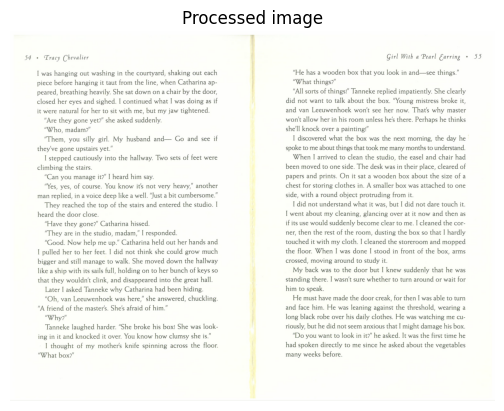

[2024/12/24 05:47:42] ppocr DEBUG: dt_boxes num : 32, elapsed : 0.14955854415893555
[2024/12/24 05:47:42] ppocr DEBUG: cls num  : 32, elapsed : 0.13926982879638672
[2024/12/24 05:47:45] ppocr DEBUG: rec_res num  : 32, elapsed : 3.036217451095581
[2024/12/24 05:47:45] ppocr DEBUG: dt_boxes num : 32, elapsed : 0.09200239181518555
[2024/12/24 05:47:45] ppocr DEBUG: cls num  : 32, elapsed : 0.07861447334289551
[2024/12/24 05:47:49] ppocr DEBUG: rec_res num  : 32, elapsed : 3.596297264099121
Text extracted from 'book_page-0001.jpg':
Page 1:
54 . Tracy Chevalier I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily. She sat down on a chair by the door, closed her eyes and sighed. I continued what I was doing as if it were natural for her to sit with me, but my jaw tightened. "Are they gone yet?" she asked suddenly. "Who, madam?". "Them, you silly girl. My husband and- Go and see if they've gone up

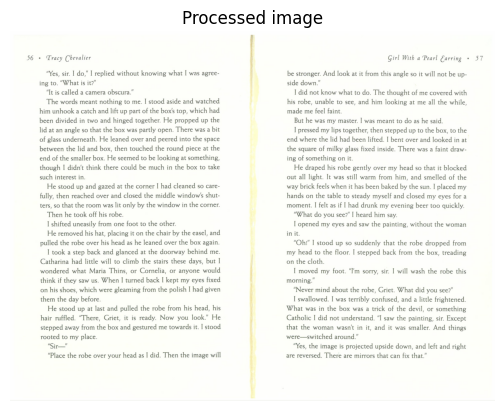

[2024/12/24 05:47:50] ppocr DEBUG: dt_boxes num : 32, elapsed : 0.09113001823425293
[2024/12/24 05:47:50] ppocr DEBUG: cls num  : 32, elapsed : 0.07401108741760254
[2024/12/24 05:47:53] ppocr DEBUG: rec_res num  : 32, elapsed : 3.216029644012451
[2024/12/24 05:47:53] ppocr DEBUG: dt_boxes num : 32, elapsed : 0.0889127254486084
[2024/12/24 05:47:53] ppocr DEBUG: cls num  : 32, elapsed : 0.06881976127624512
[2024/12/24 05:47:56] ppocr DEBUG: rec_res num  : 32, elapsed : 2.992605686187744
Text extracted from 'book_page-0002.jpg':
Page 1:
56 . Tracy Chevalier "Yes, sir. I do, I replied without knowing what I was agree ing to. "What is it?" "It is called a camera obscura.". The words meant nothing to me. I stood aside and watched him unhook a catch and lift up part of the box's top, which had been divided in two and hinged together. He propped up the lid at an angle so that the box was partly open. There was a bit of glass underneath. He leaned over and peered into the space between the lid

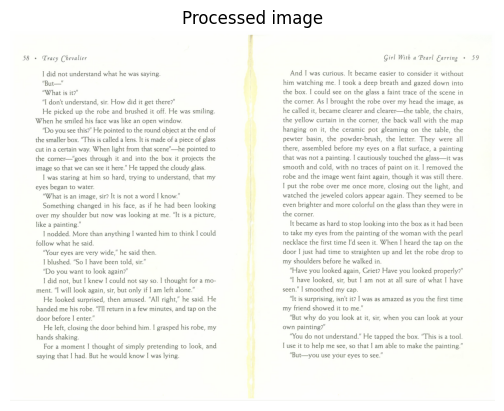

[2024/12/24 05:47:57] ppocr DEBUG: dt_boxes num : 32, elapsed : 0.09965038299560547
[2024/12/24 05:47:57] ppocr DEBUG: cls num  : 32, elapsed : 0.07399272918701172
[2024/12/24 05:48:00] ppocr DEBUG: rec_res num  : 32, elapsed : 2.904979944229126
[2024/12/24 05:48:00] ppocr DEBUG: dt_boxes num : 32, elapsed : 0.08667206764221191
[2024/12/24 05:48:01] ppocr DEBUG: cls num  : 32, elapsed : 0.07582807540893555
[2024/12/24 05:48:04] ppocr DEBUG: rec_res num  : 32, elapsed : 3.549731731414795
Text extracted from 'book_page-0003.jpg':
Page 1:
58 . Tracy Chevalier I did not understand what he was saying "But-" "What is it?". "I don't understand, sir. How did it get there?". He picked up the robe and brushed it off. He was smiling When he smiled his face was like an open window. "Do you see this?" He pointed to the round object at the end of the smaller box."This is called a lens.It is made of a piece of glass cut in a certain way. When light from that scene"-he pointed to. the corner-"goes thr

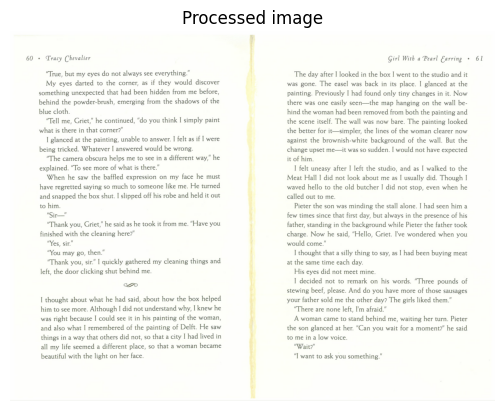

[2024/12/24 05:48:05] ppocr DEBUG: dt_boxes num : 30, elapsed : 0.08279824256896973
[2024/12/24 05:48:05] ppocr DEBUG: cls num  : 30, elapsed : 0.0598907470703125
[2024/12/24 05:48:08] ppocr DEBUG: rec_res num  : 30, elapsed : 2.4438669681549072
[2024/12/24 05:48:08] ppocr DEBUG: dt_boxes num : 32, elapsed : 0.08502721786499023
[2024/12/24 05:48:08] ppocr DEBUG: cls num  : 32, elapsed : 0.07205677032470703
[2024/12/24 05:48:11] ppocr DEBUG: rec_res num  : 32, elapsed : 3.0519909858703613
Text extracted from 'book_page-0004.jpg':
Page 1:
60 . Tracy Chevalier "True, but my eyes do not always see everything." My eyes darted to the corner, as if they would discover something unexpected that had been hidden from me before. behind the powder-brush, emerging from the shadows of the blue cloth. "Tell me, Griet," he continued, "do you think I simply paint what is there in that corner?". I glanced at the painting, unable to answer. I felt as if I were being tricked. Whatever I answered would be 

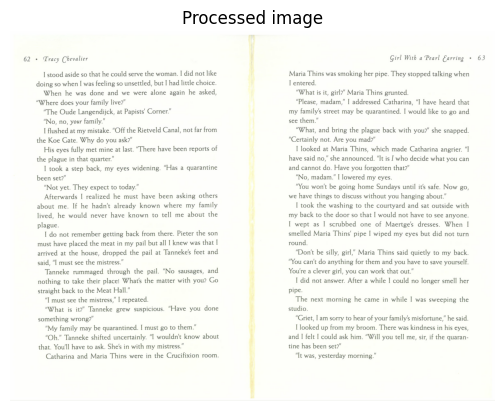

[2024/12/24 05:48:12] ppocr DEBUG: dt_boxes num : 32, elapsed : 0.09656643867492676
[2024/12/24 05:48:12] ppocr DEBUG: cls num  : 32, elapsed : 0.07935261726379395
[2024/12/24 05:48:15] ppocr DEBUG: rec_res num  : 32, elapsed : 2.8532235622406006
[2024/12/24 05:48:15] ppocr DEBUG: dt_boxes num : 32, elapsed : 0.11559343338012695
[2024/12/24 05:48:15] ppocr DEBUG: cls num  : 32, elapsed : 0.08860492706298828
[2024/12/24 05:48:18] ppocr DEBUG: rec_res num  : 32, elapsed : 2.9394304752349854
Text extracted from 'book_page-0005.jpg':
Page 1:
62 . Tracy Chevalier I stood aside so that he could serve the woman. I did not like doing so when I was feeling so unsettled, but I had little choice. When he was done and we were alone again he asked, "Where does your family live?" "The Oude Langendijck, at Papists' Corner.". "No, no, your family." I flushed at my mistake. "Off the Rietveld Canal, not far from the Koe Gate. Why do you ask?" His eyes fully met mine at last. "There have been reports of 

In [ ]:
data = []  # Initialize an empty list to store extracted data from images

# Process all images in folder
for file in os.listdir(image_folder):  # Loop through all files in the folder
    if file.lower().endswith(('.png', '.jpg', '.jpeg')):  # Filter files by extension (png, jpg, jpeg)
        # Complete path of image
        image_path = os.path.join(image_folder, file)  # Get the full path of the image file
        print(f"Processing '{file}'...")  # Print the file name being processed

        # Load the image
        image = cv2.imread(image_path)  # Read the image using OpenCV

        # Convert to gray scale
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)  # Convert the image to grayscale

        # Apply edges detection
        edges = cv2.Canny(gray, 50, 150)  # Perform edge detection using the Canny algorithm

        # Find contours
        contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)  # Find contours in the image

        # Identify two pages according to position
        height, width = gray.shape  # Get the dimensions of the image
        mid_x = width // 2  # Split in two halves (vertical split)

        # Cut the images in 2 pages
        page1 = image[:, :mid_x]  # Left part of the image
        page2 = image[:, mid_x:]  # Right part of the image

        # Save the separate pages in the output folder
        page1_path = os.path.join(output_folder, f"{os.path.splitext(file)[0]}_page1.jpg")  # Path for page 1
        page2_path = os.path.join(output_folder, f"{os.path.splitext(file)[0]}_page2.jpg")  # Path for page 2
        cv2.imwrite(page1_path, page1)  # Save page 1 to disk
        cv2.imwrite(page2_path, page2)  # Save page 2 to disk

        # Show the processed image
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Convert to RGB for correct visualization in matplotlib
        plt.title("Processed image")  # Display title
        plt.axis('off')  # Hide axes
        plt.show()  # Show the image

        # Perform OCR on the image
        result_page1 = ocr.ocr(page1_path, det=True, cls=True)  # OCR on page 1
        result_page2 = ocr.ocr(page2_path, det=True, cls=True)  # OCR on page 2

        # List to store text per page
        extracted_pages = []  # Initialize list for storing extracted text for each page

        # Extract text per page (using result_page1 and result_page2)
        for i, page in enumerate([result_page1, result_page2]):  # Iterate over pages (page1, page2)
            page_text = []  # Store text of current page

            for line in page[0]:  # Lines are in page[0]
                if len(line) > 1 and isinstance(line[1], tuple):  # Validate structure of OCR result
                    page_text.append(line[1][0])  # Extract text from line

            # Combine text of page in a single string
            page_text_combined = " ".join(page_text)  # Join text of the page into a single string
            extracted_pages.append({"Page Number": i + 1, "Extracted Text": page_text_combined})  # Store extracted text for the page

        # Extract text of each page and add it to records
        for i, (result, page_path) in enumerate([(result_page1, page1_path), (result_page2, page2_path)], start=1):  # Loop over page results
            page_text = [line[1][0] for line in result[0] if len(line) > 1]  # Extract text from the OCR result
            data.append({  # Append the data to the list
                "File Name": file,  # File name
                "Page Number": i,  # Page number (1 or 2)
                "Extracted Text": " ".join(page_text),  # Combined extracted text
                "Processed File Path": page_path  # Path to the processed image
            })

        print(f"Text extracted from '{file}':")  # Print the extracted text for the file
        print(f"Page 1:\n{' '.join([line[1][0] for line in result_page1[0]])}")  # Print text from page 1
        print(f"Page 2:\n{' '.join([line[1][0] for line in result_page2[0]])}")  # Print text from page 2
        print('-' * 50)  # Separator for readability


Let's show the resulting dataframe:

In [ ]:
df = pd.DataFrame(data)  # Create a DataFrame from the 'data' list
# Show the DataFrame
pd.set_option('display.max_colwidth', None)  # Set pandas option to display the full content of each column without truncation
df  # Display the DataFrame

,File Name,Page Number,Extracted Text,Processed File Path
0,book_page-0001.jpg,1,"54 . Tracy Chevalier I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily. She sat down on a chair by the door, closed her eyes and sighed. I continued what I was doing as if it were natural for her to sit with me, but my jaw tightened. ""Are they gone yet?"" she asked suddenly. ""Who, madam?"". ""Them, you silly girl. My husband and- Go and see if they've gone upstairs yet."" I stepped cautiously into the hallway. Two sets of feet were climbing the stairs.. ""Can you manage it?"" I heard him say ""Yes, yes, of course. You know it's not very heavy"" another man replied, in a voice deep like a well. ""Just a bit cumbersome. They reached the top of the stairs and entered the studio. I heard the door close. ""Have they gone?"" Catharina hissed. ""They are in the studio, madam"" I responded. ""Good. Now help me up."" Catharina held out her hands and I pulled her to her feet. I did not think she could grow much bigger and still manage to walk. She moved down the hallway like a ship with its sails full, holding on to her bunch of keys so that they wouldn't clink, and disappeared into the great hall. Later I asked Tanneke why Catharina had been hiding ""Oh, van Leeuwenhoek was here,"" she answered, chuckling ""A friend of the master's. She's afraid of him."" ""Why?"" Tanneke laughed harder. ""She broke his box! She was look ing in it and knocked it over. You know how clumsy she is."" I thought of my mother's knife spinning across the floor.. ""What box?"".",/content/drive/MyDrive/Apziva/Project 4/Processed_files/book_page-0001_page1.jpg
1,book_page-0001.jpg,2,"Girl With a Pearl Carring 55 ""He has a wooden box that you look in and--see things."". ""What things?"" ""All sorts of things!"" Tanneke replied impatiently. She clearly. did not want to talk about the box. ""Young mistress broke it, and van Leeuwenhoek won't see her now. That's why master won't allow her in his room unless he's there. Perhaps he thinks she'll knock over a painting!"" I discovered what the box was the next morning, the day he spoke to me about things that took me many months to understand When I arrived to clean the studio, the easel and chair had been moved to one side. The desk was in their place, cleared of. papers and prints. On it sat a wooden box about the size of a chest for storing clothes in. A smaller box was attached to one side, with a round object protruding from it. I did not understand what it was, but I did not dare touch it. I went about my cleaning, glancing over at it now and then as if its use would suddenly become clear to me. I cleaned the cor ner, then the rest of the room, dusting the box so that I hardly touched it with my cloth. I cleaned the storeroom and mopped the floor. When I was done I stood in front of the box, arms. crossed, moving around to study it. My back was to the door but I knew suddenly that he was. standing there.I wasn't sure whether to turn around or wait for him to speak. He must have made the door creak, for then I was able to turn and face him. He was leaning against the threshold, wearing a long black robe over his daily clothes. He was watching me cu- riously, but he did not seem anxious that I might damage his box. ""Do you want to look in it?"" he asked. It was the first time he had spoken directly to me since he asked about the vegetables many weeks before.",/content/drive/MyDrive/Apziva/Project 4/Processed_files/book_page-0001_page2.jpg
2,book_page-0002.jpg,1,"56 . Tracy Chevalier ""Yes, sir. I do, I replied without knowing what I was agree ing to. ""What is it?"" ""It is called a camera obscura."". The words meant nothing to me. I stood aside and watched him unhook a catch and lift up part of the box's top, which had been divided in two and hinged together. He propped up the lid at an angle so that the box was partly open. There w


This code initializes and configures the SaT (Sentence and Token Splitter) model from the wtpsplit library, designed for efficient sentence segmentation and tokenization. It uses the pre-trained model "sat-3l-sm", optimized for English text processing in the Universal Dependencies (UD) linguistic annotation style. The model is further enhanced by leveraging GPU acceleration: it is converted to half precision (FP16) using sat.half() to reduce memory usage and speed up inference, and then moved to the GPU with sat.to("cuda"). Additionally, the comments indicate support for TPU execution by transferring the model to a TPU device and enabling batch padding if needed. This setup is particularly useful for natural language processing (NLP) tasks such as preparing text for machine learning models, parsing linguistic data, or pre-processing text for tasks like sentiment analysis or machine translation.

https://github.com/segment-any-text/wtpsplit
segment-any-text/sat-12l-sm

In [ ]:
from wtpsplit import SaT  # Import the SaT (Sentence and Token Splitter) class from the 'wtpsplit' library
sat = SaT("sat-3l-sm", style_or_domain="ud", language="en")  # Initialize the SaT model with the 'sat-3l-sm' model, for English language sentence segmentation in Universal Dependencies (ud) style
# optionally run on GPU for better performance
# also supports TPUs via e.g. sat.to("xla:0"), in that case pass `pad_last_batch=True` to sat.split
sat.half().to("cuda")  # Convert the model to half precision (FP16) for faster inference and move the model to the GPU (CUDA device)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


LoRA ud/en not found, using base model...


SubwordXLMForTokenClassification(
  (roberta): SubwordXLMRobertaModel(
    (embeddings): XLMRobertaEmbeddings(
      (word_embeddings): Embedding(250002, 768, padding_idx=1)
      (position_embeddings): Embedding(514, 768, padding_idx=1)
      (token_type_embeddings): Embedding(1, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): SubwordXLMRobertaEncoder(
      (layer): ModuleList(
        (0-2): 3 x XLMRobertaLayer(
          (attention): XLMRobertaAttention(
            (self): XLMRobertaSdpaSelfAttentionWithAdapters(
              (query): LoRALinearTorch(
                in_features=768, out_features=768, bias=True
                (loras): ModuleDict()
              )
              (key): LoRALinearTorch(
                in_features=768, out_features=768, bias=True
                (loras): ModuleDict()
              )
              (value): LoRALinearTorch(
                in_features=76

Here we'll apply sentence segmentation to each row of the dataframe:

In [ ]:
df['Split Results'] =  df['Extracted Text'].apply(lambda text: sat.split(text, threshold=0.4))  # Apply sentence segmentation to each row of 'Extracted Text' using the SaT model, and store the results in a new column 'Split Results'


,File Name,Page Number,Extracted Text,Processed File Path,Split Results
0,book_page-0001.jpg,1,"54 . Tracy Chevalier I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily. She sat down on a chair by the door, closed her eyes and sighed. I continued what I was doing as if it were natural for her to sit with me, but my jaw tightened. ""Are they gone yet?"" she asked suddenly. ""Who, madam?"". ""Them, you silly girl. My husband and- Go and see if they've gone upstairs yet."" I stepped cautiously into the hallway. Two sets of feet were climbing the stairs.. ""Can you manage it?"" I heard him say ""Yes, yes, of course. You know it's not very heavy"" another man replied, in a voice deep like a well. ""Just a bit cumbersome. They reached the top of the stairs and entered the studio. I heard the door close. ""Have they gone?"" Catharina hissed. ""They are in the studio, madam"" I responded. ""Good. Now help me up."" Catharina held out her hands and I pulled her to her feet. I did not think she could grow much bigger and still manage to walk. She moved down the hallway like a ship with its sails full, holding on to her bunch of keys so that they wouldn't clink, and disappeared into the great hall. Later I asked Tanneke why Catharina had been hiding ""Oh, van Leeuwenhoek was here,"" she answered, chuckling ""A friend of the master's. She's afraid of him."" ""Why?"" Tanneke laughed harder. ""She broke his box! She was look ing in it and knocked it over. You know how clumsy she is."" I thought of my mother's knife spinning across the floor.. ""What box?"".",/content/drive/MyDrive/Apziva/Project 4/Processed_files/book_page-0001_page1.jpg,"[54 . Tracy Chevalier , I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily. , She sat down on a chair by the door, closed her eyes and sighed. , I continued what I was doing as if it were natural for her to sit with me, but my jaw tightened. , ""Are they gone yet?"" she asked suddenly. , ""Who, madam?"". , ""Them, you silly girl. , My husband and- Go and see if they've gone upstairs yet."" , I stepped cautiously into the hallway. , Two sets of feet were climbing the stairs.. , ""Can you manage it?"" , I heard him say ""Yes, yes, of course. , You know it's not very heavy"" another man replied, in a voice deep like a well. , ""Just a bit cumbersome. , They reached the top of the stairs and entered the studio. , I heard the door close. , ""Have they gone?"" , Catharina hissed. , ""They are in the studio, madam"" I responded. , ""Good. , Now help me up."" , Catharina held out her hands and I pulled her to her feet. , I did not think she could grow much bigger and still manage to walk. , She moved down the hallway like a ship with its sails full, holding on to her bunch of keys so that they wouldn't clink, and disappeared into the great hall. , Later I asked Tanneke why Catharina had been hiding ""Oh, van Leeuwenhoek was here,"" she answered, chuckling ""A friend of the master's. , She's afraid of him."" , ""Why?"" , Tanneke laughed harder. , ""She broke his box! , She was look ing in it and knocked it over. , You know how clumsy she is."" , I thought of my mother's knife spinning across the floor.. , ""What box?"".]"
1,book_page-0001.jpg,2,"Girl With a Pearl Carring 55 ""He has a wooden box that you look in and--see things."". ""What things?"" ""All sorts of things!"" Tanneke replied impatiently. She clearly. did not want to talk about the box. ""Young mistress broke it, and van Leeuwenhoek won't see her now. That's why master won't allow her in his room unless he's there. Perhaps he thinks she'll knock over a painting!"" I discovered what the box was the next morning, the day he spoke to me about things that took me many months to understand When I arrived to clean the studio, the easel and chair had been moved to on

his line of code restructures a DataFrame by transforming a column containing lists into separate rows, ensuring each element of the list gets its own row while keeping the rest of the data intact. Specifically, the explode method is applied to the column named 'Split Results', which presumably contains lists of split sentences or tokens. By exploding this column, each sentence or token becomes an individual row in the DataFrame. The reset_index(drop=True) method resets the index after this operation, discarding the old index and creating a clean, sequential index. This transformation is particularly useful for tasks where sentence-level or token-level analysis is required, as it allows for efficient iteration and processing of individual elements in a structured format. After this operation, the updated DataFrame df_exploded contains one sentence or token per row, enabling easier data manipulation and further analysis.

In [ ]:
df_exploded = df.explode('Split Results').reset_index(drop=True)  # Explode the 'Split Results' column so each sentence becomes a separate row; reset the index without keeping the old one
df_exploded

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,File Name,Page Number,Extracted Text,Processed File Path,Split Results
0,book_page-0001.jpg,1,"54 . Tracy Chevalier I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily. She sat down on a chair by the door, closed her eyes and sighed. I continued what I was doing as if it were natural for her to sit with me, but my jaw tightened. ""Are they gone yet?"" she asked suddenly. ""Who, madam?"". ""Them, you silly girl. My husband and- Go and see if they've gone upstairs yet."" I stepped cautiously into the hallway. Two sets of feet were climbing the stairs.. ""Can you manage it?"" I heard him say ""Yes, yes, of course. You know it's not very heavy"" another man replied, in a voice deep like a well. ""Just a bit cumbersome. They reached the top of the stairs and entered the studio. I heard the door close. ""Have they gone?"" Catharina hissed. ""They are in the studio, madam"" I responded. ""Good. Now help me up."" Catharina held out her hands and I pulled her to her feet. I did not think she could grow much bigger and still manage to walk. She moved down the hallway like a ship with its sails full, holding on to her bunch of keys so that they wouldn't clink, and disappeared into the great hall. Later I asked Tanneke why Catharina had been hiding ""Oh, van Leeuwenhoek was here,"" she answered, chuckling ""A friend of the master's. She's afraid of him."" ""Why?"" Tanneke laughed harder. ""She broke his box! She was look ing in it and knocked it over. You know how clumsy she is."" I thought of my mother's knife spinning across the floor.. ""What box?"".",/content/drive/MyDrive/Apziva/Project 4/Processed_files/book_page-0001_page1.jpg,54 . Tracy Chevalier
1,book_page-0001.jpg,1,"54 . Tracy Chevalier I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily. She sat down on a chair by the door, closed her eyes and sighed. I continued what I was doing as if it were natural for her to sit with me, but my jaw tightened. ""Are they gone yet?"" she asked suddenly. ""Who, madam?"". ""Them, you silly girl. My husband and- Go and see if they've gone upstairs yet."" I stepped cautiously into the hallway. Two sets of feet were climbing the stairs.. ""Can you manage it?"" I heard him say ""Yes, yes, of course. You know it's not very heavy"" another man replied, in a voice deep like a well. ""Just a bit cumbersome. They reached the top of the stairs and entered the studio. I heard the door close. ""Have they gone?"" Catharina hissed. ""They are in the studio, madam"" I responded. ""Good. Now help me up."" Catharina held out her hands and I pulled her to her feet. I did not think she could grow much bigger and still manage to walk. She moved down the hallway like a ship with its sails full, holding on to her bunch of keys so that they wouldn't clink, and disappeared into the great hall. Later I asked Tanneke why Catharina had been hiding ""Oh, van Leeuwenhoek was here,"" she answered, chuckling ""A friend of the master's. She's afraid of him."" ""Why?"" Tanneke laughed harder. ""She broke his box! She was look ing in it and knocked it over. You know how clumsy she is."" I thought of my mother's knife spinning across the floor.. ""What box?"".",/content/drive/MyDrive/Apziva/Project 4/Processed_files/book_page-0001_page1.jpg,"I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily."
2,book_page-0001.jpg,1,"54 . Tracy Chevalier I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily. She sat down on a chair by the door, closed her eyes and sighed. I continued what I was doing as if it were natural for her to sit with me, but my jaw tightened. ""Are they gone yet?"" she asked suddenly.

In [ ]:
df_exploded.info()  # Display information about the DataFrame, including number of entries, columns, and data types

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 305 entries, 0 to 304
Data columns (total 5 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   File Name            305 non-null    object
 1   Page Number          305 non-null    int64 
 2   Extracted Text       305 non-null    object
 3   Processed File Path  305 non-null    object
 4   Split Results        305 non-null    object
dtypes: int64(1), object(4)
memory usage: 12.0+ KB


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


We will combine two powerful natural language processing (NLP) libraries, spaCy and HappyTransformer, to perform text analysis and grammar correction. First, the spaCy library is imported, and its small English model (en_core_web_sm) is loaded for general-purpose text processing, such as tokenization, named entity recognition, and part-of-speech tagging. Next, the HappyTextToText class from HappyTransformer is used to load a T5-based grammar correction model (vennify/t5-base-grammar-correction). This model specializes in identifying and correcting grammatical errors in text. The configuration for the T5 model is defined using TTSettings, specifying a beam search with 10 beams for better optimization during output generation and a minimum output length of 1 token. Together, this setup enables seamless text preprocessing with spaCy and advanced grammar correction using HappyTransformer.

In [ ]:
import spacy  # Importing the spaCy library for natural language processing
from happytransformer import HappyTextToText, TTSettings  # Importing HappyTransformer for text-to-text tasks

# Load the pretrained model in english
nlp = spacy.load("en_core_web_sm")  # Loading a small English model from spaCy for text processing

happy_tt = HappyTextToText("T5", "vennify/t5-base-grammar-correction")  # Load the T5-based grammar correction model from Vennify
args = TTSettings(num_beams=10, min_length=1)  # Set the arguments for the T5 model: 10 beams for beam search and a minimum output length of 1

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


We will apply a T5-based text-to-text model to summarize individual text segments in a DataFrame. It works by using the apply method on the 'Split Results' column of the df_exploded DataFrame, where each row contains a sentence or text fragment. For each text segment, the HappyTransformer model (happy_tt) is used to generate a summary by prepending the "summarize:" instruction to the input text. The settings for the model (args) ensure optimized output with 10 beams for beam search and a minimum output length of 1 token. The generated summaries are stored in a new column called 'Generated Text'. This transformation allows the DataFrame to include both the original text and its summarized version, facilitating further analysis or reporting.

In [ ]:
df_exploded['Generated Text'] = df_exploded['Split Results'].apply(lambda text: happy_tt.generate_text(f"summarize: {text}", args = args).text)  # Apply the T5 model to summarize each split text
df_exploded  # Display the updated DataFrame with the generated text

,File Name,Page Number,Extracted Text,Processed File Path,Split Results,Generated Text
0,book_page-0001.jpg,1,"54 . Tracy Chevalier I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily. She sat down on a chair by the door, closed her eyes and sighed. I continued what I was doing as if it were natural for her to sit with me, but my jaw tightened. ""Are they gone yet?"" she asked suddenly. ""Who, madam?"". ""Them, you silly girl. My husband and- Go and see if they've gone upstairs yet."" I stepped cautiously into the hallway. Two sets of feet were climbing the stairs.. ""Can you manage it?"" I heard him say ""Yes, yes, of course. You know it's not very heavy"" another man replied, in a voice deep like a well. ""Just a bit cumbersome. They reached the top of the stairs and entered the studio. I heard the door close. ""Have they gone?"" Catharina hissed. ""They are in the studio, madam"" I responded. ""Good. Now help me up."" Catharina held out her hands and I pulled her to her feet. I did not think she could grow much bigger and still manage to walk. She moved down the hallway like a ship with its sails full, holding on to her bunch of keys so that they wouldn't clink, and disappeared into the great hall. Later I asked Tanneke why Catharina had been hiding ""Oh, van Leeuwenhoek was here,"" she answered, chuckling ""A friend of the master's. She's afraid of him."" ""Why?"" Tanneke laughed harder. ""She broke his box! She was look ing in it and knocked it over. You know how clumsy she is."" I thought of my mother's knife spinning across the floor.. ""What box?"".",/content/drive/MyDrive/Apziva/Project 4/Processed_files/book_page-0001_page1.jpg,54 . Tracy Chevalier,54. Tracy Chevalier.
1,book_page-0001.jpg,1,"54 . Tracy Chevalier I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily. She sat down on a chair by the door, closed her eyes and sighed. I continued what I was doing as if it were natural for her to sit with me, but my jaw tightened. ""Are they gone yet?"" she asked suddenly. ""Who, madam?"". ""Them, you silly girl. My husband and- Go and see if they've gone upstairs yet."" I stepped cautiously into the hallway. Two sets of feet were climbing the stairs.. ""Can you manage it?"" I heard him say ""Yes, yes, of course. You know it's not very heavy"" another man replied, in a voice deep like a well. ""Just a bit cumbersome. They reached the top of the stairs and entered the studio. I heard the door close. ""Have they gone?"" Catharina hissed. ""They are in the studio, madam"" I responded. ""Good. Now help me up."" Catharina held out her hands and I pulled her to her feet. I did not think she could grow much bigger and still manage to walk. She moved down the hallway like a ship with its sails full, holding on to her bunch of keys so that they wouldn't clink, and disappeared into the great hall. Later I asked Tanneke why Catharina had been hiding ""Oh, van Leeuwenhoek was here,"" she answered, chuckling ""A friend of the master's. She's afraid of him."" ""Why?"" Tanneke laughed harder. ""She broke his box! She was look ing in it and knocked it over. You know how clumsy she is."" I thought of my mother's knife spinning across the floor.. ""What box?"".",/content/drive/MyDrive/Apziva/Project 4/Processed_files/book_page-0001_page1.jpg,"I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily.","I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily."
2,book_page-0001.jpg,1,"54 . Tracy Chevalier I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily. She sat down on

We will the df_exploded DataFrame by the columns 'File Name' and 'Page Number', aggregating the 'Generated Text' by concatenating the individual text segments into a single string for each group. The groupby function is used to create groups based on the file and page number, and the agg method applies the join function to combine the texts. The result is a DataFrame where each row contains the file name, page number, and a combined string of the generated text for that specific page. This transformation is useful for consolidating text that has been split into smaller parts, ensuring that the full text for each page is preserved in one entry.

In [ ]:
result = df_exploded.groupby(['File Name', 'Page Number'], as_index=False).agg({'Generated Text': " ".join})  # Group by 'File Name' and 'Page Number', and join the 'Generated Text' for each group
result  # Display the resulting DataFrame with combined text per file and page

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,File Name,Page Number,Generated Text
0,book_page-0001.jpg,1,"54. Tracy Chevalier. I was hanging out washing in the courtyard, shaking out each piece before hanging it taut from the line, when Catharina ap- peared, breathing heavily. She sat down on a chair by the door, closed her eyes and sighed. I continued what I was doing as if it were natural for her to sit with me, but my jaw tightened. ""Are they gone yet?"" she asked suddenly. ""Who, madam?"" ""Them, you silly girl. My husband and- Go and see if they've gone upstairs yet."" I stepped cautiously into the hallway. Two sets of feet were climbing the stairs. ""Can you manage it?"" I heard him say ""Yes, yes, of course. You know it's not very heavy,"" another man replied, in a voice deep like a well. ""Just a bit cumbersome. They reached the top of the stairs and entered the studio. I heard the door close. ""Have they gone?"" Catharina issed. ""They are in the studio, madam"" I responded. ""Good. Now help me up."" Catharina held out her hands and I pulled her to her feet. I did not think she could grow much bigger and still manage to walk. She moved down the hallway like a ship with its sails full, holding on to her bunch of keys so that they wouldn't clink, and disappeared into the great hall. Later I asked Tanneke why Catharina had been hiding ""Oh, van Leeuwenhoek was here,"" she answered, chuckling ""A friend of the master's. She's afraid of him."" ""Why?"" Tanneke laughed harder. ""She broke his box! She was looking at it and knocked it over. You know how clumsy she is."" I thought of my mother's knife spinning across the floor. ""What box?"""
1,book_page-0001.jpg,2,"Girl With a Pearl Carrying 55. ""He has a wooden box that you look in and--see things."" ""What are the things?"" ""All sorts of things!"" Tanneke replied impatiently. She clearly. Did not want to talk about the box. ""Young mistress broke it, and van Leeuwenhoek won't see her now. That's why master won't allow her in his room unless he's there. Perhaps he thinks she'll knock over a painting!"" I discovered what the box was the next morning, the day he spoke to me about things that took me many months to understand. When I arrived to clean the studio, the easel and chair had been moved to one side. The desk was in their place, cleared of. Papers and prints. On it sat a wooden box about the size of a chest for storing clothes in. A smaller box was attached to one side, with a round object protruding from it. I did not understand what it was, but I did not dare touch it. I went about my cleaning, glancing over at it now and then as if its use would suddenly become clear to me. I cleaned the corner, then the rest of the room, dusting the box so that I hardly touched it with my cloth. I cleaned the storeroom and mopped the floor. When I was done, I stood in front of the box, arms. crossed, moving around to study it. My back was to the door, but I knew suddenly that he was. Standing there. I wasn't sure whether to turn around or wait for him to speak. He must have made the door creak, for then I was able to turn and face him. He was leaning against the threshold, wearing a long black robe over his daily clothes. He was watching me carefully, but he did not seem anxious that I might damage his box. ""Do you want to look in it?"" he asked. It was the first time he had spoken directly to me since he asked about the vegetables many weeks before."
2,book_page-0002.jpg,1,"56. Tracy Chevalier. Yes, sir. I do, I replied without knowing what I was agreeing to. ""What is it?"" It is called a camera obscura. The words meant nothing to me. I stood aside and watched him unhook a catch and lift up part of the box's top, which had been divided in two and hinged together. He propped up the lid at an angle so that the box was partly open. There was a bit of glass underneath. He leaned over and peered into the space between the lid and box, then touched the round piece at the end of the smaller box. He seemed to be looking at so

Let's import the necessary classes from Hugging Face's transformers library to perform text-to-speech (TTS) tasks using the SpeechT5 model. First, it imports the SpeechT5Processor, SpeechT5ForTextToSpeech, and SpeechT5HifiGan classes. The SpeechT5Processor is then used to process the input text, preparing it for the TTS model, and the SpeechT5ForTextToSpeech model is loaded to convert the processed text into speech. Both components are pre-trained models from Microsoft, specifically the "microsoft/speecht5_tts" model. By using these models, the script is set up to generate high-quality speech audio from textual input, making it suitable for applications like voice assistants, audiobooks, or other text-to-speech services.

In [ ]:
from transformers import SpeechT5Processor, SpeechT5ForTextToSpeech, SpeechT5HifiGan  # Import necessary classes from Hugging Face's transformers library

processor = SpeechT5Processor.from_pretrained("microsoft/speecht5_tts")  # Load the SpeechT5Processor, which processes the text for SpeechT5 TTS model
model = SpeechT5ForTextToSpeech.from_pretrained("microsoft/speecht5_tts")  # Load the SpeechT5ForTextToSpeech model for generating speech from text

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Now we load the vocoder component, specifically the SpeechT5HifiGan model, which is used to enhance the audio quality of the speech generated by the SpeechT5 text-to-speech model. The SpeechT5HifiGan model, pretrained by Microsoft, helps refine the raw audio output from the TTS model, improving its naturalness and clarity. By applying this vocoder, the overall quality of the synthesized speech is significantly enhanced, making it sound more realistic and lifelike. This step is optional but highly recommended for applications where high-quality speech synthesis is a priority, such as virtual assistants, audiobooks, or other voice-based systems.

In [ ]:
# Load the vocoder (optional, enhances quality of audio)
vocoder = SpeechT5HifiGan.from_pretrained("microsoft/speecht5_hifigan")  # Load the SpeechT5HifiGan model to enhance the audio quality of the generated speech

Let's load and process a dataset from the Hugging Face hub, specifically the "cmu-arctic-xvectors" dataset, which contains speaker embeddings (x-vectors) used for speaker recognition tasks. First, the load_dataset function is used to load the validation split of the dataset, which contains precomputed speaker embeddings. Then, the torch library is imported to work with tensor operations. The x-vector of a specific speaker (at index 7306) is retrieved from the dataset and converted into a PyTorch tensor. The unsqueeze(0) method is applied to add an extra dimension, making it compatible with batch processing. This setup is commonly used in tasks like speaker identification or verification, where embeddings of speakers are compared for recognition or matching purposes.

In [ ]:
from datasets import load_dataset  # Import the load_dataset function to load datasets from the Hugging Face hub

# Load the "cmu-arctic-xvectors" dataset from the Hugging Face dataset library (validation split)
embeddings_dataset = load_dataset("Matthijs/cmu-arctic-xvectors", split="validation")

import torch  # Import the torch library for tensor operations

# Retrieve the xvector of a specific speaker (at index 7306) from the dataset and convert it to a tensor
speaker_embeddings = torch.tensor(embeddings_dataset[7306]["xvector"]).unsqueeze(0)  # Add an extra dimension to the tensor for batch processing


In this function, we define a process to split a given text into smaller chunks based on a token limit. The function split_text takes in two arguments: the input text (text) and an optional parameter (max_tokens) specifying the maximum number of tokens allowed per chunk (default is 512 tokens). We begin by using the processor’s tokenizer to convert the text into token IDs. These tokens are then divided into smaller fragments, each not exceeding the specified token limit, using list comprehension. After splitting the tokens, we decode each fragment back into text, ensuring that the special tokens are skipped. The result is a list of text chunks, which we return. If an error occurs during the process (for example, if the text cannot be tokenized properly), we catch the exception, print the error message, and return an empty list. This approach helps us handle large texts while ensuring each chunk stays within the defined token limit, making it suitable for tasks like text generation or model input, where token limits are important.

In [ ]:
def split_text(text, max_tokens=512):  # Define a function to split text into smaller chunks based on token limit
    """
    Divides a text into smaller chunks based on tokens

    Args:
        text (str): Input text to be divided.
        max_tokens (int): Max number of tokens allowed per fragment

    Returns:
        list: A string list, where each string is a fragment of text that does not exceed max_tokens.
    """
    try:
        # Convert text to tokens using the tokenizer of processor (this converts the text into token IDs)
        tokens = processor.tokenizer(text).input_ids

        # Divide tokens into fragments of max size 'max_tokens' (using list comprehension to slice tokens into chunks)
        chunks = [tokens[i:i + max_tokens] for i in range(0, len(tokens), max_tokens)]

        # Decode the fragments of tokens again into text. (Each chunk of token IDs is converted back to a string)
        decoded_chunks = [processor.tokenizer.decode(chunk, skip_special_tokens=True) for chunk in chunks]

        return decoded_chunks  # Return the list of text chunks
    except Exception as e:  # Catch exceptions in case of errors during processing
        print(f"Error when dividing text into fragments: {e}")  # Print the error message
        return []  # Return an empty list in case of failure


In [ ]:
def text_to_audio(text):  # Define the function to convert text to audio
    # Divide the text into smaller fragments ensuring that they're shorter than 512 tokens
    text_chunks = split_text(text, max_tokens=256)  # Use the split_text function to break the text into smaller pieces

    audio_data = []  # List to store audio fragments
    for i, chunk in enumerate(text_chunks):  # Loop through each text chunk
        # Process the text chunk by converting it to input tensors
        inputs = processor(text=chunk, return_tensors="pt")
        print(f"Fragment {i+1}, Input IDs size: {inputs['input_ids'].size()}")  # Print the size of the input IDs for debugging

        # Generate the spectrogram and speech from the input tokens using the model
        spectrogram = model.generate_speech(inputs["input_ids"], speaker_embeddings)
        speech = model.generate_speech(inputs["input_ids"], speaker_embeddings, vocoder=vocoder)  # Generate audio with the vocoder

        # Verify the size of the generated audio for each fragment
        print(f"Fragment {i+1}, size of generated audio: {speech.shape}")
        audio_data.append(speech)  # Append the generated audio to the audio_data list

    # Combine audio fragments into one single audio output
    if len(audio_data) > 1:  # If multiple fragments, concatenate them
        combined_audio = np.concatenate(audio_data, axis=-1)  # Concatenate along the last axis (audio)
    elif len(audio_data) == 1:  # If only one fragment, no need to concatenate
        combined_audio = audio_data[0]  # Use the single audio fragment
    else:
        raise ValueError("No audio fragments generated.")  # Raise error if no audio was generated

    return combined_audio  # Return the combined audio

In this function, we define a process to split a given text into smaller chunks based on a token limit. The function split_text takes in two arguments: the input text (text) and an optional parameter (max_tokens) specifying the maximum number of tokens allowed per chunk (default is 512 tokens). We begin by using the processor’s tokenizer to convert the text into token IDs. These tokens are then divided into smaller fragments, each not exceeding the specified token limit, using list comprehension. After splitting the tokens, we decode each fragment back into text, ensuring that the special tokens are skipped. The result is a list of text chunks, which we return. If an error occurs during the process (for example, if the text cannot be tokenized properly), we catch the exception, print the error message, and return an empty list. This approach helps us handle large texts while ensuring each chunk stays within the defined token limit, making it suitable for tasks like text generation or model input, where token limits are important.

In [ ]:
# Define a function to iterate over the 'Generated Text' column and generate audio for each text
def generate_audio_for_dataframe(df):  # Function that takes a DataFrame as input
    audio_list = []  # Initialize an empty list to store the generated audio for each text entry
    for text in df['Generated Text']:  # Loop over each row in the 'Generated Text' column of the DataFrame
        speech = text_to_audio(text)  # Generate audio for the current text entry
        audio_list.append(speech)  # Append the generated audio to the list
    return audio_list  # Return the list containing all the generated audio pieces

In this line of code, we generate audio for each text entry in the result DataFrame by calling the previously defined generate_audio_for_dataframe function. The function processes the Generated Text column of the result DataFrame, converts each text entry into speech, and stores the generated audio in a list called audio_files. This list will contain the audio for each individual text fragment from the DataFrame, allowing for further use or storage, such as saving the audio files or playing them back in a voice application. This step automates the process of text-to-speech conversion for a batch of text data, making it easier to manage large quantities of audio generation.

In [ ]:
# Generate audio for each text entry in the 'result' DataFrame and store them in the 'audio_files' list
audio_files = generate_audio_for_dataframe(result)  # Call the function to generate audio and save the result in 'audio_files'

Fragmento 3, Input IDs size: torch.Size([1, 255])
Fragment 3, size of generated audio: torch.Size([274432])
Fragmento 3, Input IDs size: torch.Size([1, 258])
Fragment 3, size of generated audio: torch.Size([336384])
Fragmento 3, Input IDs size: torch.Size([1, 257])
Fragment 3, size of generated audio: torch.Size([330240])
Fragmento 3, Input IDs size: torch.Size([1, 258])
Fragment 3, size of generated audio: torch.Size([345088])
Fragmento 3, Input IDs size: torch.Size([1, 257])
Fragment 3, size of generated audio: torch.Size([364544])
Fragmento 3, Input IDs size: torch.Size([1, 258])
Fragment 3, size of generated audio: torch.Size([283136])
Fragmento 3, Input IDs size: torch.Size([1, 4])
Fragment 3, size of generated audio: torch.Size([11264])
Fragmento 3, Input IDs size: torch.Size([1, 256])
Fragment 3, size of generated audio: torch.Size([265216])
Fragmento 3, Input IDs size: torch.Size([1, 257])
Fragment 3, size of generated audio: torch.Size([261120])
Fragmento 3, Input IDs size: to

Now we define a low-pass filter function to process audio data and remove frequencies above a certain cutoff frequency, which is useful for eliminating high-frequency noise. The lowpass_filter function uses the butter and lfilter functions from the scipy.signal module. It starts by calculating the Nyquist frequency, which is half the sampling rate (fs). The cutoff frequency is then normalized by dividing it by the Nyquist frequency. The function designs the low-pass filter with the specified order and applies it to the input audio data to filter out high frequencies.

Next, the lowpass_filter function is applied to the first audio file in the audio_files list, with a cutoff frequency of 3000 Hz and a sampling rate of 16 kHz. After filtering, the resulting audio is converted into a numpy array for further processing. The shape and data type of the filtered audio are then printed to verify the dimensions and ensure the data type is appropriate. If the audio data is not in float32 format, it is normalized to the range of [-1, 1], ensuring that the audio values are scaled correctly for audio playback or further manipulation. This approach is typically used to enhance audio quality by removing unwanted high-frequency noise.

In [ ]:
from scipy.signal import butter, lfilter  # Import butter and lfilter functions from scipy.signal

# Low-pass filter to remove frequencies above a certain cutoff
def lowpass_filter(data, cutoff, fs, order=5):  # Define function to apply low-pass filter
    nyquist = 0.5 * fs  # Nyquist frequency is half the sampling rate
    normal_cutoff = cutoff / nyquist  # Normalize cutoff frequency (scale by Nyquist frequency)
    b, a = butter(order, normal_cutoff, btype='low', analog=False)  # Design the low-pass filter with specified order
    return lfilter(b, a, data)  # Apply the filter to the data using lfilter

# Apply low-pass filter to the first audio file (adjust cutoff as necessary)
filtered_audio = lowpass_filter(audio_files[0], cutoff=3000, fs=16000)  # Apply filter with cutoff at 3000 Hz and sampling rate of 16 kHz
filtered_audio = np.array(filtered_audio)  # Convert filtered audio to numpy array

# Print the shape of the filtered audio and check its data type
print(filtered_audio.shape)  # Output the shape of the filtered audio array
if filtered_audio.dtype != np.float32:  # If the data type is not float32
    filtered_audio = filtered_audio / np.max(np.abs(filtered_audio))  # Normalize the audio data to the range [-1, 1]
    print(f"Min: {filtered_audio.min()}, Max: {filtered_audio.max()}, Dtype: {filtered_audio.dtype}")  # Print the min/max values and data type of the audio

Finally, we use the Audio class from the IPython.display module to play the filtered audio. The Audio function takes the processed audio data (stored in filtered_audio) and the sampling rate (rate=16000) as input parameters. By specifying the sampling rate, we ensure that the audio is played back at the correct speed and pitch. This function creates an audio player widget within the Jupyter notebook environment, allowing us to listen to the audio directly. This is a convenient way to quickly preview the results of audio processing, such as filtering or other transformations, before saving or further manipulating the audio file.

In [ ]:
from IPython.display import Audio  # Import the Audio class from IPython to play audio

# Play first audio file
Audio(filtered_audio, rate=16000)  # Play the filtered audio with a sampling rate of 16 kHz

## **Implementation in AWS EC2**

This project has been implemented in **AWS EC2** via **DockerHub** image. Feel free to access to the app from **DockerHub** through the following path *japhetherzvaq/image-ocr-test3*. Also, take the time to watch the following app walkthrough:

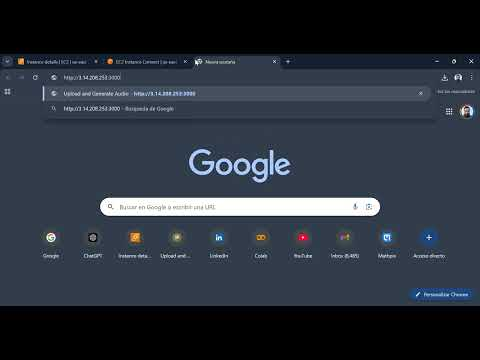

In [2]:
from IPython.display import YouTubeVideo

# Reemplaza con el ID del video de YouTube
video_id = "8CaVx_S8K0I"
YouTubeVideo(video_id, width=800, height=450)

## **Conclusions**

* Althrough the project, one of the most important issues is the quality of information: as we inspected the images at each step, it seems like there is no clear difference betweeen the features of a class 0 image and a class 1 picture.
* Iteration 1 and 2 of Single Neural Network, as well as EfficientNet present very similar and promising results.
* There are several tools that can be used for OCR purposes. State-of-the-art options include *PaddleOCR*, *TrOCR*, *DLoRA-TrOCR*, *PP-OCR*, among others. Some other options include Pytesseract, Tesseract, Keras-OCR, Textract, OCRopus, and EasyOCR.
* In this project, two vocoders were explored:*Google Text to Speech* and *microsoft/speecht5_hifigan .*

## **Recommendations**

* As a first action, labels must be revisited and corrected, in order to improve the results of the analysis. Better incentives for the analyst and quality assurance processes must be performed during the relabeling process.
* Further iterations can be applied on Single Neural Network to check for key features in architecture involved in its success.
* It is recommended to try other options besides SpaCy for syntax analysis and Grammar Correction, like *Re*, *TextBlob*,  *UnideCode* and *BeautifulSoup*, as well as *Hugging Face* *Transformers.*
* Further configurations must be set up for get better results when using vocoder *microsoft/speecht5_hifigan*, to ensure high quality results without any trace of white noise.
